# Chapter 16 - Gradient Boosting with XGBoost, LigthGBM, and CatBoost

## Listing 16-1. Importing the data

In [1]:
import pandas as pd
data = pd.read_csv('Metro_Interstate_Traffic_Volume.csv')


## Listing 16-2. Applying the same feature engineering as done previously for the kNN model

In [2]:
data['year'] = data['date_time'].apply(lambda x: int(x[:4]))
data['month'] = data['date_time'].apply(lambda x: int(x[5:7]))
data['weekday'] = pd.to_datetime(data['date_time']).apply(lambda x: x.weekday())
data['hour'] = pd.to_datetime(data['date_time']).apply(lambda x: x.hour)
data['isholiday'] = (data['holiday'] == 'None').apply(float)


## Listing 16-3. Applying the default XGBoost model

In [3]:
import mlflow
mlflow.autolog()

# Create objects X and y
X = data[['year', 'month', 'weekday', 'hour', 'isholiday']]
y = data['traffic_volume']

# Create Train test split
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=100, random_state=12345, shuffle=False)

from xgboost import XGBRegressor
my_xgb = XGBRegressor()
my_xgb.fit(X_train, y_train)

xgb_fcst = my_xgb.predict(X_test)

from sklearn.metrics import r2_score
print(r2_score(list(y_test), list(xgb_fcst)))


2025/06/06 12:20:02 WARNING mlflow.utils.autologging_utils: MLflow sklearn autologging is known to be compatible with 0.24.1 <= scikit-learn <= 1.5.2, but the installed version is 1.6.1. If you encounter errors during autologging, try upgrading / downgrading scikit-learn to a compatible version, or try upgrading MLflow.
2025/06/06 12:20:09 INFO mlflow.tracking.fluent: Autologging successfully enabled for sklearn.
2025/06/06 12:20:09 WARNING mlflow.utils.autologging_utils: MLflow xgboost autologging is known to be compatible with 1.4.2 <= xgboost <= 2.1.2, but the installed version is 2.1.4. If you encounter errors during autologging, try upgrading / downgrading xgboost to a compatible version, or try upgrading MLflow.
2025/06/06 12:20:09 INFO mlflow.tracking.fluent: Autologging successfully enabled for xgboost.
2025/06/06 12:20:09 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '8ae43dd7fc554b3393ddaa1ae384ac78', which will track hyperparameters, performance

0.9726292617325978


## Listing 16-4. Applying the default LightGBM model

In [4]:
from lightgbm import LGBMRegressor
my_lgbm = LGBMRegressor()
my_lgbm.fit(X_train, y_train)

lgbm_fcst = my_lgbm.predict(X_test)

print(r2_score(list(y_test), list(lgbm_fcst)))


2025/06/06 12:20:12 WARNING mlflow.utils.autologging_utils: MLflow lightgbm autologging is known to be compatible with 3.1.1 <= lightgbm <= 4.5.0, but the installed version is 4.6.0. If you encounter errors during autologging, try upgrading / downgrading lightgbm to a compatible version, or try upgrading MLflow.
2025/06/06 12:20:12 INFO mlflow.tracking.fluent: Autologging successfully enabled for lightgbm.
2025/06/06 12:20:12 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '4b902fbb628d4ed487f954e2c7da3384', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current lightgbm workflow
2025/06/06 12:20:12 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input 

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000407 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:20:13 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:20:14 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

0.9728060730071293


## Listing 16-5. Applying the default catboost model

In [5]:
from catboost import CatBoostRegressor

my_catboost = CatBoostRegressor()
my_catboost.fit(X_train, y_train)

catboost_fcst = my_catboost.predict(X_test)
print(r2_score(list(y_test), list(catboost_fcst)))


Learning rate set to 0.075503
0:	learn: 1856.7448926	total: 64.8ms	remaining: 1m 4s
1:	learn: 1736.3885312	total: 70.1ms	remaining: 35s
2:	learn: 1629.6973114	total: 74.8ms	remaining: 24.9s
3:	learn: 1528.9465926	total: 79.2ms	remaining: 19.7s
4:	learn: 1441.0144067	total: 83.3ms	remaining: 16.6s
5:	learn: 1359.0206431	total: 86.8ms	remaining: 14.4s
6:	learn: 1283.6875058	total: 90.2ms	remaining: 12.8s
7:	learn: 1215.2581248	total: 93.1ms	remaining: 11.5s
8:	learn: 1152.8799272	total: 96.2ms	remaining: 10.6s
9:	learn: 1095.2727498	total: 99.2ms	remaining: 9.82s
10:	learn: 1042.5493129	total: 102ms	remaining: 9.17s
11:	learn: 996.9590377	total: 105ms	remaining: 8.62s
12:	learn: 951.6962671	total: 107ms	remaining: 8.15s
13:	learn: 910.5662669	total: 110ms	remaining: 7.74s
14:	learn: 876.8092063	total: 112ms	remaining: 7.36s
15:	learn: 844.0728775	total: 114ms	remaining: 7.02s
16:	learn: 815.0414132	total: 116ms	remaining: 6.72s
17:	learn: 789.4828705	total: 118ms	remaining: 6.46s
18:	lea

## Listing 16-6. Create a graph to compare the XGBoost and LightGBM forecast to the actuals

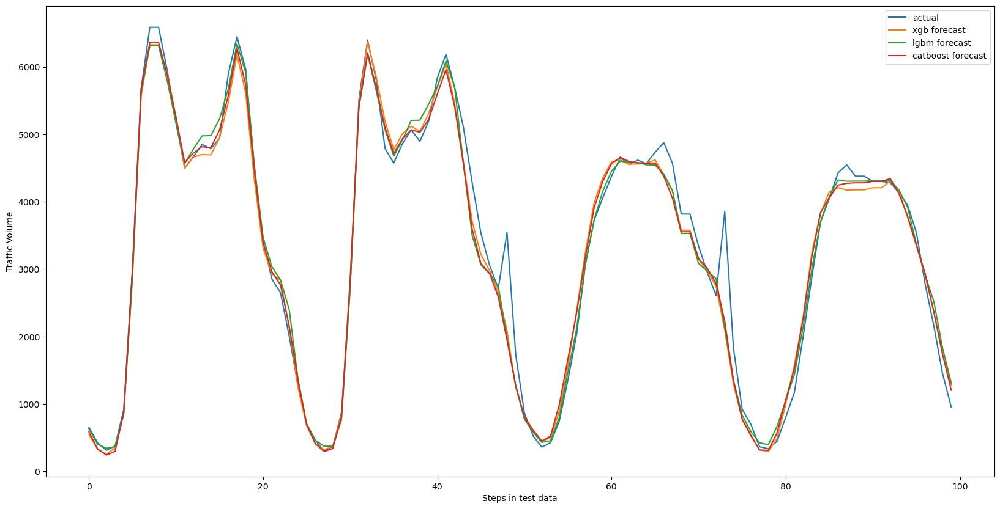

In [6]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))
plt.plot(list(y_test))
plt.plot(list(xgb_fcst))
plt.plot(list(lgbm_fcst))
plt.plot(list(catboost_fcst))
plt.legend(['actual', 'xgb forecast', 'lgbm forecast', 'catboost forecast'])
plt.ylabel('Traffic Volume')
plt.xlabel('Steps in test data')
plt.show()


## Listing 16-7. Applying a Bayesian Optimization to the xgboost

In [7]:
from bayes_opt import BayesianOptimization

# Create cost function to optimize
def xgb_opt_func(learning_rate, max_depth, n_estimators):
    
    my_xgb = XGBRegressor(
        learning_rate=learning_rate, 
        max_depth=int(max_depth),
        n_estimators=int(n_estimators)
    )
    
    my_xgb.fit(X_train, y_train)
    
    xgb_fcst = my_xgb.predict(X_test)
    
    return r2_score(list(y_test), list(xgb_fcst))

# Set up the Bayesian Optimization
xgb_opt = BayesianOptimization(
    xgb_opt_func, 
    {
        'learning_rate': (10e-6, 1.0),
        'max_depth': (0, 50),
        'n_estimators' : (10, 1000),
    }, 
    random_state=123
)

# Run the optimization
xgb_opt.maximize(init_points=20, n_iter=100)


# Create the model with best params from the optimization
tuned_xgb = XGBRegressor(
    learning_rate=xgb_opt.max['params']['learning_rate'], 
    max_depth=int(xgb_opt.max['params']['max_depth']),
    n_estimators=int(xgb_opt.max['params']['n_estimators'])
)

# Fit the optimal model and obtain R2 score
tuned_xgb.fit(X_train, y_train)
xgb_tuned_fcst = tuned_xgb.predict(X_test)

r2_score(list(y_test), list(xgb_tuned_fcst))

|   iter    |  target   | learni... | max_depth | n_esti... |
-------------------------------------------------------------


2025/06/06 12:20:17 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '4fa12d837e0748bab439bdb2bd935a22', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current xgboost workflow
2025/06/06 12:20:17 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With M

| 1         | 0.969     | 0.6965    | 14.31     | 234.6     |


2025/06/06 12:20:19 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:20:19 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 2         | 0.969     | 0.5513    | 35.97     | 428.9     |


2025/06/06 12:20:21 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:20:21 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 3         | 0.969     | 0.9808    | 34.24     | 486.1     |


2025/06/06 12:20:24 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:20:24 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 4         | 0.969     | 0.3921    | 17.16     | 731.8     |


2025/06/06 12:20:25 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:20:25 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 5         | 0.9604    | 0.4386    | 2.984     | 404.1     |


2025/06/06 12:20:27 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:20:27 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 6         | 0.969     | 0.738     | 9.125     | 183.7     |


2025/06/06 12:20:29 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:20:29 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 7         | 0.969     | 0.5316    | 26.59     | 638.1     |


2025/06/06 12:20:31 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:20:31 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 8         | 0.969     | 0.8494    | 36.22     | 614.9     |


2025/06/06 12:20:33 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:20:33 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 9         | 0.969     | 0.7224    | 16.15     | 368.2     |


2025/06/06 12:20:36 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:20:36 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 10        | 0.969     | 0.2283    | 14.69     | 634.7     |


2025/06/06 12:20:44 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:20:44 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 11        | 0.969     | 0.09211   | 21.69     | 436.6     |


2025/06/06 12:20:46 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:20:46 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 12        | 0.969     | 0.4937    | 21.29     | 319.1     |


2025/06/06 12:20:50 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:20:50 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 13        | 0.969     | 0.4264    | 44.67     | 944.7     |


2025/06/06 12:20:52 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:20:52 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 14        | 0.969     | 0.5018    | 31.2      | 124.5     |


2025/06/06 12:20:56 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:20:56 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 15        | 0.969     | 0.3173    | 20.74     | 867.6     |


2025/06/06 12:21:03 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:21:03 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 16        | 0.969     | 0.2505    | 24.15     | 985.7     |


2025/06/06 12:21:05 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:21:05 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 17        | 0.969     | 0.5195    | 30.64     | 129.4     |


2025/06/06 12:21:07 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:21:07 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 18        | 0.969     | 0.8263    | 30.15     | 549.6     |


2025/06/06 12:21:09 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:21:09 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 19        | 0.969     | 0.3428    | 15.21     | 422.9     |


2025/06/06 12:21:11 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:21:11 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 20        | 0.969     | 0.6813    | 43.77     | 515.3     |


2025/06/06 12:21:13 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:13 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:13 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:13 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:13 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:13 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21

| 21        | 0.969     | 0.1123    | 24.45     | 344.2     |


2025/06/06 12:21:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21

| 22        | 0.9696    | 0.9113    | 6.388     | 209.0     |


2025/06/06 12:21:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21

| 23        | 0.969     | 0.5882    | 26.0      | 204.6     |


2025/06/06 12:21:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21

| 24        | 0.969     | 0.3504    | 16.85     | 523.4     |


2025/06/06 12:21:32 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:32 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:32 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:32 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:32 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:32 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21

| 25        | 0.9695    | 0.6077    | 7.272     | 207.3     |


2025/06/06 12:21:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:35 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:35 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:35 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:35 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:35 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21

| 26        | 0.969     | 0.8205    | 14.8      | 954.7     |


2025/06/06 12:21:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21

| 27        | 0.969     | 0.07841   | 35.16     | 167.9     |


2025/06/06 12:21:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21

| 28        | 0.9697    | 0.8448    | 6.451     | 152.7     |


2025/06/06 12:21:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21

| 29        | 0.969     | 0.9162    | 0.5508    | 132.5     |


2025/06/06 12:21:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21

| 30        | 0.969     | 0.4553    | 48.44     | 363.1     |


2025/06/06 12:21:53 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:53 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:53 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:53 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:53 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:53 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21

| 31        | 0.969     | 0.5927    | 49.76     | 328.4     |


2025/06/06 12:21:57 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:57 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:57 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:57 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:57 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21:57 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:21

| 32        | 0.969     | 0.9656    | 21.89     | 923.1     |


2025/06/06 12:22:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22

| 33        | 0.969     | 0.8381    | 39.67     | 896.5     |


2025/06/06 12:22:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22

| 34        | 0.9695    | 0.1668    | 7.489     | 895.3     |


2025/06/06 12:22:08 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:08 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:08 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:08 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:08 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:08 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22

| 35        | 0.969     | 0.8729    | 0.4188    | 915.4     |


2025/06/06 12:22:12 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:12 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:12 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:12 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:12 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:12 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22

| 36        | 0.969     | 0.4257    | 0.06799   | 877.3     |


2025/06/06 12:22:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22

| 37        | 0.9682    | 0.6744    | 2.51      | 494.1     |


2025/06/06 12:22:19 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:19 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:19 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:19 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:19 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:19 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22

| 38        | 0.969     | 0.2856    | 28.01     | 583.3     |


2025/06/06 12:22:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22

| 39        | 0.97      | 0.2709    | 6.632     | 605.3     |


2025/06/06 12:22:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22

| 40        | 0.969     | 0.8948    | 2.619     | 587.5     |


2025/06/06 12:22:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22

| 41        | 0.969     | 0.3108    | 0.5545    | 620.2     |


2025/06/06 12:22:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22

| 42        | 0.969     | 0.2039    | 20.44     | 604.3     |


2025/06/06 12:22:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22

| 43        | 0.969     | 0.3655    | 43.73     | 293.1     |


2025/06/06 12:22:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22

| 44        | 0.969     | 0.9637    | 10.67     | 285.4     |


2025/06/06 12:22:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22

| 45        | 0.969     | 0.4468    | 0.1382    | 224.8     |


2025/06/06 12:22:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22

| 46        | 0.969     | 0.4979    | 47.41     | 230.6     |


2025/06/06 12:22:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:22

| 47        | 0.969     | 0.6136    | 35.84     | 261.3     |


2025/06/06 12:23:02 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:02 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:02 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:02 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:02 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:02 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23

| 48        | 0.969     | 0.8488    | 19.39     | 697.8     |


2025/06/06 12:23:05 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:05 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:05 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:05 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:05 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:05 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23

| 49        | 0.969     | 0.3815    | 48.42     | 715.9     |


2025/06/06 12:23:10 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:10 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:10 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:10 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:10 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:10 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23

| 50        | 0.969     | 0.8832    | 0.3345    | 166.2     |


2025/06/06 12:23:13 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:13 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:13 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:13 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:13 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:13 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23

| 51        | 0.969     | 0.2071    | 48.33     | 679.8     |


2025/06/06 12:23:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23

| 52        | 0.969     | 0.2528    | 22.57     | 152.5     |


2025/06/06 12:23:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23

| 53        | 0.969     | 0.8364    | 10.91     | 667.6     |


2025/06/06 12:23:30 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:30 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:30 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:30 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:30 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:30 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23

| 54        | 0.969     | 0.6688    | 45.88     | 750.5     |


2025/06/06 12:23:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23

| 55        | 0.969     | 0.3243    | 13.42     | 765.9     |


2025/06/06 12:23:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23

| 56        | 0.969     | 0.7232    | 43.07     | 784.0     |


2025/06/06 12:23:42 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:42 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:42 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:42 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:42 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:42 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23

| 57        | 0.969     | 0.3603    | 12.18     | 799.0     |


2025/06/06 12:23:46 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:46 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:46 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:46 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:46 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:46 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23

| 58        | 0.969     | 0.7533    | 39.32     | 819.0     |


2025/06/06 12:23:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23

| 59        | 0.9694    | 0.5443    | 6.391     | 831.8     |


2025/06/06 12:23:54 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:54 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:54 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:54 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:54 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:54 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23

| 60        | 0.969     | 0.6155    | 24.83     | 840.9     |


2025/06/06 12:23:58 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:58 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:58 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:58 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:58 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23:58 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:23

| 61        | 0.969     | 0.7813    | 0.1385    | 849.6     |


2025/06/06 12:24:01 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:02 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:02 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:02 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:02 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:02 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24

| 62        | 0.969     | 0.2048    | 49.88     | 91.52     |


2025/06/06 12:24:06 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:06 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:06 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:06 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:06 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:06 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24

| 63        | 0.969     | 0.7962    | 16.56     | 85.45     |


2025/06/06 12:24:09 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:09 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:09 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:09 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:09 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:09 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24

| 64        | 0.9683    | 0.05485   | 38.94     | 60.48     |


2025/06/06 12:24:12 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:12 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:12 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:12 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:12 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:12 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24

| 65        | 0.969     | 0.05458   | 0.2592    | 548.1     |


2025/06/06 12:24:23 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:23 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:23 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:23 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:23 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:23 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24

| 66        | 0.969     | 0.01096   | 0.07287   | 815.3     |


2025/06/06 12:24:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24

| 67        | 0.969     | 0.04482   | 49.86     | 971.9     |


2025/06/06 12:24:57 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:57 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:57 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:57 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:57 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24:57 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:24

| 68        | 0.9689    | 0.2801    | 0.2493    | 12.68     |


2025/06/06 12:25:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25

| 69        | 0.969     | 0.5535    | 49.69     | 866.4     |


2025/06/06 12:25:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25

| 70        | 0.9654    | 0.2367    | 38.92     | 10.78     |


2025/06/06 12:25:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25

| 71        | 0.969     | 0.2671    | 49.33     | 999.0     |


2025/06/06 12:25:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25

| 72        | 0.969     | 0.4594    | 49.7      | 460.7     |


2025/06/06 12:25:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25

| 73        | 0.969     | 0.4306    | 49.96     | 195.1     |


2025/06/06 12:25:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25

| 74        | 0.969     | 0.6003    | 49.87     | 569.6     |


2025/06/06 12:25:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25

| 75        | 0.969     | 0.2645    | 0.2721    | 338.4     |


2025/06/06 12:25:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25

| 76        | 0.969     | 0.9465    | 49.96     | 651.0     |


2025/06/06 12:25:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25

| 77        | 0.969     | 0.9752    | 0.1763    | 997.5     |


2025/06/06 12:25:41 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:41 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:41 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:41 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:41 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:41 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25

| 78        | 0.969     | 0.5764    | 0.9271    | 261.6     |


2025/06/06 12:25:45 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:45 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:45 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:45 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:45 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:45 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25

| 79        | 0.969     | 0.8123    | 0.545     | 62.99     |


2025/06/06 12:25:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:25

| 80        | 0.969     | 0.163     | 49.93     | 920.3     |


2025/06/06 12:26:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26

| 81        | 0.969     | 0.3092    | 0.2456    | 105.0     |


2025/06/06 12:26:05 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:05 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:05 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:05 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:05 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:05 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26

| 82        | 0.969     | 0.1071    | 21.32     | 889.5     |


2025/06/06 12:26:19 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:19 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:19 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:19 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:19 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:19 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26

| 83        | 0.7875    | 0.2805    | 1.063     | 454.3     |


2025/06/06 12:26:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26

| 84        | 0.969     | 0.6147    | 49.49     | 395.4     |


2025/06/06 12:26:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26

| 85        | 0.969     | 1.0       | 17.54     | 37.4      |


2025/06/06 12:26:30 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:30 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:30 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:30 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:30 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:30 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26

| 86        | 0.0127    | 1e-05     | 0.0       | 712.3     |


2025/06/06 12:26:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26

| 87        | 0.969     | 0.8671    | 32.51     | 691.6     |


2025/06/06 12:26:41 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:41 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:41 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:41 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:41 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:41 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26

| 88        | 0.01333   | 1e-05     | 25.23     | 745.9     |


2025/06/06 12:26:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26

| 89        | 0.969     | 0.2354    | 16.94     | 168.4     |


2025/06/06 12:26:57 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:57 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:57 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:57 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:57 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26:57 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:26

| 90        | 0.969     | 0.8562    | 20.48     | 620.4     |


2025/06/06 12:27:02 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27:02 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27:02 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27:02 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27:02 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27:02 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27

| 91        | 0.9671    | 0.003297  | 21.05     | 906.6     |


2025/06/06 12:27:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27

| 92        | 0.969     | 0.04027   | 18.76     | 817.3     |


2025/06/06 12:27:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27

| 93        | 0.969     | 0.8611    | 27.88     | 185.0     |


2025/06/06 12:27:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27

| 94        | 0.9691    | 0.7681    | 7.974     | 781.0     |


2025/06/06 12:27:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27

| 95        | 0.969     | 0.4035    | 36.56     | 878.8     |


2025/06/06 12:27:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:27

| 96        | 0.969     | 0.186     | 30.75     | 802.7     |


2025/06/06 12:28:03 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:03 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:03 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:03 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:03 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:03 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28

| 97        | 0.969     | 0.2321    | 25.98     | 783.8     |


2025/06/06 12:28:13 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:13 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:13 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:13 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:13 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:13 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28

| 98        | 0.969     | 0.2252    | 34.89     | 855.8     |


2025/06/06 12:28:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28

| 99        | 0.969     | 0.4987    | 31.82     | 964.9     |


2025/06/06 12:28:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28

| 100       | 0.003295  | 1e-05     | 29.28     | 223.2     |


2025/06/06 12:28:36 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:36 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:36 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:36 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:36 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:36 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28

| 101       | 0.7861    | 0.4593    | 1.732     | 242.6     |


2025/06/06 12:28:41 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:41 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:41 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:41 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:41 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:41 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28

| 102       | 0.969     | 1.0       | 17.71     | 194.9     |


2025/06/06 12:28:45 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:45 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:45 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:45 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:45 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:45 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28

| 103       | 0.969     | 1.0       | 35.72     | 913.2     |


2025/06/06 12:28:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:28

| 104       | 0.969     | 0.0421    | 37.51     | 930.6     |


2025/06/06 12:29:08 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:08 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:08 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:08 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:08 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:08 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29

| 105       | 0.969     | 0.2624    | 28.88     | 947.8     |


2025/06/06 12:29:19 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:19 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:19 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:19 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:19 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:19 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29

| 106       | 0.969     | 0.8781    | 40.25     | 985.0     |


2025/06/06 12:29:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29

| 107       | 0.969     | 0.9343    | 19.88     | 681.5     |


2025/06/06 12:29:30 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:30 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:30 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:30 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:30 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:30 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29

| 108       | 0.01543   | 1e-05     | 15.39     | 853.0     |


2025/06/06 12:29:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29

| 109       | 0.969     | 0.9045    | 27.86     | 830.3     |


2025/06/06 12:29:43 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:43 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:43 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:43 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:43 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:43 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29

| 110       | 0.969     | 0.4228    | 17.89     | 878.5     |


2025/06/06 12:29:49 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:49 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:49 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:49 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:49 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:49 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29

| 111       | 0.969     | 0.7396    | 36.77     | 840.4     |


2025/06/06 12:29:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:29

| 112       | 0.969     | 0.4178    | 15.17     | 591.8     |


2025/06/06 12:30:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30

| 113       | 0.969     | 0.3774    | 36.11     | 194.9     |


2025/06/06 12:30:06 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:06 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:06 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:06 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:06 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:06 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30

| 114       | 0.969     | 0.6155    | 42.22     | 181.7     |


2025/06/06 12:30:10 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:10 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:10 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:10 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:10 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:10 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30

| 115       | 0.969     | 0.9897    | 44.73     | 959.3     |


2025/06/06 12:30:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30

| 116       | 0.969     | 0.9737    | 48.15     | 850.6     |


2025/06/06 12:30:20 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30

| 117       | 0.969     | 0.325     | 14.33     | 140.0     |


2025/06/06 12:30:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30

| 118       | 0.969     | 0.4332    | 14.98     | 333.8     |


2025/06/06 12:30:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30

| 119       | 0.969     | 0.6304    | 31.27     | 330.6     |


2025/06/06 12:30:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:30

| 120       | 0.969     | 0.255     | 10.54     | 349.7     |


2025/06/06 12:30:44 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:30:44 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

0.9699997322206068

## Listing 16-8. Applying a Bayesian Optimization to the LightGBM

In [8]:
# Create cost function to optimize
def lgbm_opt_func(learning_rate, max_depth, n_estimators):
    
    my_lgbm = LGBMRegressor(
        learning_rate=learning_rate, 
        max_depth=int(max_depth),
        n_estimators=int(n_estimators)
    )
    
    my_lgbm.fit(X_train, y_train)
    
    lgbm_fcst = my_lgbm.predict(X_test)
    
    return r2_score(list(y_test), list(lgbm_fcst))

# Set up the Bayesian Optimization
lgbm_opt = BayesianOptimization(
    lgbm_opt_func, 
    {
        'learning_rate': (10e-6, 1.0),
        'max_depth': (0, 50),
        'n_estimators' : (10, 1000),
    }, 
    random_state=123
)

# Run the optimization
lgbm_opt.maximize(init_points=20, n_iter=100)


# Create the model with best params from the optimization
tuned_lgbm = LGBMRegressor(
    learning_rate=lgbm_opt.max['params']['learning_rate'], 
    max_depth=int(lgbm_opt.max['params']['max_depth']),
    n_estimators=int(lgbm_opt.max['params']['n_estimators'])
)

# Fit the optimal model and obtain R2 score
tuned_lgbm.fit(X_train, y_train)
lgbm_tuned_fcst = tuned_lgbm.predict(X_test)

r2_score(list(y_test), list(lgbm_tuned_fcst))


2025/06/06 12:30:45 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '653aeb7a287e4c78b260eaf85011a5b3', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current lightgbm workflow
2025/06/06 12:30:45 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With 

|   iter    |  target   | learni... | max_depth | n_esti... |
-------------------------------------------------------------
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000349 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:30:45 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:30:46 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 1         | 0.9703    | 0.6965    | 14.31     | 234.6     |
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000303 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:30:47 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:30:48 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 2         | 0.9688    | 0.5513    | 35.97     | 428.9     |
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000289 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:30:49 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:30:50 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 3         | 0.9689    | 0.9808    | 34.24     | 486.1     |
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000306 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:30:51 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:30:52 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 4         | 0.9694    | 0.3921    | 17.16     | 731.8     |
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000298 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightG

2025/06/06 12:30:53 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

2025/06/06 12:30:54 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:30:54 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '5a09e703add24649a537fed6bb285ae0', which w

| 5         | 0.9652    | 0.4386    | 2.984     | 404.1     |
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000319 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:30:54 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:30:55 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 6         | 0.9701    | 0.738     | 9.125     | 183.7     |
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000296 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:30:56 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:30:57 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 7         | 0.9684    | 0.5316    | 26.59     | 638.1     |
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000319 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:30:58 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:30:59 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 8         | 0.9689    | 0.8494    | 36.22     | 614.9     |
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000287 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:31:00 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:31:01 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 9         | 0.9685    | 0.7224    | 16.15     | 368.2     |


2025/06/06 12:32:50 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001457 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:32:53 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:32:55 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 10        | 0.97      | 0.2283    | 14.69     | 634.7     |
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000285 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:32:57 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:32:58 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 11        | 0.9731    | 0.09211   | 21.69     | 436.6     |
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000290 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:32:59 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:33:00 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 12        | 0.9689    | 0.4937    | 21.29     | 319.1     |
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000298 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:33:01 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:33:03 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 13        | 0.9688    | 0.4264    | 44.67     | 944.7     |


2025/06/06 12:33:03 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000284 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:33:03 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:33:04 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 14        | 0.9698    | 0.5018    | 31.2      | 124.5     |
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000350 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:33:05 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:33:07 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 15        | 0.9692    | 0.3173    | 20.74     | 867.6     |
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000309 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:33:08 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:33:09 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 16        | 0.9689    | 0.2505    | 24.15     | 985.7     |
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000301 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:33:09 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:33:11 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 17        | 0.9712    | 0.5195    | 30.64     | 129.4     |
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000312 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:33:11 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:33:12 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 18        | 0.9686    | 0.8263    | 30.15     | 549.6     |
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000321 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:33:13 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:33:14 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 19        | 0.9705    | 0.3428    | 15.21     | 422.9     |
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000294 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:33:15 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:33:16 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 20        | 0.9683    | 0.6813    | 43.77     | 515.3     |


2025/06/06 12:33:17 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:17 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:17 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:17 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:17 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:17 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.006787 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:33:19 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:33:20 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 21        | 0.9692    | 0.6339    | 19.55     | 433.4     |


2025/06/06 12:33:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000297 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:33:22 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:33:23 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 22        | 0.9694    | 0.7178    | 26.77     | 418.1     |


2025/06/06 12:33:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000305 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:33:25 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:33:26 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 23        | 0.9701    | 0.3644    | 10.52     | 363.1     |


2025/06/06 12:33:27 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:27 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:27 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:27 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:27 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:27 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000346 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:33:28 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:33:29 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 24        | 0.973     | 0.1269    | 29.9      | 356.2     |


2025/06/06 12:33:30 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:30 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:30 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:30 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:30 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:30 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000316 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:33:32 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:33:33 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 25        | 0.9702    | 0.2044    | 29.75     | 667.3     |


2025/06/06 12:33:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000307 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:33:35 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:33:36 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 26        | 0.9681    | 0.9855    | 23.72     | 165.3     |


2025/06/06 12:33:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000506 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:33:38 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:33:39 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 27        | 0.9687    | 0.9677    | 24.43     | 319.4     |


2025/06/06 12:33:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000308 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:33:41 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:33:42 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 28        | 0.9725    | 0.1198    | 21.99     | 437.8     |


2025/06/06 12:33:43 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:43 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:43 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:43 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:43 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:43 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000633 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:33:44 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:33:45 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 29        | 0.9698    | 0.3646    | 28.4      | 354.5     |


2025/06/06 12:33:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000345 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:33:47 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:33:49 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 30        | 0.9688    | 0.7431    | 20.12     | 437.2     |


2025/06/06 12:33:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000313 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:33:50 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:33:52 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 31        | 0.972     | 0.6299    | 30.67     | 128.3     |


2025/06/06 12:33:53 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:53 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:53 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:53 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:53 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:53 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000344 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:33:54 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:33:55 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 32        | 0.9675    | 0.8351    | 29.03     | 356.0     |


2025/06/06 12:33:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000314 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:33:57 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:33:58 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 33        | 0.9692    | 0.9919    | 24.13     | 418.5     |


2025/06/06 12:33:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:33

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000294 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:34:00 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:34:02 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 34        | 0.9687    | 0.7122    | 45.14     | 835.2     |


2025/06/06 12:34:03 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:03 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:03 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:03 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:03 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:03 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000310 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain:

2025/06/06 12:34:03 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

2025/06/06 12:34:04 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:34:04 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '35a0f7e878b94e8395875fbcd4e1e1d5', which w

| 35        | 0.974     | 0.6329    | 3.176     | 671.7     |


2025/06/06 12:34:06 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:06 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:06 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:06 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:06 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:06 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000303 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:34:07 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:34:08 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 36        | 0.9692    | 0.8354    | 41.48     | 804.3     |


2025/06/06 12:34:09 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:09 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:09 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:09 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:09 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:09 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000316 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:34:10 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:34:11 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 37        | 0.9688    | 0.7382    | 30.47     | 356.8     |


2025/06/06 12:34:12 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:12 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:12 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:12 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:12 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:12 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000314 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:34:13 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:34:14 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 38        | 0.9675    | 0.5669    | 7.457     | 594.6     |


2025/06/06 12:34:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000292 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:34:16 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:34:18 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 39        | 0.9689    | 0.4458    | 44.55     | 858.6     |


2025/06/06 12:34:19 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:19 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:19 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:19 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:19 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:19 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000315 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:34:20 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:34:21 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 40        | 0.9689    | 0.2366    | 24.94     | 957.8     |


2025/06/06 12:34:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000304 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:34:23 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:34:24 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 41        | 0.9705    | 0.3112    | 15.3      | 530.9     |


2025/06/06 12:34:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000324 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:34:26 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:34:27 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 42        | 0.9695    | 0.4713    | 41.02     | 401.0     |


2025/06/06 12:34:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000305 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:34:29 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:34:30 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 43        | 0.9715    | 0.01184   | 41.29     | 621.8     |


2025/06/06 12:34:32 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:32 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:32 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:32 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:32 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:32 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000346 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:34:33 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:34:34 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 44        | 0.9735    | 0.04984   | 44.43     | 996.0     |


2025/06/06 12:34:35 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:35 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:35 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:35 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:35 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:35 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000312 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain:

2025/06/06 12:34:36 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

2025/06/06 12:34:37 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:34:37 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '7215d793e3a1447190fe2c8c9a802fea', which w

| 45        | 0.9745    | 0.2773    | 4.511     | 471.5     |


2025/06/06 12:34:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000316 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:34:39 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:34:40 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 46        | 0.9687    | 0.5088    | 11.11     | 674.3     |


2025/06/06 12:34:41 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:41 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:41 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:41 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:41 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:41 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000286 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:34:42 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:34:43 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 47        | 0.969     | 0.7676    | 17.63     | 681.9     |


2025/06/06 12:34:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000307 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:34:45 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:34:46 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 48        | 0.9685    | 0.8866    | 25.86     | 245.2     |


2025/06/06 12:34:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000296 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:34:48 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:34:49 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 49        | 0.9693    | 0.9412    | 48.3      | 161.2     |


2025/06/06 12:34:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000311 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain:

2025/06/06 12:34:52 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:34:52 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'ee0cf6c312b64055a78f2d50a6f4c6ce', which w

| 50        | 0.8992    | 0.4196    | 2.026     | 33.18     |


2025/06/06 12:34:53 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:53 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:53 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:53 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:53 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:53 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000621 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:34:54 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:34:55 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 51        | 0.9679    | 0.01141   | 37.71     | 349.3     |


2025/06/06 12:34:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:34

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000365 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:34:57 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:34:59 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 52        | 0.00715   | 1e-05     | 29.54     | 436.1     |


2025/06/06 12:35:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.009101 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:35:02 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:35:03 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 53        | 0.9722    | 0.1321    | 39.27     | 422.2     |


2025/06/06 12:35:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000312 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:35:05 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:35:07 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 54        | 0.9694    | 0.7035    | 44.16     | 430.4     |


2025/06/06 12:35:08 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:08 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:08 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:08 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:08 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:08 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001080 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:35:09 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:35:10 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 55        | 0.9711    | 0.1111    | 31.96     | 626.5     |


2025/06/06 12:35:11 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:11 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:11 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:11 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:11 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:11 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000419 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:35:12 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:35:14 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 56        | 0.969     | 0.4367    | 21.02     | 626.9     |


2025/06/06 12:35:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001229 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain:

2025/06/06 12:35:16 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:35:17 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 57        | 0.9682    | 0.7987    | 5.713     | 682.5     |


2025/06/06 12:35:18 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:18 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:18 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:18 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:18 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:18 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000311 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:35:20 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:35:21 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 58        | 0.97      | 0.3558    | 26.83     | 618.1     |


2025/06/06 12:35:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005819 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:35:23 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:35:24 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 59        | 0.9688    | 0.7041    | 21.48     | 672.3     |


2025/06/06 12:35:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000756 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:35:27 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:35:28 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 60        | 0.9697    | 0.2892    | 30.28     | 678.1     |


2025/06/06 12:35:29 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:29 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:29 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:29 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:29 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:29 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000720 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:35:30 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:35:31 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 61        | 0.9693    | 0.6341    | 40.48     | 633.0     |


2025/06/06 12:35:32 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:32 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:32 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:32 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:32 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:32 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000300 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:35:34 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:35:36 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 62        | 0.9707    | 0.129     | 34.67     | 991.8     |


2025/06/06 12:35:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000354 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:35:38 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:35:39 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 63        | 0.969     | 0.8331    | 9.42      | 663.2     |


2025/06/06 12:35:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002772 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:35:42 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:35:44 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 64        | 0.969     | 0.4123    | 43.31     | 985.6     |


2025/06/06 12:35:45 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:45 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:45 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:45 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:45 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:45 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000378 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:35:46 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:35:47 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 65        | 0.9693    | 0.5637    | 34.52     | 981.0     |


2025/06/06 12:35:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001091 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:35:49 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:35:51 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 66        | 0.9691    | 0.7514    | 20.5      | 661.7     |


2025/06/06 12:35:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000309 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:35:54 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:35:55 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 67        | 0.9692    | 0.4037    | 18.62     | 645.0     |


2025/06/06 12:35:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:35

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000295 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:35:57 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:35:59 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 68        | 0.9698    | 0.3557    | 14.1      | 654.0     |


2025/06/06 12:36:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000307 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:36:01 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:36:02 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 69        | 0.9693    | 0.4859    | 26.71     | 652.8     |


2025/06/06 12:36:03 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:03 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:03 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:03 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000305 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:36:05 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:36:06 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 70        | 0.969     | 0.5334    | 8.219     | 644.6     |


2025/06/06 12:36:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000597 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain:

2025/06/06 12:36:08 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

2025/06/06 12:36:09 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:36:09 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'da9da1a3eec84dd2ba2b3d2efb0f1846', which w

| 71        | 0.9744    | 0.7275    | 3.475     | 654.5     |


2025/06/06 12:36:10 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:10 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:10 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:10 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:10 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:10 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001270 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:36:12 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:36:13 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 72        | 0.9693    | 0.3362    | 35.26     | 644.2     |


2025/06/06 12:36:14 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:14 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:14 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:14 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:14 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:14 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000299 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:36:15 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:36:16 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 73        | 0.97      | 0.2219    | 49.48     | 628.3     |


2025/06/06 12:36:18 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:18 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:18 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:18 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:18 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:18 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000332 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:36:19 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:36:20 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 74        | 0.9694    | 0.9653    | 36.71     | 655.2     |


2025/06/06 12:36:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000301 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:36:22 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:36:24 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 75        | 0.9688    | 0.9219    | 49.46     | 616.6     |


2025/06/06 12:36:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000789 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:36:26 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:36:27 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 76        | 0.9683    | 0.8402    | 36.01     | 411.0     |


2025/06/06 12:36:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000978 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:36:29 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:36:30 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 77        | 0.9564    | 0.01058   | 24.9      | 234.4     |


2025/06/06 12:36:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000869 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:36:32 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:36:33 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 78        | 0.969     | 0.7178    | 46.47     | 641.0     |


2025/06/06 12:36:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000413 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:36:36 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:36:37 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 79        | 0.969     | 0.8036    | 45.07     | 650.9     |


2025/06/06 12:36:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:38 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000308 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:36:39 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:36:41 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 80        | 0.9691    | 0.662     | 25.97     | 408.2     |


2025/06/06 12:36:42 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:42 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:42 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:42 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:42 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:42 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000320 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:36:43 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:36:44 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 81        | 0.9696    | 0.5621    | 15.76     | 412.6     |


2025/06/06 12:36:45 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:45 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:45 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:45 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:45 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:45 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001094 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:36:46 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:36:48 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 82        | 0.9702    | 0.2959    | 40.11     | 664.7     |


2025/06/06 12:36:49 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:49 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:49 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:49 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:49 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:49 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000306 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:36:50 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:36:51 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 83        | 0.9622    | 0.007281  | 31.02     | 398.8     |


2025/06/06 12:36:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001102 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:36:54 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:36:55 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 84        | 0.9719    | 0.1179    | 38.99     | 674.2     |


2025/06/06 12:36:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000292 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:36:57 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:36:58 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 85        | 0.9695    | 0.4524    | 6.728     | 416.1     |


2025/06/06 12:36:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:36

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000409 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:37:01 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:37:02 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 86        | 0.01136   | 1e-05     | 0.0       | 663.0     |


2025/06/06 12:37:03 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:03 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:03 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:03 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:03 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:03 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000953 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:37:04 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:37:06 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 87        | 0.97      | 0.2013    | 0.04768   | 646.5     |


2025/06/06 12:37:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000633 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:37:08 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:37:09 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 88        | 0.9683    | 0.9407    | 0.04087   | 677.9     |


2025/06/06 12:37:11 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:11 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:11 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:11 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:11 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:11 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000334 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:37:12 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:37:14 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 89        | 0.9689    | 0.6014    | 14.87     | 667.6     |


2025/06/06 12:37:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000318 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:37:16 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:37:17 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 90        | 0.9681    | 0.8288    | 15.77     | 245.2     |


2025/06/06 12:37:18 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:18 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:18 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:18 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:18 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:18 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001158 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:37:20 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:37:21 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 91        | 0.9683    | 0.7696    | 18.25     | 402.1     |


2025/06/06 12:37:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000294 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain:

2025/06/06 12:37:23 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:37:24 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 92        | 0.9713    | 0.2738    | 5.26      | 426.1     |


2025/06/06 12:37:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000300 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:37:27 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:37:28 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 93        | 0.9686    | 0.4521    | 48.34     | 660.6     |


2025/06/06 12:37:29 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:29 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:29 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:29 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:29 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:29 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000497 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:37:30 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:37:32 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 94        | 0.9732    | 0.01661   | 49.83     | 671.9     |


2025/06/06 12:37:33 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:33 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:33 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:33 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:33 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:33 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000307 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:37:34 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:37:35 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 95        | 0.9686    | 0.7587    | 38.54     | 683.8     |


2025/06/06 12:37:36 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:36 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:36 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:36 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:36 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:36 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000370 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:37:38 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:37:39 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 96        | 0.9688    | 0.3486    | 46.98     | 680.6     |


2025/06/06 12:37:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000314 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:37:42 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:37:43 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 97        | 0.9678    | 0.918     | 26.43     | 687.0     |


2025/06/06 12:37:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000622 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:37:45 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:37:46 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 98        | 0.9686    | 0.5962    | 46.33     | 409.8     |


2025/06/06 12:37:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000315 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:37:49 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:37:50 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 99        | 0.9708    | 0.3494    | 48.83     | 419.5     |


2025/06/06 12:37:51 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:51 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:51 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:51 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:51 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:51 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001046 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:37:52 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:37:54 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 100       | 0.9735    | 0.05318   | 24.83     | 995.3     |


2025/06/06 12:37:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000308 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain:

2025/06/06 12:37:56 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:37:57 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 101       | 0.9736    | 0.4906    | 3.799     | 635.8     |


2025/06/06 12:37:58 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:58 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:58 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:58 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:58 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37:58 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:37

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000329 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:37:59 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:38:01 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 102       | 0.9684    | 0.8453    | 10.33     | 625.0     |


2025/06/06 12:38:02 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:02 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:02 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:02 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:02 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:02 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000372 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:38:03 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:38:04 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 103       | 0.9689    | 0.4959    | 16.97     | 617.7     |


2025/06/06 12:38:05 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:05 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:05 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:05 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:05 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:05 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000593 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:38:07 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:38:08 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 104       | 0.9696    | 0.1579    | 15.97     | 991.4     |


2025/06/06 12:38:09 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:09 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:09 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:09 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:09 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:09 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000459 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain:

2025/06/06 12:38:10 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

2025/06/06 12:38:11 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:38:11 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'e32aef8f8e564414b1f00629510728df', which w

| 105       | 0.7867    | 0.2637    | 1.107     | 626.7     |


2025/06/06 12:38:13 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:13 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:13 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:13 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:13 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:13 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000310 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:38:14 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:38:15 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 106       | 0.9692    | 0.4287    | 43.2      | 607.9     |


2025/06/06 12:38:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000472 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:38:18 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:38:19 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 107       | 0.969     | 0.386     | 32.54     | 999.9     |


2025/06/06 12:38:20 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:20 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:20 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:20 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:20 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:20 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000312 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:38:21 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:38:23 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 108       | 0.9674    | 0.897     | 6.965     | 371.7     |


2025/06/06 12:38:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000403 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:38:25 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:38:26 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 109       | 0.9701    | 0.5266    | 6.649     | 239.8     |


2025/06/06 12:38:27 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:27 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:27 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:27 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:27 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:27 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000307 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:38:28 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:38:29 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 110       | 0.9702    | 0.2723    | 22.36     | 609.3     |


2025/06/06 12:38:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000312 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:38:32 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:38:33 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 111       | 0.9724    | 0.1386    | 31.8      | 606.1     |


2025/06/06 12:38:35 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:35 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:35 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:35 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:35 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:35 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000876 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:38:36 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:38:38 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 112       | 0.9692    | 0.718     | 38.98     | 598.8     |


2025/06/06 12:38:39 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:39 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:39 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:39 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:39 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:39 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000366 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:38:40 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:38:41 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 113       | 0.9692    | 0.4997    | 25.93     | 599.5     |


2025/06/06 12:38:42 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:42 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:42 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:42 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:42 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:42 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000479 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:38:43 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:38:45 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 114       | 0.9679    | 0.843     | 16.49     | 600.0     |


2025/06/06 12:38:46 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:46 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:46 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:46 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:46 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:46 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000353 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:38:48 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:38:49 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 115       | 0.9711    | 0.17      | 11.8      | 608.2     |


2025/06/06 12:38:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:50 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000335 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:38:51 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:38:53 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 116       | 0.9714    | 0.5174    | 6.68      | 230.0     |


2025/06/06 12:38:54 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:54 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:54 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:54 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:54 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:54 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000312 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:38:55 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:38:56 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 117       | 0.9693    | 0.9849    | 16.06     | 225.0     |


2025/06/06 12:38:57 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:57 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:57 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:57 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:57 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38:57 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:38

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000355 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain:

2025/06/06 12:38:58 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:39:00 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 118       | 0.969     | 0.5262    | 2.472     | 603.2     |


2025/06/06 12:39:01 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:39:01 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:39:01 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:39:01 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:39:01 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:39:01 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:39

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001058 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:39:02 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:39:03 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 119       | 0.9698    | 0.6625    | 7.327     | 220.7     |


2025/06/06 12:39:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:39:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:39:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:39:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:39:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:39:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:39

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000866 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685


2025/06/06 12:39:06 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."
2025/06/06 12:39:07 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib

| 120       | 0.9719    | 0.3618    | 14.97     | 214.9     |
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000288 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 52
[LightGBM] [Info] Number of data points in the train set: 48104, number of used features: 4
[LightGBM] [Info] Start training from score 3259.693685
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightG

2025/06/06 12:39:07 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


2025/06/06 12:39:08 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/opt/anaconda3/envs/chapter16-v3/lib/python3.12/site-packages/mlflow/types/utils.py:407: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details."


0.9744575398665747

## Listing 16-9. Applying a Bayesian Optimization to CatBoost

In [9]:
# Create cost function to optimize
def catboost_opt_func(learning_rate, max_depth, n_estimators):
    
    my_catboost = CatBoostRegressor(
        learning_rate=learning_rate, 
        max_depth=int(max_depth),
        n_estimators=int(n_estimators)
    )
    
    my_catboost.fit(X_train, y_train)
    
    catboost_fcst = my_catboost.predict(X_test)
    
    return r2_score(list(y_test), list(catboost_fcst))

# Set up the Bayesian Optimization
catboost_opt = BayesianOptimization(
    catboost_opt_func, 
    {
        'learning_rate': (10e-6, 1.0),
        'max_depth': (0, 16),
        'n_estimators' : (10, 1000),
    }, 
    random_state=123
)

# Run the optimization
catboost_opt.maximize(init_points=20, n_iter=100)


# Create the model with best params from the optimization
tuned_catboost = CatBoostRegressor(
    learning_rate=catboost_opt.max['params']['learning_rate'], 
    max_depth=int(catboost_opt.max['params']['max_depth']),
    n_estimators=int(catboost_opt.max['params']['n_estimators'])
)

# Fit the optimal model and obtain R2 score
tuned_catboost.fit(X_train, y_train)
catboost_tuned_fcst = tuned_catboost.predict(X_test)

r2_score(list(y_test), list(catboost_tuned_fcst))


|   iter    |  target   | learni... | max_depth | n_esti... |
-------------------------------------------------------------
0:	learn: 988.6030340	total: 2.99ms	remaining: 698ms
1:	learn: 742.5596006	total: 4.6ms	remaining: 534ms
2:	learn: 659.2608072	total: 6.38ms	remaining: 492ms
3:	learn: 631.3968856	total: 8.51ms	remaining: 490ms
4:	learn: 616.9332914	total: 10.4ms	remaining: 478ms
5:	learn: 583.4489167	total: 11.9ms	remaining: 453ms
6:	learn: 577.8475953	total: 13.5ms	remaining: 436ms
7:	learn: 569.1944484	total: 15.3ms	remaining: 433ms
8:	learn: 562.5211566	total: 17.4ms	remaining: 435ms
9:	learn: 559.8048351	total: 18.9ms	remaining: 424ms
10:	learn: 550.1370902	total: 20.7ms	remaining: 419ms
11:	learn: 540.7633936	total: 22.7ms	remaining: 419ms
12:	learn: 535.9769618	total: 24.5ms	remaining: 416ms
13:	learn: 529.2771051	total: 26.3ms	remaining: 414ms
14:	learn: 527.9120865	total: 28ms	remaining: 409ms
15:	learn: 525.2718866	total: 30ms	remaining: 408ms
16:	learn: 521.2410581	tota

2025/06/06 12:39:47 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '2cd0a0068f7d4626af68fe18cbfc33df', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 20        | 0.9691    | 0.6813    | 14.01     | 515.3     |


2025/06/06 12:39:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:39:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:39:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:39:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:39:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:39:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:39

0:	learn: 1791.9651199	total: 12.3ms	remaining: 4.22s
1:	learn: 1620.7156964	total: 23.3ms	remaining: 3.98s
2:	learn: 1472.1765440	total: 34.7ms	remaining: 3.95s
3:	learn: 1342.4520683	total: 52.9ms	remaining: 4.5s
4:	learn: 1232.0766674	total: 65.6ms	remaining: 4.45s
5:	learn: 1135.0683428	total: 75.2ms	remaining: 4.24s
6:	learn: 1046.5826021	total: 80.1ms	remaining: 3.86s
7:	learn: 975.1518361	total: 84.9ms	remaining: 3.56s
8:	learn: 911.1176169	total: 89.5ms	remaining: 3.33s
9:	learn: 853.7612657	total: 94.4ms	remaining: 3.15s
10:	learn: 806.0090065	total: 109ms	remaining: 3.31s
11:	learn: 764.7060062	total: 126ms	remaining: 3.49s
12:	learn: 728.9753389	total: 131ms	remaining: 3.33s
13:	learn: 701.1338951	total: 155ms	remaining: 3.66s
14:	learn: 677.0407942	total: 165ms	remaining: 3.62s
15:	learn: 656.3691397	total: 170ms	remaining: 3.49s
16:	learn: 639.0593543	total: 178ms	remaining: 3.43s
17:	learn: 622.0750474	total: 184ms	remaining: 3.32s
18:	learn: 608.6180205	total: 188ms	rema

2025/06/06 12:39:51 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '158ab7897daf49a1b7e283b0b70f9591', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


341:	learn: 439.6461543	total: 1s	remaining: 5.88ms
342:	learn: 439.6243606	total: 1.01s	remaining: 2.94ms
343:	learn: 439.5892367	total: 1.01s	remaining: 0us
| 21        | 0.9737    | 0.1123    | 7.824     | 344.2     |


2025/06/06 12:39:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:39:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:39:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:39:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:39:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:39:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:39

0:	learn: 1987.0546134	total: 4.86ms	remaining: 4.68s
1:	learn: 1987.0546134	total: 8.08ms	remaining: 3.88s
2:	learn: 1987.0546134	total: 11.2ms	remaining: 3.58s
3:	learn: 1987.0546134	total: 13ms	remaining: 3.12s
4:	learn: 1987.0546134	total: 16.3ms	remaining: 3.13s
5:	learn: 1987.0546134	total: 19.4ms	remaining: 3.09s
6:	learn: 1987.0546134	total: 25.7ms	remaining: 3.51s
7:	learn: 1987.0546134	total: 28.9ms	remaining: 3.45s
8:	learn: 1987.0546134	total: 32.1ms	remaining: 3.41s
9:	learn: 1987.0546134	total: 35.8ms	remaining: 3.41s
10:	learn: 1987.0546134	total: 38.9ms	remaining: 3.36s
11:	learn: 1987.0546134	total: 42.4ms	remaining: 3.36s
12:	learn: 1987.0546134	total: 45.8ms	remaining: 3.35s
13:	learn: 1987.0546134	total: 48.3ms	remaining: 3.28s
14:	learn: 1987.0546134	total: 50ms	remaining: 3.16s
15:	learn: 1987.0546134	total: 51.3ms	remaining: 3.03s
16:	learn: 1987.0546134	total: 53ms	remaining: 2.95s
17:	learn: 1987.0546134	total: 54.5ms	remaining: 2.86s
18:	learn: 1987.0546134	to

2025/06/06 12:39:53 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '21631f79779d411785da21991cd2c96e', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


714:	learn: 1987.0546134	total: 596ms	remaining: 207ms
715:	learn: 1987.0546134	total: 597ms	remaining: 206ms
716:	learn: 1987.0546134	total: 598ms	remaining: 205ms
717:	learn: 1987.0546134	total: 598ms	remaining: 204ms
718:	learn: 1987.0546134	total: 599ms	remaining: 203ms
719:	learn: 1987.0546134	total: 600ms	remaining: 202ms
720:	learn: 1987.0546134	total: 600ms	remaining: 201ms
721:	learn: 1987.0546134	total: 601ms	remaining: 201ms
722:	learn: 1987.0546134	total: 602ms	remaining: 200ms
723:	learn: 1987.0546134	total: 602ms	remaining: 199ms
724:	learn: 1987.0546134	total: 603ms	remaining: 198ms
725:	learn: 1987.0546134	total: 603ms	remaining: 197ms
726:	learn: 1987.0546134	total: 604ms	remaining: 196ms
727:	learn: 1987.0546134	total: 605ms	remaining: 195ms
728:	learn: 1987.0546134	total: 606ms	remaining: 194ms
729:	learn: 1987.0546134	total: 606ms	remaining: 193ms
730:	learn: 1987.0546134	total: 607ms	remaining: 193ms
731:	learn: 1987.0546134	total: 608ms	remaining: 192ms
732:	learn

2025/06/06 12:39:54 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:39:54 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:39:54 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:39:54 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:39:54 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:39:54 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:39

0:	learn: 1263.7892621	total: 14.1ms	remaining: 13.1s
1:	learn: 870.3466573	total: 25.2ms	remaining: 11.6s
2:	learn: 669.1273167	total: 36.4ms	remaining: 11.2s
3:	learn: 567.1201185	total: 116ms	remaining: 26.8s
4:	learn: 518.7872203	total: 189ms	remaining: 34.7s
5:	learn: 490.2894633	total: 265ms	remaining: 40.6s
6:	learn: 484.0547000	total: 268ms	remaining: 35.1s
7:	learn: 470.3720084	total: 317ms	remaining: 36.4s
8:	learn: 463.4701339	total: 362ms	remaining: 36.9s
9:	learn: 457.6555076	total: 406ms	remaining: 37.2s
10:	learn: 452.6332831	total: 452ms	remaining: 37.6s
11:	learn: 448.3228774	total: 497ms	remaining: 37.9s
12:	learn: 447.8370973	total: 500ms	remaining: 35.1s
13:	learn: 443.6711120	total: 543ms	remaining: 35.4s
14:	learn: 441.2320353	total: 586ms	remaining: 35.6s
15:	learn: 438.1087703	total: 629ms	remaining: 35.8s
16:	learn: 435.3186596	total: 672ms	remaining: 35.9s
17:	learn: 433.6291097	total: 715ms	remaining: 36.1s
18:	learn: 432.2559620	total: 759ms	remaining: 36.2s

2025/06/06 12:40:38 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '53c3f1a6370b48998344d3f62c5053ae', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 23        | 0.9692    | 0.4192    | 16.0      | 926.1     |


2025/06/06 12:40:39 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:40:39 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:40:39 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:40:39 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:40:39 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:40:39 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:40

0:	learn: 1512.8362834	total: 22.7ms	remaining: 22.6s
1:	learn: 1173.4172929	total: 50.9ms	remaining: 25.4s
2:	learn: 941.6168486	total: 75.5ms	remaining: 25.1s
3:	learn: 779.7645178	total: 87.5ms	remaining: 21.8s
4:	learn: 675.0038320	total: 98.7ms	remaining: 19.6s
5:	learn: 602.7778930	total: 109ms	remaining: 18s
6:	learn: 558.6343909	total: 120ms	remaining: 16.9s
7:	learn: 532.6460108	total: 125ms	remaining: 15.5s
8:	learn: 511.0086398	total: 136ms	remaining: 14.9s
9:	learn: 498.3772576	total: 147ms	remaining: 14.5s
10:	learn: 488.4886143	total: 157ms	remaining: 14.1s
11:	learn: 478.8003393	total: 168ms	remaining: 13.8s
12:	learn: 473.2191719	total: 178ms	remaining: 13.5s
13:	learn: 467.1072984	total: 189ms	remaining: 13.3s
14:	learn: 464.2645503	total: 199ms	remaining: 13.1s
15:	learn: 460.8510241	total: 209ms	remaining: 12.9s
16:	learn: 457.5271648	total: 220ms	remaining: 12.7s
17:	learn: 454.8450950	total: 232ms	remaining: 12.6s
18:	learn: 453.3158485	total: 242ms	remaining: 12.5

2025/06/06 12:40:52 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '3c0eb1ae99a14c4bb3eb351e3b73f7a8', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 24        | 0.9693    | 0.2706    | 14.75     | 999.5     |


2025/06/06 12:40:53 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:40:53 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:40:53 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:40:53 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:40:53 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:40:53 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:40

0:	learn: 1041.8959833	total: 21.2ms	remaining: 4.44s
1:	learn: 844.9212237	total: 35.7ms	remaining: 3.71s
2:	learn: 769.1889654	total: 39.5ms	remaining: 2.73s
3:	learn: 748.0635274	total: 41.3ms	remaining: 2.13s
4:	learn: 737.4474044	total: 42.9ms	remaining: 1.76s
5:	learn: 727.0654002	total: 44.6ms	remaining: 1.52s
6:	learn: 622.4336910	total: 46.2ms	remaining: 1.34s
7:	learn: 611.0084762	total: 47.7ms	remaining: 1.2s
8:	learn: 601.5924617	total: 49.2ms	remaining: 1.1s
9:	learn: 591.1165667	total: 50.6ms	remaining: 1.01s
10:	learn: 587.8559690	total: 52.1ms	remaining: 943ms
11:	learn: 583.1351813	total: 53.7ms	remaining: 885ms
12:	learn: 575.7611605	total: 55.3ms	remaining: 838ms
13:	learn: 569.1727297	total: 56.9ms	remaining: 797ms
14:	learn: 563.5748520	total: 58.4ms	remaining: 759ms
15:	learn: 549.0796545	total: 59.9ms	remaining: 727ms
16:	learn: 547.3217727	total: 61.4ms	remaining: 697ms
17:	learn: 544.8556128	total: 63.1ms	remaining: 673ms
18:	learn: 542.0600682	total: 64.5ms	re

2025/06/06 12:40:55 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '25ebf2e4e8054484a90051020c0795e1', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


114:	learn: 474.7759808	total: 215ms	remaining: 178ms
115:	learn: 474.5889487	total: 217ms	remaining: 176ms
116:	learn: 474.3510905	total: 219ms	remaining: 174ms
117:	learn: 474.2528782	total: 221ms	remaining: 172ms
118:	learn: 473.9649329	total: 222ms	remaining: 170ms
119:	learn: 473.7783437	total: 224ms	remaining: 168ms
120:	learn: 473.6155206	total: 225ms	remaining: 166ms
121:	learn: 473.4992743	total: 227ms	remaining: 164ms
122:	learn: 473.4311534	total: 229ms	remaining: 162ms
123:	learn: 473.2917384	total: 230ms	remaining: 160ms
124:	learn: 473.2212094	total: 232ms	remaining: 158ms
125:	learn: 473.1624998	total: 233ms	remaining: 156ms
126:	learn: 473.0719194	total: 235ms	remaining: 153ms
127:	learn: 472.9577404	total: 236ms	remaining: 151ms
128:	learn: 472.7542401	total: 238ms	remaining: 149ms
129:	learn: 472.6102649	total: 239ms	remaining: 147ms
130:	learn: 472.4985532	total: 241ms	remaining: 145ms
131:	learn: 472.3781666	total: 243ms	remaining: 143ms
132:	learn: 472.3030159	tota

2025/06/06 12:40:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:40:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:40:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:40:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:40:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:40:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:40

0:	learn: 1987.0546134	total: 31.4ms	remaining: 16.6s
1:	learn: 1987.0546134	total: 40.4ms	remaining: 10.7s
2:	learn: 1987.0546134	total: 57.8ms	remaining: 10.2s
3:	learn: 1987.0546134	total: 79.2ms	remaining: 10.4s
4:	learn: 1987.0546134	total: 119ms	remaining: 12.5s
5:	learn: 1987.0546134	total: 136ms	remaining: 11.9s
6:	learn: 1987.0546134	total: 139ms	remaining: 10.4s
7:	learn: 1987.0546134	total: 158ms	remaining: 10.3s
8:	learn: 1987.0546134	total: 159ms	remaining: 9.23s
9:	learn: 1987.0546134	total: 160ms	remaining: 8.32s
10:	learn: 1987.0546134	total: 161ms	remaining: 7.59s
11:	learn: 1987.0546134	total: 162ms	remaining: 6.98s
12:	learn: 1987.0546134	total: 162ms	remaining: 6.46s
13:	learn: 1987.0546134	total: 163ms	remaining: 6.02s
14:	learn: 1987.0546134	total: 164ms	remaining: 5.63s
15:	learn: 1987.0546134	total: 165ms	remaining: 5.29s
16:	learn: 1987.0546134	total: 166ms	remaining: 5s
17:	learn: 1987.0546134	total: 166ms	remaining: 4.73s
18:	learn: 1987.0546134	total: 167ms	

2025/06/06 12:40:58 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'd00fd2ea829b45a68fdea5d5436954ef', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


345:	learn: 1987.0546134	total: 380ms	remaining: 202ms
346:	learn: 1987.0546134	total: 381ms	remaining: 201ms
347:	learn: 1987.0546134	total: 381ms	remaining: 200ms
348:	learn: 1987.0546134	total: 382ms	remaining: 198ms
349:	learn: 1987.0546134	total: 383ms	remaining: 197ms
350:	learn: 1987.0546134	total: 384ms	remaining: 196ms
351:	learn: 1987.0546134	total: 384ms	remaining: 194ms
352:	learn: 1987.0546134	total: 385ms	remaining: 193ms
353:	learn: 1987.0546134	total: 386ms	remaining: 192ms
354:	learn: 1987.0546134	total: 387ms	remaining: 191ms
355:	learn: 1987.0546134	total: 387ms	remaining: 189ms
356:	learn: 1987.0546134	total: 388ms	remaining: 188ms
357:	learn: 1987.0546134	total: 389ms	remaining: 187ms
358:	learn: 1987.0546134	total: 390ms	remaining: 186ms
359:	learn: 1987.0546134	total: 390ms	remaining: 184ms
360:	learn: 1987.0546134	total: 391ms	remaining: 183ms
361:	learn: 1987.0546134	total: 392ms	remaining: 182ms
362:	learn: 1987.0546134	total: 393ms	remaining: 181ms
363:	learn

2025/06/06 12:40:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:40:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:40:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:40:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:40:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:40:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:40

0:	learn: 626.2964284	total: 50.8ms	remaining: 28.6s
1:	learn: 515.8456575	total: 197ms	remaining: 55.5s
2:	learn: 478.2878327	total: 262ms	remaining: 49.1s
3:	learn: 463.4013067	total: 324ms	remaining: 45.4s
4:	learn: 451.5611253	total: 385ms	remaining: 43.1s
5:	learn: 445.7098221	total: 454ms	remaining: 42.3s
6:	learn: 439.3060267	total: 518ms	remaining: 41.3s
7:	learn: 435.2098689	total: 580ms	remaining: 40.4s
8:	learn: 433.0772011	total: 641ms	remaining: 39.6s
9:	learn: 432.8101176	total: 643ms	remaining: 35.7s
10:	learn: 430.9183561	total: 702ms	remaining: 35.3s
11:	learn: 428.6455443	total: 763ms	remaining: 35.1s
12:	learn: 426.2341664	total: 822ms	remaining: 34.9s
13:	learn: 424.9442221	total: 880ms	remaining: 34.6s
14:	learn: 423.1013428	total: 939ms	remaining: 34.4s
15:	learn: 421.0079903	total: 994ms	remaining: 34.1s
16:	learn: 419.7590269	total: 1.04s	remaining: 33.6s
17:	learn: 418.7543570	total: 1.09s	remaining: 33s
18:	learn: 417.7824853	total: 1.13s	remaining: 32.5s
19:	

2025/06/06 12:41:27 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '2c23a2f872a242c0bf937261d76d9069', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 27        | 0.9691    | 1.0       | 16.0      | 565.1     |


2025/06/06 12:41:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:41:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:41:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:41:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:41:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:41:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:41

0:	learn: 1185.0843707	total: 23.9ms	remaining: 12s
1:	learn: 791.2005033	total: 35.4ms	remaining: 8.84s
2:	learn: 616.9804899	total: 46.2ms	remaining: 7.67s
3:	learn: 539.1857808	total: 91.5ms	remaining: 11.4s
4:	learn: 503.9299603	total: 133ms	remaining: 13.2s
5:	learn: 482.2639461	total: 161ms	remaining: 13.3s
6:	learn: 471.4252093	total: 191ms	remaining: 13.5s
7:	learn: 462.7944424	total: 235ms	remaining: 14.5s
8:	learn: 457.0918051	total: 254ms	remaining: 13.9s
9:	learn: 450.2967145	total: 271ms	remaining: 13.3s
10:	learn: 446.8522739	total: 288ms	remaining: 12.8s
11:	learn: 443.5078050	total: 306ms	remaining: 12.5s
12:	learn: 441.3519907	total: 323ms	remaining: 12.1s
13:	learn: 441.2742175	total: 325ms	remaining: 11.3s
14:	learn: 441.1821731	total: 328ms	remaining: 10.6s
15:	learn: 438.8082844	total: 345ms	remaining: 10.4s
16:	learn: 436.5301809	total: 362ms	remaining: 10.3s
17:	learn: 436.2838709	total: 365ms	remaining: 9.78s
18:	learn: 434.7024751	total: 382ms	remaining: 9.7s
1

2025/06/06 12:41:39 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '0608c151c3eb441a8644a482af0f5368', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 28        | 0.9692    | 0.468     | 15.41     | 501.2     |


2025/06/06 12:41:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:41:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:41:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:41:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:41:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:41:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:41

0:	learn: 1806.3557525	total: 40.2ms	remaining: 23.7s
1:	learn: 1645.4290633	total: 86.8ms	remaining: 25.6s
2:	learn: 1506.0831791	total: 92.5ms	remaining: 18.1s
3:	learn: 1383.7430484	total: 96.5ms	remaining: 14.2s
4:	learn: 1272.9287290	total: 101ms	remaining: 11.8s
5:	learn: 1172.6438479	total: 104ms	remaining: 10.2s
6:	learn: 1082.7399754	total: 108ms	remaining: 9.04s
7:	learn: 1006.5653379	total: 112ms	remaining: 8.16s
8:	learn: 939.2919208	total: 116ms	remaining: 7.5s
9:	learn: 879.6979155	total: 120ms	remaining: 6.97s
10:	learn: 827.2744630	total: 124ms	remaining: 6.52s
11:	learn: 782.0107128	total: 128ms	remaining: 6.16s
12:	learn: 742.6406328	total: 132ms	remaining: 5.85s
13:	learn: 708.0927162	total: 136ms	remaining: 5.58s
14:	learn: 678.7118080	total: 139ms	remaining: 5.36s
15:	learn: 654.0224919	total: 143ms	remaining: 5.15s
16:	learn: 632.0762656	total: 148ms	remaining: 4.99s
17:	learn: 614.2685262	total: 152ms	remaining: 4.83s
18:	learn: 597.5113605	total: 156ms	remaining

2025/06/06 12:41:45 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '79273d3be393432e856bef1807a1580c', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow
2025/06/06 12:41:46 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:41:46 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:41:46 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:41:46 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:41:46 WARNING mlflow.utils.autologging_utils: Encountered unexpected 

0:	learn: 1987.0546134	total: 1.89ms	remaining: 1.08s
1:	learn: 1987.0546134	total: 5.08ms	remaining: 1.45s
2:	learn: 1987.0546134	total: 9.09ms	remaining: 1.73s
3:	learn: 1987.0546134	total: 11.8ms	remaining: 1.69s
4:	learn: 1987.0546134	total: 13.9ms	remaining: 1.58s
5:	learn: 1987.0546134	total: 16.8ms	remaining: 1.59s
6:	learn: 1987.0546134	total: 19.9ms	remaining: 1.61s
7:	learn: 1987.0546134	total: 39ms	remaining: 2.76s
8:	learn: 1987.0546134	total: 42.5ms	remaining: 2.66s
9:	learn: 1987.0546134	total: 47.9ms	remaining: 2.7s
10:	learn: 1987.0546134	total: 53ms	remaining: 2.71s
11:	learn: 1987.0546134	total: 64.8ms	remaining: 3.03s
12:	learn: 1987.0546134	total: 68.4ms	remaining: 2.95s
13:	learn: 1987.0546134	total: 72.7ms	remaining: 2.9s
14:	learn: 1987.0546134	total: 74.8ms	remaining: 2.78s
15:	learn: 1987.0546134	total: 78.3ms	remaining: 2.73s
16:	learn: 1987.0546134	total: 81.5ms	remaining: 2.66s
17:	learn: 1987.0546134	total: 88.1ms	remaining: 2.72s
18:	learn: 1987.0546134	to

2025/06/06 12:41:47 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '5a8365c46503410e974fb21e4c5446d0', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


325:	learn: 1987.0546134	total: 404ms	remaining: 306ms
326:	learn: 1987.0546134	total: 405ms	remaining: 304ms
327:	learn: 1987.0546134	total: 405ms	remaining: 303ms
328:	learn: 1987.0546134	total: 406ms	remaining: 301ms
329:	learn: 1987.0546134	total: 407ms	remaining: 299ms
330:	learn: 1987.0546134	total: 407ms	remaining: 298ms
331:	learn: 1987.0546134	total: 408ms	remaining: 296ms
332:	learn: 1987.0546134	total: 409ms	remaining: 295ms
333:	learn: 1987.0546134	total: 409ms	remaining: 293ms
334:	learn: 1987.0546134	total: 410ms	remaining: 291ms
335:	learn: 1987.0546134	total: 411ms	remaining: 290ms
336:	learn: 1987.0546134	total: 411ms	remaining: 288ms
337:	learn: 1987.0546134	total: 412ms	remaining: 286ms
338:	learn: 1987.0546134	total: 413ms	remaining: 285ms
339:	learn: 1987.0546134	total: 414ms	remaining: 283ms
340:	learn: 1987.0546134	total: 414ms	remaining: 282ms
341:	learn: 1987.0546134	total: 415ms	remaining: 280ms
342:	learn: 1987.0546134	total: 416ms	remaining: 279ms
343:	learn

2025/06/06 12:41:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:41:49 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:41:49 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:41:49 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:41:49 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:41:49 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:41

0:	learn: 1987.0367726	total: 30.2ms	remaining: 6.68s
1:	learn: 1987.0190141	total: 86.9ms	remaining: 9.56s
2:	learn: 1987.0013284	total: 104ms	remaining: 7.58s
3:	learn: 1986.9836390	total: 117ms	remaining: 6.35s
4:	learn: 1986.9660080	total: 178ms	remaining: 7.72s
5:	learn: 1986.9480391	total: 205ms	remaining: 7.37s
6:	learn: 1986.9302578	total: 262ms	remaining: 8.06s
7:	learn: 1986.9124794	total: 323ms	remaining: 8.63s
8:	learn: 1986.8947587	total: 327ms	remaining: 7.74s
9:	learn: 1986.8767896	total: 384ms	remaining: 8.15s
10:	learn: 1986.8590576	total: 389ms	remaining: 7.47s
11:	learn: 1986.8415178	total: 448ms	remaining: 7.83s
12:	learn: 1986.8238303	total: 452ms	remaining: 7.27s
13:	learn: 1986.8059290	total: 466ms	remaining: 6.92s
14:	learn: 1986.7882668	total: 479ms	remaining: 6.61s
15:	learn: 1986.7708409	total: 484ms	remaining: 6.23s
16:	learn: 1986.7533687	total: 488ms	remaining: 5.88s
17:	learn: 1986.7360477	total: 491ms	remaining: 5.56s
18:	learn: 1986.7184816	total: 548ms

2025/06/06 12:41:55 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '8224de22effd41bba200bb02f947b791', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 31        | 0.002933  | 1e-05     | 16.0      | 222.1     |


2025/06/06 12:41:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:41:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:41:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:41:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:41:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:41:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:41

0:	learn: 1987.0546134	total: 1.77ms	remaining: 349ms
1:	learn: 1987.0546134	total: 3.41ms	remaining: 334ms
2:	learn: 1987.0546134	total: 5.29ms	remaining: 344ms
3:	learn: 1987.0546134	total: 6.76ms	remaining: 328ms
4:	learn: 1987.0546134	total: 8.18ms	remaining: 316ms
5:	learn: 1987.0546134	total: 9.67ms	remaining: 310ms
6:	learn: 1987.0546134	total: 11.1ms	remaining: 303ms
7:	learn: 1987.0546134	total: 12.4ms	remaining: 296ms
8:	learn: 1987.0546134	total: 13.6ms	remaining: 285ms
9:	learn: 1987.0546134	total: 14.3ms	remaining: 269ms
10:	learn: 1987.0546134	total: 15.1ms	remaining: 256ms
11:	learn: 1987.0546134	total: 15.8ms	remaining: 245ms
12:	learn: 1987.0546134	total: 16.5ms	remaining: 235ms
13:	learn: 1987.0546134	total: 17.2ms	remaining: 226ms
14:	learn: 1987.0546134	total: 17.9ms	remaining: 218ms
15:	learn: 1987.0546134	total: 18.6ms	remaining: 212ms
16:	learn: 1987.0546134	total: 19.5ms	remaining: 207ms
17:	learn: 1987.0546134	total: 20.2ms	remaining: 202ms
18:	learn: 1987.0546

2025/06/06 12:41:58 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '51bf3e2227234e13b6466f632d240ff3', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow
2025/06/06 12:41:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:41:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:41:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:41:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:41:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected 

0:	learn: 737.9609924	total: 90.5ms	remaining: 56.6s
1:	learn: 554.6915796	total: 108ms	remaining: 33.9s
2:	learn: 512.8948850	total: 121ms	remaining: 25.1s
3:	learn: 486.6518987	total: 144ms	remaining: 22.4s
4:	learn: 475.1029951	total: 155ms	remaining: 19.3s
5:	learn: 468.6881197	total: 168ms	remaining: 17.4s
6:	learn: 462.7720796	total: 182ms	remaining: 16.1s
7:	learn: 457.2542349	total: 197ms	remaining: 15.3s
8:	learn: 454.1985574	total: 210ms	remaining: 14.4s
9:	learn: 449.4624485	total: 216ms	remaining: 13.3s
10:	learn: 447.3477567	total: 221ms	remaining: 12.4s
11:	learn: 444.7498899	total: 226ms	remaining: 11.6s
12:	learn: 443.1906612	total: 232ms	remaining: 10.9s
13:	learn: 441.5870481	total: 237ms	remaining: 10.4s
14:	learn: 439.8330402	total: 243ms	remaining: 9.91s
15:	learn: 437.7840499	total: 249ms	remaining: 9.5s
16:	learn: 436.7633035	total: 254ms	remaining: 9.12s
17:	learn: 434.9314089	total: 260ms	remaining: 8.79s
18:	learn: 433.7401205	total: 265ms	remaining: 8.49s
19:

2025/06/06 12:42:05 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'ba83c73c3b0343a791c418679f300b51', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


607:	learn: 404.9689421	total: 3.53s	remaining: 110ms
608:	learn: 404.9689252	total: 3.53s	remaining: 104ms
609:	learn: 404.9688999	total: 3.54s	remaining: 98.6ms
610:	learn: 404.9688249	total: 3.54s	remaining: 92.8ms
611:	learn: 404.9687996	total: 3.55s	remaining: 87ms
612:	learn: 404.9687720	total: 3.56s	remaining: 81.2ms
613:	learn: 404.9687387	total: 3.56s	remaining: 75.4ms
614:	learn: 404.9650732	total: 3.57s	remaining: 69.6ms
615:	learn: 404.9625044	total: 3.57s	remaining: 63.8ms
616:	learn: 404.9624254	total: 3.58s	remaining: 58ms
617:	learn: 404.9624184	total: 3.58s	remaining: 52.2ms
618:	learn: 404.9610735	total: 3.59s	remaining: 46.4ms
619:	learn: 404.9610402	total: 3.59s	remaining: 40.6ms
620:	learn: 404.9610033	total: 3.6s	remaining: 34.8ms
621:	learn: 404.9609645	total: 3.6s	remaining: 29ms
622:	learn: 404.9607902	total: 3.61s	remaining: 23.2ms
623:	learn: 404.9607762	total: 3.62s	remaining: 17.4ms
624:	learn: 404.9607282	total: 3.62s	remaining: 11.6ms
625:	learn: 404.9602

2025/06/06 12:42:06 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:06 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:06 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:06 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:06 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:06 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42

0:	learn: 1542.9342446	total: 9.32ms	remaining: 3.31s
1:	learn: 1226.5818737	total: 31ms	remaining: 5.49s
2:	learn: 1009.8570294	total: 45.1ms	remaining: 5.3s
3:	learn: 856.7889509	total: 56.7ms	remaining: 4.99s
4:	learn: 756.2482491	total: 66.2ms	remaining: 4.65s
5:	learn: 681.5399464	total: 75.9ms	remaining: 4.42s
6:	learn: 631.7110065	total: 85.9ms	remaining: 4.28s
7:	learn: 601.0829921	total: 89.3ms	remaining: 3.88s
8:	learn: 581.0307593	total: 92.5ms	remaining: 3.57s
9:	learn: 562.7344949	total: 96ms	remaining: 3.32s
10:	learn: 551.4338577	total: 99ms	remaining: 3.11s
11:	learn: 542.5183043	total: 102ms	remaining: 2.93s
12:	learn: 536.2318912	total: 107ms	remaining: 2.82s
13:	learn: 530.0879051	total: 110ms	remaining: 2.69s
14:	learn: 523.3549435	total: 113ms	remaining: 2.57s
15:	learn: 518.3404960	total: 116ms	remaining: 2.47s
16:	learn: 513.4389980	total: 120ms	remaining: 2.39s
17:	learn: 510.4544620	total: 123ms	remaining: 2.31s
18:	learn: 507.4796386	total: 127ms	remaining: 2.

2025/06/06 12:42:08 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '47ee335181d9479ba3b23b6dada24719', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


286:	learn: 429.2896829	total: 809ms	remaining: 194ms
287:	learn: 429.2313339	total: 811ms	remaining: 192ms
288:	learn: 429.1781355	total: 814ms	remaining: 189ms
289:	learn: 429.1504573	total: 816ms	remaining: 186ms
290:	learn: 429.0998024	total: 818ms	remaining: 183ms
291:	learn: 429.0578491	total: 821ms	remaining: 180ms
292:	learn: 429.0376149	total: 823ms	remaining: 177ms
293:	learn: 428.9710503	total: 825ms	remaining: 174ms
294:	learn: 428.9257759	total: 827ms	remaining: 171ms
295:	learn: 428.8750760	total: 830ms	remaining: 168ms
296:	learn: 428.8229728	total: 832ms	remaining: 165ms
297:	learn: 428.7833224	total: 834ms	remaining: 162ms
298:	learn: 428.7470427	total: 837ms	remaining: 159ms
299:	learn: 428.7086904	total: 839ms	remaining: 157ms
300:	learn: 428.6659175	total: 841ms	remaining: 154ms
301:	learn: 428.6225301	total: 844ms	remaining: 151ms
302:	learn: 428.5745554	total: 846ms	remaining: 148ms
303:	learn: 428.5431127	total: 848ms	remaining: 145ms
304:	learn: 428.4739508	tota

2025/06/06 12:42:09 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:09 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:09 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:09 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:09 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:09 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42

0:	learn: 627.2717654	total: 13.3ms	remaining: 7.97s
1:	learn: 537.6830603	total: 24.6ms	remaining: 7.39s
2:	learn: 508.5135541	total: 36.2ms	remaining: 7.23s
3:	learn: 487.9668369	total: 47.4ms	remaining: 7.09s
4:	learn: 477.4299831	total: 57.9ms	remaining: 6.91s
5:	learn: 468.9646027	total: 69ms	remaining: 6.85s
6:	learn: 462.9237221	total: 80.5ms	remaining: 6.84s
7:	learn: 457.0225130	total: 91.3ms	remaining: 6.78s
8:	learn: 452.9171425	total: 101ms	remaining: 6.67s
9:	learn: 449.7994699	total: 110ms	remaining: 6.5s
10:	learn: 446.8282973	total: 119ms	remaining: 6.39s
11:	learn: 443.5709219	total: 126ms	remaining: 6.21s
12:	learn: 441.3435738	total: 134ms	remaining: 6.07s
13:	learn: 438.9309561	total: 141ms	remaining: 5.94s
14:	learn: 437.4077547	total: 149ms	remaining: 5.84s
15:	learn: 436.3172510	total: 157ms	remaining: 5.75s
16:	learn: 434.6793834	total: 165ms	remaining: 5.67s
17:	learn: 433.6520837	total: 173ms	remaining: 5.6s
18:	learn: 432.2791732	total: 180ms	remaining: 5.52s

2025/06/06 12:42:14 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'c044bf263c06449486604376cebde6d4', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 35        | 0.9691    | 0.9843    | 12.42     | 602.4     |


2025/06/06 12:42:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42

0:	learn: 1711.0590204	total: 3.2ms	remaining: 3.18s
1:	learn: 1510.6564818	total: 6.13ms	remaining: 3.05s
2:	learn: 1362.2440347	total: 9.22ms	remaining: 3.06s
3:	learn: 1247.7325939	total: 12.3ms	remaining: 3.05s
4:	learn: 1162.3489749	total: 15.8ms	remaining: 3.14s
5:	learn: 1099.4699227	total: 18.5ms	remaining: 3.06s
6:	learn: 1044.4904293	total: 22.7ms	remaining: 3.21s
7:	learn: 1008.1629589	total: 26.3ms	remaining: 3.25s
8:	learn: 976.3151242	total: 30ms	remaining: 3.29s
9:	learn: 952.9835920	total: 33.1ms	remaining: 3.26s
10:	learn: 931.9898533	total: 36.1ms	remaining: 3.23s
11:	learn: 914.7602378	total: 39.4ms	remaining: 3.23s
12:	learn: 888.0884985	total: 42.2ms	remaining: 3.2s
13:	learn: 873.9900534	total: 45.5ms	remaining: 3.19s
14:	learn: 860.7899413	total: 48.5ms	remaining: 3.17s
15:	learn: 844.4665896	total: 53ms	remaining: 3.25s
16:	learn: 836.2169118	total: 55.8ms	remaining: 3.22s
17:	learn: 820.1505674	total: 59ms	remaining: 3.21s
18:	learn: 808.4667761	total: 62.6ms	r

2025/06/06 12:42:17 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '2c4883312df64680a86b0da498b085b1', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


864:	learn: 506.7704528	total: 1.18s	remaining: 179ms
865:	learn: 506.7261878	total: 1.18s	remaining: 178ms
866:	learn: 506.6986225	total: 1.18s	remaining: 177ms
867:	learn: 506.6877906	total: 1.18s	remaining: 175ms
868:	learn: 506.6502503	total: 1.18s	remaining: 174ms
869:	learn: 506.6073866	total: 1.18s	remaining: 173ms
870:	learn: 506.5904774	total: 1.18s	remaining: 171ms
871:	learn: 506.5678938	total: 1.18s	remaining: 170ms
872:	learn: 506.5178530	total: 1.19s	remaining: 168ms
873:	learn: 506.5030122	total: 1.19s	remaining: 167ms
874:	learn: 506.4929925	total: 1.19s	remaining: 166ms
875:	learn: 506.4619668	total: 1.19s	remaining: 164ms
876:	learn: 506.4482327	total: 1.19s	remaining: 163ms
877:	learn: 506.4325496	total: 1.19s	remaining: 162ms
878:	learn: 506.4141732	total: 1.19s	remaining: 160ms
879:	learn: 506.3977494	total: 1.19s	remaining: 159ms
880:	learn: 506.3847138	total: 1.2s	remaining: 157ms
881:	learn: 506.3664442	total: 1.2s	remaining: 156ms
882:	learn: 506.3242670	total:

2025/06/06 12:42:18 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:18 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:18 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:18 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:18 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:18 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42

0:	learn: 1139.0788386	total: 8.08ms	remaining: 1.38s
1:	learn: 818.3825968	total: 28.7ms	remaining: 2.44s
2:	learn: 678.1210545	total: 46.4ms	remaining: 2.62s
3:	learn: 625.8270443	total: 54.1ms	remaining: 2.27s
4:	learn: 594.6188190	total: 61.5ms	remaining: 2.05s
5:	learn: 576.7378211	total: 68.4ms	remaining: 1.89s
6:	learn: 563.6063121	total: 75.6ms	remaining: 1.78s
7:	learn: 556.3154289	total: 82.8ms	remaining: 1.7s
8:	learn: 544.1942348	total: 90.3ms	remaining: 1.63s
9:	learn: 534.5771773	total: 98.1ms	remaining: 1.59s
10:	learn: 529.2918126	total: 106ms	remaining: 1.55s
11:	learn: 523.5994057	total: 118ms	remaining: 1.58s
12:	learn: 518.3223612	total: 133ms	remaining: 1.63s
13:	learn: 513.8273135	total: 147ms	remaining: 1.66s
14:	learn: 511.0038512	total: 152ms	remaining: 1.59s
15:	learn: 506.9803547	total: 156ms	remaining: 1.52s
16:	learn: 503.0377037	total: 160ms	remaining: 1.46s
17:	learn: 501.7040043	total: 164ms	remaining: 1.4s
18:	learn: 498.9773915	total: 168ms	remaining: 

2025/06/06 12:42:20 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '3a21d78acb3849bd9daaa201740c58a8', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


117:	learn: 450.0904499	total: 406ms	remaining: 186ms
118:	learn: 449.8546776	total: 409ms	remaining: 182ms
119:	learn: 449.6828331	total: 411ms	remaining: 178ms
120:	learn: 449.5429098	total: 412ms	remaining: 174ms
121:	learn: 449.4421323	total: 415ms	remaining: 170ms
122:	learn: 449.3395101	total: 416ms	remaining: 166ms
123:	learn: 449.2253730	total: 418ms	remaining: 162ms
124:	learn: 449.1420723	total: 420ms	remaining: 158ms
125:	learn: 449.0542274	total: 422ms	remaining: 154ms
126:	learn: 448.9726526	total: 424ms	remaining: 150ms
127:	learn: 448.8531481	total: 426ms	remaining: 146ms
128:	learn: 448.7422637	total: 428ms	remaining: 143ms
129:	learn: 448.6507725	total: 430ms	remaining: 139ms
130:	learn: 448.5721052	total: 432ms	remaining: 135ms
131:	learn: 448.4680195	total: 434ms	remaining: 131ms
132:	learn: 448.3526345	total: 436ms	remaining: 128ms
133:	learn: 448.2882991	total: 438ms	remaining: 124ms
134:	learn: 448.2311004	total: 440ms	remaining: 121ms
135:	learn: 448.1363694	tota

2025/06/06 12:42:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42

0:	learn: 1118.9980207	total: 8.7ms	remaining: 2.87s
1:	learn: 937.8908496	total: 13.9ms	remaining: 2.28s
2:	learn: 868.9891398	total: 18.7ms	remaining: 2.05s
3:	learn: 820.4892374	total: 23.9ms	remaining: 1.96s
4:	learn: 803.0550212	total: 28.8ms	remaining: 1.88s
5:	learn: 779.5025151	total: 33.9ms	remaining: 1.83s
6:	learn: 751.5708651	total: 39.2ms	remaining: 1.81s
7:	learn: 733.5359325	total: 44.3ms	remaining: 1.79s
8:	learn: 725.7009960	total: 49.5ms	remaining: 1.77s
9:	learn: 718.7459924	total: 54.4ms	remaining: 1.75s
10:	learn: 712.5320791	total: 59.8ms	remaining: 1.74s
11:	learn: 698.4343670	total: 64.6ms	remaining: 1.72s
12:	learn: 691.4969953	total: 69.8ms	remaining: 1.71s
13:	learn: 689.4107727	total: 74.4ms	remaining: 1.68s
14:	learn: 685.3690889	total: 79.6ms	remaining: 1.68s
15:	learn: 681.9235354	total: 84.5ms	remaining: 1.66s
16:	learn: 679.5461635	total: 92ms	remaining: 1.7s
17:	learn: 673.5503022	total: 130ms	remaining: 2.26s
18:	learn: 672.0195318	total: 171ms	remain

2025/06/06 12:42:23 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'c0253fdaa90e477f9f972514f67647ad', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


181:	learn: 508.4375382	total: 426ms	remaining: 348ms
182:	learn: 508.3905669	total: 427ms	remaining: 345ms
183:	learn: 508.3279792	total: 428ms	remaining: 342ms
184:	learn: 508.3017820	total: 429ms	remaining: 339ms
185:	learn: 508.2748806	total: 431ms	remaining: 336ms
186:	learn: 508.2510726	total: 432ms	remaining: 332ms
187:	learn: 508.2235749	total: 433ms	remaining: 330ms
188:	learn: 508.2050896	total: 435ms	remaining: 327ms
189:	learn: 508.1819972	total: 436ms	remaining: 323ms
190:	learn: 508.1624624	total: 437ms	remaining: 320ms
191:	learn: 508.1231109	total: 438ms	remaining: 317ms
192:	learn: 508.0470497	total: 440ms	remaining: 314ms
193:	learn: 507.9944027	total: 441ms	remaining: 311ms
194:	learn: 507.9810082	total: 442ms	remaining: 308ms
195:	learn: 507.9663533	total: 443ms	remaining: 305ms
196:	learn: 507.9312868	total: 444ms	remaining: 302ms
197:	learn: 507.8214928	total: 446ms	remaining: 299ms
198:	learn: 507.8036083	total: 447ms	remaining: 297ms
199:	learn: 507.7666102	tota

2025/06/06 12:42:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42

0:	learn: 1806.3698521	total: 34.4ms	remaining: 11.4s
1:	learn: 1645.7359916	total: 109ms	remaining: 17.9s
2:	learn: 1501.8501660	total: 167ms	remaining: 18.3s
3:	learn: 1372.6976148	total: 218ms	remaining: 17.8s
4:	learn: 1261.3589206	total: 259ms	remaining: 16.9s
5:	learn: 1160.2672591	total: 264ms	remaining: 14.4s
6:	learn: 1073.0794033	total: 268ms	remaining: 12.4s
7:	learn: 994.7946717	total: 277ms	remaining: 11.2s
8:	learn: 925.9361422	total: 295ms	remaining: 10.6s
9:	learn: 864.6206064	total: 314ms	remaining: 10.1s
10:	learn: 811.5664797	total: 332ms	remaining: 9.69s
11:	learn: 764.9206478	total: 349ms	remaining: 9.32s
12:	learn: 724.8524902	total: 367ms	remaining: 9s
13:	learn: 689.6862177	total: 380ms	remaining: 8.64s
14:	learn: 658.5372830	total: 398ms	remaining: 8.4s
15:	learn: 631.9328090	total: 416ms	remaining: 8.21s
16:	learn: 609.1653128	total: 433ms	remaining: 8.03s
17:	learn: 589.4472909	total: 451ms	remaining: 7.86s
18:	learn: 572.6937933	total: 468ms	remaining: 7.71s

2025/06/06 12:42:31 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '0431b19d6d1248debf9cb38bd30583f4', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 39        | 0.9704    | 0.1018    | 15.08     | 332.2     |


2025/06/06 12:42:32 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:32 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:32 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:32 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:32 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:32 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42

0:	learn: 1987.0546134	total: 2.12ms	remaining: 520ms
1:	learn: 1987.0546134	total: 4.04ms	remaining: 493ms
2:	learn: 1987.0546134	total: 5.16ms	remaining: 418ms
3:	learn: 1987.0546134	total: 7.8ms	remaining: 472ms
4:	learn: 1987.0546134	total: 9.76ms	remaining: 470ms
5:	learn: 1987.0546134	total: 11.8ms	remaining: 472ms
6:	learn: 1987.0546134	total: 13ms	remaining: 443ms
7:	learn: 1987.0546134	total: 14.7ms	remaining: 437ms
8:	learn: 1987.0546134	total: 16.4ms	remaining: 433ms
9:	learn: 1987.0546134	total: 18.4ms	remaining: 433ms
10:	learn: 1987.0546134	total: 20.4ms	remaining: 435ms
11:	learn: 1987.0546134	total: 22.3ms	remaining: 435ms
12:	learn: 1987.0546134	total: 24.3ms	remaining: 435ms
13:	learn: 1987.0546134	total: 25.8ms	remaining: 427ms
14:	learn: 1987.0546134	total: 26.9ms	remaining: 415ms
15:	learn: 1987.0546134	total: 28.8ms	remaining: 414ms
16:	learn: 1987.0546134	total: 30.5ms	remaining: 410ms
17:	learn: 1987.0546134	total: 31.7ms	remaining: 401ms
18:	learn: 1987.0546134

2025/06/06 12:42:33 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '6d5ac9b1bca4471092f41325add1be49', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


110:	learn: 1987.0546134	total: 194ms	remaining: 236ms
111:	learn: 1987.0546134	total: 196ms	remaining: 234ms
112:	learn: 1987.0546134	total: 198ms	remaining: 233ms
113:	learn: 1987.0546134	total: 199ms	remaining: 230ms
114:	learn: 1987.0546134	total: 200ms	remaining: 228ms
115:	learn: 1987.0546134	total: 201ms	remaining: 225ms
116:	learn: 1987.0546134	total: 202ms	remaining: 223ms
117:	learn: 1987.0546134	total: 203ms	remaining: 220ms
118:	learn: 1987.0546134	total: 204ms	remaining: 218ms
119:	learn: 1987.0546134	total: 205ms	remaining: 215ms
120:	learn: 1987.0546134	total: 206ms	remaining: 213ms
121:	learn: 1987.0546134	total: 207ms	remaining: 211ms
122:	learn: 1987.0546134	total: 208ms	remaining: 208ms
123:	learn: 1987.0546134	total: 209ms	remaining: 206ms
124:	learn: 1987.0546134	total: 210ms	remaining: 204ms
125:	learn: 1987.0546134	total: 212ms	remaining: 202ms
126:	learn: 1987.0546134	total: 218ms	remaining: 204ms
127:	learn: 1987.0546134	total: 219ms	remaining: 201ms
128:	learn

2025/06/06 12:42:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42

0:	learn: 1428.7399480	total: 27.3ms	remaining: 4.85s
1:	learn: 1061.4317615	total: 52.7ms	remaining: 4.67s
2:	learn: 829.5326211	total: 99.4ms	remaining: 5.83s
3:	learn: 683.4751369	total: 124ms	remaining: 5.42s
4:	learn: 596.1996754	total: 142ms	remaining: 4.95s
5:	learn: 544.3554386	total: 159ms	remaining: 4.58s
6:	learn: 513.5970073	total: 178ms	remaining: 4.37s
7:	learn: 494.2718025	total: 198ms	remaining: 4.22s
8:	learn: 482.6484937	total: 228ms	remaining: 4.3s
9:	learn: 474.6197195	total: 245ms	remaining: 4.14s
10:	learn: 469.2856792	total: 261ms	remaining: 3.98s
11:	learn: 463.6528498	total: 271ms	remaining: 3.77s
12:	learn: 460.8681045	total: 282ms	remaining: 3.6s
13:	learn: 457.3241751	total: 293ms	remaining: 3.45s
14:	learn: 454.0585193	total: 303ms	remaining: 3.32s
15:	learn: 452.0365597	total: 314ms	remaining: 3.2s
16:	learn: 449.2757710	total: 325ms	remaining: 3.1s
17:	learn: 446.6118520	total: 336ms	remaining: 3s
18:	learn: 444.1182233	total: 346ms	remaining: 2.91s
19:	l

2025/06/06 12:42:38 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'ed8e6c59957a4eb5b634888bb4c3a0b1', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 41        | 0.97      | 0.32      | 14.39     | 179.7     |


2025/06/06 12:42:39 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:39 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:39 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:39 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:39 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:39 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42

0:	learn: 1987.0372660	total: 4.87ms	remaining: 4.54s
1:	learn: 1987.0197988	total: 9.02ms	remaining: 4.2s
2:	learn: 1987.0026039	total: 14.8ms	remaining: 4.58s
3:	learn: 1986.9851370	total: 19.2ms	remaining: 4.47s
4:	learn: 1986.9678481	total: 23.7ms	remaining: 4.41s
5:	learn: 1986.9509317	total: 28.2ms	remaining: 4.36s
6:	learn: 1986.9337314	total: 32.6ms	remaining: 4.32s
7:	learn: 1986.9162946	total: 37ms	remaining: 4.28s
8:	learn: 1986.8990850	total: 41.5ms	remaining: 4.26s
9:	learn: 1986.8820222	total: 45.9ms	remaining: 4.24s
10:	learn: 1986.8648912	total: 50.4ms	remaining: 4.23s
11:	learn: 1986.8476972	total: 54.8ms	remaining: 4.21s
12:	learn: 1986.8306199	total: 58.5ms	remaining: 4.14s
13:	learn: 1986.8133673	total: 62.7ms	remaining: 4.12s
14:	learn: 1986.7959933	total: 67ms	remaining: 4.11s
15:	learn: 1986.7790317	total: 70.3ms	remaining: 4.03s
16:	learn: 1986.7618800	total: 74ms	remaining: 3.99s
17:	learn: 1986.7446888	total: 77.6ms	remaining: 3.95s
18:	learn: 1986.7275380	tot

2025/06/06 12:42:42 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '852ef684494a4daa9930cec056bb2518', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


922:	learn: 1971.2784192	total: 2.21s	remaining: 26.3ms
923:	learn: 1971.2619065	total: 2.21s	remaining: 23.9ms
924:	learn: 1971.2448389	total: 2.21s	remaining: 21.5ms
925:	learn: 1971.2275461	total: 2.21s	remaining: 19.1ms
926:	learn: 1971.2103335	total: 2.22s	remaining: 16.7ms
927:	learn: 1971.1934272	total: 2.22s	remaining: 14.4ms
928:	learn: 1971.1764529	total: 2.22s	remaining: 12ms
929:	learn: 1971.1595480	total: 2.22s	remaining: 9.57ms
930:	learn: 1971.1424310	total: 2.23s	remaining: 7.17ms
931:	learn: 1971.1254815	total: 2.23s	remaining: 4.78ms
932:	learn: 1971.1083198	total: 2.23s	remaining: 2.39ms
933:	learn: 1971.0914328	total: 2.23s	remaining: 0us
| 42        | 0.01507   | 1e-05     | 6.817     | 934.5     |


2025/06/06 12:42:43 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:43 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:43 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:43 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:43 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:43 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42

0:	learn: 966.3270471	total: 9.99ms	remaining: 6.2s
1:	learn: 833.4434043	total: 16.2ms	remaining: 5.03s
2:	learn: 784.3068256	total: 34.1ms	remaining: 7.04s
3:	learn: 736.6244908	total: 50.7ms	remaining: 7.84s
4:	learn: 722.4080545	total: 60.2ms	remaining: 7.43s
5:	learn: 696.1450634	total: 66.1ms	remaining: 6.79s
6:	learn: 633.7869442	total: 90.7ms	remaining: 7.97s
7:	learn: 625.0482501	total: 96.7ms	remaining: 7.42s
8:	learn: 609.6274409	total: 102ms	remaining: 6.93s
9:	learn: 592.9483986	total: 105ms	remaining: 6.42s
10:	learn: 587.2275617	total: 119ms	remaining: 6.63s
11:	learn: 581.0271894	total: 125ms	remaining: 6.36s
12:	learn: 577.6041316	total: 130ms	remaining: 6.1s
13:	learn: 574.4016114	total: 133ms	remaining: 5.78s
14:	learn: 572.3918303	total: 136ms	remaining: 5.51s
15:	learn: 562.4613786	total: 139ms	remaining: 5.27s
16:	learn: 554.9545233	total: 142ms	remaining: 5.05s
17:	learn: 545.7531894	total: 145ms	remaining: 4.87s
18:	learn: 539.2196207	total: 148ms	remaining: 4.6

2025/06/06 12:42:45 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'c96d0dbfaf074cbcac1532d08882298a', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


577:	learn: 452.1344767	total: 1s	remaining: 76.2ms
578:	learn: 452.1110968	total: 1s	remaining: 74.5ms
579:	learn: 452.1063029	total: 1s	remaining: 72.7ms
580:	learn: 452.0968205	total: 1s	remaining: 71ms
581:	learn: 452.0839255	total: 1.01s	remaining: 69.2ms
582:	learn: 452.0643908	total: 1.01s	remaining: 67.5ms
583:	learn: 452.0490981	total: 1.01s	remaining: 65.7ms
584:	learn: 452.0212956	total: 1.01s	remaining: 64ms
585:	learn: 452.0108923	total: 1.01s	remaining: 62.2ms
586:	learn: 451.9855882	total: 1.01s	remaining: 60.5ms
587:	learn: 451.9649549	total: 1.01s	remaining: 58.7ms
588:	learn: 451.9541225	total: 1.02s	remaining: 57ms
589:	learn: 451.9378397	total: 1.02s	remaining: 55.2ms
590:	learn: 451.9270725	total: 1.02s	remaining: 53.5ms
591:	learn: 451.9107068	total: 1.02s	remaining: 51.8ms
592:	learn: 451.8857815	total: 1.02s	remaining: 50ms
593:	learn: 451.8562117	total: 1.02s	remaining: 48.3ms
594:	learn: 451.8370620	total: 1.02s	remaining: 46.5ms
595:	learn: 451.8178372	total:

2025/06/06 12:42:46 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:46 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:46 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:46 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:46 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:46 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42

0:	learn: 1525.0320697	total: 19.8ms	remaining: 12s
1:	learn: 1279.6414745	total: 23.5ms	remaining: 7.13s
2:	learn: 1126.5601127	total: 27ms	remaining: 5.45s
3:	learn: 1036.7706031	total: 34.3ms	remaining: 5.17s
4:	learn: 986.1814791	total: 40.2ms	remaining: 4.84s
5:	learn: 934.0005569	total: 44.2ms	remaining: 4.43s
6:	learn: 901.3882423	total: 48.4ms	remaining: 4.16s
7:	learn: 876.9666483	total: 52.4ms	remaining: 3.93s
8:	learn: 848.3561995	total: 58.5ms	remaining: 3.89s
9:	learn: 826.5262208	total: 74.3ms	remaining: 4.44s
10:	learn: 811.0110354	total: 80.4ms	remaining: 4.36s
11:	learn: 801.8659279	total: 89.9ms	remaining: 4.46s
12:	learn: 781.9432697	total: 95.9ms	remaining: 4.39s
13:	learn: 777.6808332	total: 102ms	remaining: 4.35s
14:	learn: 772.5805426	total: 109ms	remaining: 4.3s
15:	learn: 762.7867339	total: 114ms	remaining: 4.23s
16:	learn: 759.2725957	total: 122ms	remaining: 4.23s
17:	learn: 755.4812281	total: 149ms	remaining: 4.88s
18:	learn: 749.8777492	total: 156ms	remainin

2025/06/06 12:42:48 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'b533424a07514226813119aa59598d91', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


607:	learn: 507.8645551	total: 997ms	remaining: 0us
| 44        | 0.9618    | 0.3552    | 2.147     | 608.8     |


2025/06/06 12:42:49 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:49 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:49 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:49 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:49 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:49 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42

0:	learn: 821.6714026	total: 7.97ms	remaining: 3.94s
1:	learn: 753.6629053	total: 16ms	remaining: 3.96s
2:	learn: 680.2241881	total: 25ms	remaining: 4.11s
3:	learn: 635.4812270	total: 34.7ms	remaining: 4.27s
4:	learn: 606.3336906	total: 42.2ms	remaining: 4.14s
5:	learn: 588.9661100	total: 51.2ms	remaining: 4.18s
6:	learn: 579.0821601	total: 60.9ms	remaining: 4.26s
7:	learn: 569.3407642	total: 68.5ms	remaining: 4.18s
8:	learn: 564.7976679	total: 88.5ms	remaining: 4.79s
9:	learn: 560.6619237	total: 97.7ms	remaining: 4.75s
10:	learn: 552.9740968	total: 106ms	remaining: 4.66s
11:	learn: 548.7368549	total: 114ms	remaining: 4.6s
12:	learn: 541.1557213	total: 122ms	remaining: 4.52s
13:	learn: 537.0146684	total: 131ms	remaining: 4.52s
14:	learn: 532.9576552	total: 142ms	remaining: 4.54s
15:	learn: 526.1903460	total: 149ms	remaining: 4.47s
16:	learn: 522.0332591	total: 158ms	remaining: 4.44s
17:	learn: 519.6103430	total: 168ms	remaining: 4.47s
18:	learn: 516.1704630	total: 176ms	remaining: 4.42

2025/06/06 12:42:51 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '88b66f4232fa426e8fb9708172a5c7d2', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


482:	learn: 437.9449584	total: 1.01s	remaining: 27.2ms
483:	learn: 437.9245284	total: 1.01s	remaining: 25.1ms
484:	learn: 437.9024721	total: 1.01s	remaining: 23ms
485:	learn: 437.8688624	total: 1.02s	remaining: 20.9ms
486:	learn: 437.8449188	total: 1.02s	remaining: 18.8ms
487:	learn: 437.8235584	total: 1.02s	remaining: 16.7ms
488:	learn: 437.8007174	total: 1.02s	remaining: 14.6ms
489:	learn: 437.7827635	total: 1.02s	remaining: 12.5ms
490:	learn: 437.7494611	total: 1.02s	remaining: 10.4ms
491:	learn: 437.7241227	total: 1.03s	remaining: 8.35ms
492:	learn: 437.7031697	total: 1.03s	remaining: 6.26ms
493:	learn: 437.6669648	total: 1.03s	remaining: 4.17ms
494:	learn: 437.6559024	total: 1.03s	remaining: 2.08ms
495:	learn: 437.6373068	total: 1.03s	remaining: 0us
| 45        | 0.9704    | 1.0       | 4.924     | 496.3     |


2025/06/06 12:42:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42

0:	learn: 744.4912733	total: 4.59ms	remaining: 2.32s
1:	learn: 661.0454321	total: 8.56ms	remaining: 2.16s
2:	learn: 630.2911183	total: 12.3ms	remaining: 2.07s
3:	learn: 590.2788397	total: 17.1ms	remaining: 2.15s
4:	learn: 568.9077264	total: 24.8ms	remaining: 2.49s
5:	learn: 558.5873607	total: 28.7ms	remaining: 2.39s
6:	learn: 552.8308544	total: 32ms	remaining: 2.29s
7:	learn: 547.5685446	total: 37.2ms	remaining: 2.32s
8:	learn: 531.4365909	total: 44.5ms	remaining: 2.46s
9:	learn: 522.9743882	total: 48.4ms	remaining: 2.4s
10:	learn: 513.8244267	total: 52.2ms	remaining: 2.35s
11:	learn: 509.5601995	total: 56.3ms	remaining: 2.32s
12:	learn: 506.4766326	total: 60.1ms	remaining: 2.29s
13:	learn: 500.7077269	total: 64.2ms	remaining: 2.26s
14:	learn: 497.6338084	total: 68.6ms	remaining: 2.25s
15:	learn: 494.7412488	total: 84.8ms	remaining: 2.6s
16:	learn: 491.7343602	total: 91.4ms	remaining: 2.63s
17:	learn: 488.3705511	total: 94.9ms	remaining: 2.58s
18:	learn: 485.9359067	total: 98.8ms	remai

2025/06/06 12:42:55 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '6717cf53c2d440f4883335426245f121', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


447:	learn: 428.0751518	total: 1s	remaining: 132ms
448:	learn: 428.0604945	total: 1.01s	remaining: 130ms
449:	learn: 428.0292665	total: 1.01s	remaining: 128ms
450:	learn: 428.0064865	total: 1.01s	remaining: 125ms
451:	learn: 427.9914266	total: 1.01s	remaining: 123ms
452:	learn: 427.9753476	total: 1.01s	remaining: 121ms
453:	learn: 427.9654299	total: 1.02s	remaining: 119ms
454:	learn: 427.9347055	total: 1.02s	remaining: 116ms
455:	learn: 427.9074998	total: 1.02s	remaining: 114ms
456:	learn: 427.8936575	total: 1.02s	remaining: 112ms
457:	learn: 427.8747471	total: 1.02s	remaining: 110ms
458:	learn: 427.8438321	total: 1.03s	remaining: 107ms
459:	learn: 427.8204038	total: 1.03s	remaining: 105ms
460:	learn: 427.7945030	total: 1.03s	remaining: 103ms
461:	learn: 427.7871382	total: 1.03s	remaining: 100ms
462:	learn: 427.7687279	total: 1.03s	remaining: 98.2ms
463:	learn: 427.7366233	total: 1.03s	remaining: 95.9ms
464:	learn: 427.7204393	total: 1.04s	remaining: 93.7ms
465:	learn: 427.7089147	tota

2025/06/06 12:42:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:42

0:	learn: 1312.0123812	total: 39.3ms	remaining: 35.9s
1:	learn: 924.3737393	total: 60.6ms	remaining: 27.6s
2:	learn: 712.8616624	total: 89.4ms	remaining: 27.2s
3:	learn: 597.0077745	total: 138ms	remaining: 31.5s
4:	learn: 537.2246667	total: 176ms	remaining: 32s
5:	learn: 504.1276927	total: 213ms	remaining: 32.3s
6:	learn: 487.0350585	total: 244ms	remaining: 31.6s
7:	learn: 473.8028575	total: 263ms	remaining: 29.7s
8:	learn: 466.6247014	total: 281ms	remaining: 28.2s
9:	learn: 459.0177930	total: 298ms	remaining: 26.9s
10:	learn: 453.5227480	total: 315ms	remaining: 25.8s
11:	learn: 450.7680817	total: 332ms	remaining: 24.9s
12:	learn: 447.3129121	total: 349ms	remaining: 24.2s
13:	learn: 444.5631058	total: 366ms	remaining: 23.5s
14:	learn: 442.8174853	total: 382ms	remaining: 22.9s
15:	learn: 440.2109846	total: 399ms	remaining: 22.4s
16:	learn: 438.1471827	total: 416ms	remaining: 21.9s
17:	learn: 436.6041933	total: 433ms	remaining: 21.6s
18:	learn: 434.6050975	total: 450ms	remaining: 21.2s
1

2025/06/06 12:43:14 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'd31f8788afd74903afc462a2b48cb545', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 47        | 0.9692    | 0.3899    | 15.75     | 914.7     |


2025/06/06 12:43:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43

0:	learn: 626.2964284	total: 31.2ms	remaining: 11.4s
1:	learn: 515.8456575	total: 148ms	remaining: 26.8s
2:	learn: 478.2878327	total: 246ms	remaining: 29.7s
3:	learn: 463.4013067	total: 309ms	remaining: 27.9s
4:	learn: 451.5611253	total: 376ms	remaining: 27.1s
5:	learn: 445.7098221	total: 438ms	remaining: 26.2s
6:	learn: 439.3060267	total: 501ms	remaining: 25.6s
7:	learn: 435.2098689	total: 558ms	remaining: 24.9s
8:	learn: 433.0772011	total: 615ms	remaining: 24.3s
9:	learn: 432.8101176	total: 617ms	remaining: 21.9s
10:	learn: 430.9183561	total: 673ms	remaining: 21.7s
11:	learn: 428.6455443	total: 731ms	remaining: 21.5s
12:	learn: 426.2341664	total: 785ms	remaining: 21.3s
13:	learn: 424.9442221	total: 843ms	remaining: 21.1s
14:	learn: 423.1013428	total: 899ms	remaining: 21s
15:	learn: 421.0079903	total: 954ms	remaining: 20.8s
16:	learn: 419.7590269	total: 999ms	remaining: 20.4s
17:	learn: 418.7543570	total: 1.04s	remaining: 20.1s
18:	learn: 417.7824853	total: 1.08s	remaining: 19.7s
19:	

2025/06/06 12:43:32 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '98803113e04741469cfa323fd96f5707', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 48        | 0.969     | 1.0       | 16.0      | 365.3     |


2025/06/06 12:43:33 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:33 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:33 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43

0:	learn: 1987.0546134	total: 2.55ms	remaining: 1.52s
1:	learn: 1987.0546134	total: 5.57ms	remaining: 1.66s
2:	learn: 1987.0546134	total: 9.13ms	remaining: 1.81s
3:	learn: 1987.0546134	total: 12.7ms	remaining: 1.88s
4:	learn: 1987.0546134	total: 15.7ms	remaining: 1.85s
5:	learn: 1987.0546134	total: 18.8ms	remaining: 1.85s
6:	learn: 1987.0546134	total: 22ms	remaining: 1.85s
7:	learn: 1987.0546134	total: 25.1ms	remaining: 1.85s
8:	learn: 1987.0546134	total: 28.3ms	remaining: 1.85s
9:	learn: 1987.0546134	total: 31.4ms	remaining: 1.84s
10:	learn: 1987.0546134	total: 34.5ms	remaining: 1.84s
11:	learn: 1987.0546134	total: 38ms	remaining: 1.85s
12:	learn: 1987.0546134	total: 41.1ms	remaining: 1.85s
13:	learn: 1987.0546134	total: 44.2ms	remaining: 1.84s
14:	learn: 1987.0546134	total: 47.1ms	remaining: 1.83s
15:	learn: 1987.0546134	total: 63.8ms	remaining: 2.32s
16:	learn: 1987.0546134	total: 67.4ms	remaining: 2.3s
17:	learn: 1987.0546134	total: 82.6ms	remaining: 2.66s
18:	learn: 1987.0546134	t

2025/06/06 12:43:35 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'e27b92a4c0d2474b8e5e84fc55b87a07', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


510:	learn: 1987.0546134	total: 583ms	remaining: 98.1ms
511:	learn: 1987.0546134	total: 584ms	remaining: 96.9ms
512:	learn: 1987.0546134	total: 584ms	remaining: 95.7ms
513:	learn: 1987.0546134	total: 585ms	remaining: 94.5ms
514:	learn: 1987.0546134	total: 586ms	remaining: 93.3ms
515:	learn: 1987.0546134	total: 587ms	remaining: 92.1ms
516:	learn: 1987.0546134	total: 587ms	remaining: 90.9ms
517:	learn: 1987.0546134	total: 588ms	remaining: 89.7ms
518:	learn: 1987.0546134	total: 589ms	remaining: 88.5ms
519:	learn: 1987.0546134	total: 590ms	remaining: 87.3ms
520:	learn: 1987.0546134	total: 591ms	remaining: 86.1ms
521:	learn: 1987.0546134	total: 591ms	remaining: 85ms
522:	learn: 1987.0546134	total: 592ms	remaining: 83.8ms
523:	learn: 1987.0546134	total: 593ms	remaining: 82.6ms
524:	learn: 1987.0546134	total: 593ms	remaining: 81.4ms
525:	learn: 1987.0546134	total: 594ms	remaining: 80.2ms
526:	learn: 1987.0546134	total: 595ms	remaining: 79ms
527:	learn: 1987.0546134	total: 596ms	remaining: 77.

2025/06/06 12:43:36 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:36 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:36 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:36 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:36 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:36 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43

0:	learn: 1752.6661072	total: 75.2ms	remaining: 26.2s
1:	learn: 1551.0980973	total: 121ms	remaining: 21.1s
2:	learn: 1377.6825731	total: 152ms	remaining: 17.5s
3:	learn: 1230.4431915	total: 174ms	remaining: 15s
4:	learn: 1106.6161960	total: 208ms	remaining: 14.3s
5:	learn: 1006.4892777	total: 211ms	remaining: 12.1s
6:	learn: 914.6050856	total: 236ms	remaining: 11.6s
7:	learn: 837.1991329	total: 256ms	remaining: 10.9s
8:	learn: 772.0677050	total: 275ms	remaining: 10.4s
9:	learn: 719.8150029	total: 288ms	remaining: 9.79s
10:	learn: 675.7276531	total: 293ms	remaining: 9.04s
11:	learn: 638.2480152	total: 312ms	remaining: 8.8s
12:	learn: 608.4756392	total: 331ms	remaining: 8.58s
13:	learn: 582.6263621	total: 350ms	remaining: 8.39s
14:	learn: 561.9597914	total: 368ms	remaining: 8.22s
15:	learn: 545.5253351	total: 387ms	remaining: 8.07s
16:	learn: 532.5984116	total: 405ms	remaining: 7.94s
17:	learn: 521.4547353	total: 423ms	remaining: 7.8s
18:	learn: 510.7846291	total: 442ms	remaining: 7.69s


2025/06/06 12:43:44 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '164c3302304b45e59c3571d98cd788df', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 50        | 0.9697    | 0.1324    | 15.76     | 350.0     |


2025/06/06 12:43:45 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:45 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:45 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:45 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:45 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:45 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43

0:	learn: 1987.0546134	total: 1.97ms	remaining: 846ms
1:	learn: 1987.0546134	total: 5.15ms	remaining: 1.1s
2:	learn: 1987.0546134	total: 8.47ms	remaining: 1.21s
3:	learn: 1987.0546134	total: 10.4ms	remaining: 1.1s
4:	learn: 1987.0546134	total: 11.8ms	remaining: 1.01s
5:	learn: 1987.0546134	total: 13.3ms	remaining: 940ms
6:	learn: 1987.0546134	total: 14.7ms	remaining: 891ms
7:	learn: 1987.0546134	total: 16.2ms	remaining: 854ms
8:	learn: 1987.0546134	total: 17.6ms	remaining: 824ms
9:	learn: 1987.0546134	total: 19.1ms	remaining: 800ms
10:	learn: 1987.0546134	total: 20.5ms	remaining: 780ms
11:	learn: 1987.0546134	total: 21.9ms	remaining: 764ms
12:	learn: 1987.0546134	total: 23.4ms	remaining: 749ms
13:	learn: 1987.0546134	total: 24.8ms	remaining: 737ms
14:	learn: 1987.0546134	total: 26.2ms	remaining: 726ms
15:	learn: 1987.0546134	total: 27.7ms	remaining: 716ms
16:	learn: 1987.0546134	total: 29.1ms	remaining: 707ms
17:	learn: 1987.0546134	total: 30.9ms	remaining: 707ms
18:	learn: 1987.054613

2025/06/06 12:43:46 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'b2765214c02144ec99f223a5c56704bf', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


218:	learn: 1987.0546134	total: 201ms	remaining: 193ms
219:	learn: 1987.0546134	total: 202ms	remaining: 192ms
220:	learn: 1987.0546134	total: 202ms	remaining: 191ms
221:	learn: 1987.0546134	total: 203ms	remaining: 190ms
222:	learn: 1987.0546134	total: 204ms	remaining: 190ms
223:	learn: 1987.0546134	total: 205ms	remaining: 189ms
224:	learn: 1987.0546134	total: 206ms	remaining: 188ms
225:	learn: 1987.0546134	total: 208ms	remaining: 187ms
226:	learn: 1987.0546134	total: 208ms	remaining: 186ms
227:	learn: 1987.0546134	total: 209ms	remaining: 185ms
228:	learn: 1987.0546134	total: 210ms	remaining: 184ms
229:	learn: 1987.0546134	total: 211ms	remaining: 183ms
230:	learn: 1987.0546134	total: 212ms	remaining: 182ms
231:	learn: 1987.0546134	total: 213ms	remaining: 181ms
232:	learn: 1987.0546134	total: 213ms	remaining: 180ms
233:	learn: 1987.0546134	total: 214ms	remaining: 180ms
234:	learn: 1987.0546134	total: 215ms	remaining: 179ms
235:	learn: 1987.0546134	total: 216ms	remaining: 178ms
236:	learn

2025/06/06 12:43:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43

0:	learn: 1971.4715390	total: 11.4ms	remaining: 6.97s
1:	learn: 1956.1100845	total: 19.2ms	remaining: 5.88s
2:	learn: 1940.7792257	total: 26.7ms	remaining: 5.46s
3:	learn: 1925.7027907	total: 34.1ms	remaining: 5.21s
4:	learn: 1910.8426627	total: 43.3ms	remaining: 5.29s
5:	learn: 1896.0117495	total: 48.6ms	remaining: 4.93s
6:	learn: 1881.3466984	total: 52.1ms	remaining: 4.52s
7:	learn: 1867.0574253	total: 55.6ms	remaining: 4.22s
8:	learn: 1853.0666382	total: 61.6ms	remaining: 4.15s
9:	learn: 1838.8682665	total: 68ms	remaining: 4.11s
10:	learn: 1825.0017042	total: 73.7ms	remaining: 4.05s
11:	learn: 1811.3184612	total: 78.5ms	remaining: 3.94s
12:	learn: 1797.7045191	total: 82.8ms	remaining: 3.84s
13:	learn: 1784.3151893	total: 86.4ms	remaining: 3.71s
14:	learn: 1770.9029521	total: 90.6ms	remaining: 3.62s
15:	learn: 1757.5743354	total: 94.1ms	remaining: 3.52s
16:	learn: 1744.6609615	total: 97.6ms	remaining: 3.43s
17:	learn: 1731.6241171	total: 103ms	remaining: 3.42s
18:	learn: 1718.8034053

2025/06/06 12:43:50 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '5f39066163a8496684850531271e7145', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


603:	learn: 559.2700010	total: 1.21s	remaining: 22.1ms
604:	learn: 559.1555819	total: 1.21s	remaining: 20.1ms
605:	learn: 559.0703523	total: 1.22s	remaining: 18.1ms
606:	learn: 558.9854109	total: 1.22s	remaining: 16ms
607:	learn: 558.8652457	total: 1.22s	remaining: 14ms
608:	learn: 558.7428226	total: 1.22s	remaining: 12ms
609:	learn: 558.6570886	total: 1.22s	remaining: 10ms
610:	learn: 558.4501909	total: 1.22s	remaining: 8.01ms
611:	learn: 558.3725572	total: 1.23s	remaining: 6ms
612:	learn: 558.2940424	total: 1.23s	remaining: 4ms
613:	learn: 558.1722712	total: 1.23s	remaining: 2ms
614:	learn: 558.0285451	total: 1.23s	remaining: 0us
| 52        | 0.9427    | 0.009472  | 4.566     | 615.4     |


2025/06/06 12:43:51 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:51 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:51 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:51 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:51 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:51 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43

0:	learn: 1952.7894346	total: 15.7ms	remaining: 6.87s
1:	learn: 1919.2708774	total: 58.3ms	remaining: 12.7s
2:	learn: 1886.6327083	total: 85.9ms	remaining: 12.5s
3:	learn: 1854.3941263	total: 105ms	remaining: 11.4s
4:	learn: 1823.5150116	total: 118ms	remaining: 10.2s
5:	learn: 1793.2274956	total: 134ms	remaining: 9.62s
6:	learn: 1763.3736932	total: 153ms	remaining: 9.4s
7:	learn: 1733.9806179	total: 185ms	remaining: 9.94s
8:	learn: 1704.8646033	total: 207ms	remaining: 9.88s
9:	learn: 1676.4019235	total: 214ms	remaining: 9.14s
10:	learn: 1648.1542783	total: 225ms	remaining: 8.73s
11:	learn: 1620.6601157	total: 232ms	remaining: 8.22s
12:	learn: 1593.8917722	total: 242ms	remaining: 7.92s
13:	learn: 1568.2543594	total: 249ms	remaining: 7.54s
14:	learn: 1542.4668379	total: 259ms	remaining: 7.31s
15:	learn: 1519.0934732	total: 262ms	remaining: 6.9s
16:	learn: 1494.5863551	total: 267ms	remaining: 6.61s
17:	learn: 1470.2272749	total: 277ms	remaining: 6.46s
18:	learn: 1446.8482318	total: 287ms	

2025/06/06 12:43:58 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'd7b99ef7d9584e5aadba8f228838c141', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 53        | 0.9736    | 0.01922   | 14.03     | 438.1     |


2025/06/06 12:43:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:43

0:	learn: 731.9133477	total: 23.8ms	remaining: 9.98s
1:	learn: 562.5898470	total: 55.5ms	remaining: 11.6s
2:	learn: 521.8870484	total: 78.9ms	remaining: 11s
3:	learn: 498.2267064	total: 109ms	remaining: 11.4s
4:	learn: 485.7242958	total: 121ms	remaining: 10s
5:	learn: 476.1526188	total: 131ms	remaining: 9.01s
6:	learn: 469.8472659	total: 162ms	remaining: 9.53s
7:	learn: 462.8164834	total: 171ms	remaining: 8.82s
8:	learn: 457.7832729	total: 181ms	remaining: 8.27s
9:	learn: 454.4859568	total: 202ms	remaining: 8.27s
10:	learn: 452.0951398	total: 238ms	remaining: 8.84s
11:	learn: 449.6802438	total: 246ms	remaining: 8.37s
12:	learn: 447.7253313	total: 251ms	remaining: 7.86s
13:	learn: 445.7839732	total: 255ms	remaining: 7.41s
14:	learn: 444.3024345	total: 260ms	remaining: 7.01s
15:	learn: 442.8740126	total: 264ms	remaining: 6.67s
16:	learn: 441.4113474	total: 269ms	remaining: 6.37s
17:	learn: 439.7004540	total: 273ms	remaining: 6.1s
18:	learn: 438.8508952	total: 277ms	remaining: 5.86s
19:	l

2025/06/06 12:44:03 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'e2909cd26bb643a0b97a6d569946a92a', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


384:	learn: 405.8898833	total: 2.04s	remaining: 185ms
385:	learn: 405.8868242	total: 2.04s	remaining: 180ms
386:	learn: 405.8839495	total: 2.05s	remaining: 175ms
387:	learn: 405.8745751	total: 2.05s	remaining: 169ms
388:	learn: 405.8729676	total: 2.06s	remaining: 164ms
389:	learn: 405.8668400	total: 2.06s	remaining: 159ms
390:	learn: 405.8593683	total: 2.07s	remaining: 153ms
391:	learn: 405.8508413	total: 2.07s	remaining: 148ms
392:	learn: 405.8464357	total: 2.08s	remaining: 143ms
393:	learn: 405.8420847	total: 2.08s	remaining: 137ms
394:	learn: 405.8347535	total: 2.08s	remaining: 132ms
395:	learn: 405.8280719	total: 2.09s	remaining: 127ms
396:	learn: 405.8228204	total: 2.09s	remaining: 121ms
397:	learn: 405.8216009	total: 2.1s	remaining: 116ms
398:	learn: 405.8191432	total: 2.1s	remaining: 111ms
399:	learn: 405.8121125	total: 2.11s	remaining: 105ms
400:	learn: 405.8078138	total: 2.11s	remaining: 100ms
401:	learn: 405.8053255	total: 2.12s	remaining: 94.7ms
402:	learn: 405.8007613	total

2025/06/06 12:44:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:44:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:44:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:44:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:44:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:44:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:44

0:	learn: 1987.0370273	total: 10ms	remaining: 4.44s
1:	learn: 1987.0194801	total: 20.8ms	remaining: 4.6s
2:	learn: 1987.0019912	total: 26.2ms	remaining: 3.87s
3:	learn: 1986.9844796	total: 31.7ms	remaining: 3.49s
4:	learn: 1986.9673897	total: 37ms	remaining: 3.25s
5:	learn: 1986.9497789	total: 42.3ms	remaining: 3.09s
6:	learn: 1986.9322445	total: 47.5ms	remaining: 2.97s
7:	learn: 1986.9147444	total: 53.7ms	remaining: 2.93s
8:	learn: 1986.8971708	total: 59.1ms	remaining: 2.86s
9:	learn: 1986.8799415	total: 76ms	remaining: 3.31s
10:	learn: 1986.8623412	total: 81.4ms	remaining: 3.21s
11:	learn: 1986.8450223	total: 86.7ms	remaining: 3.13s
12:	learn: 1986.8274218	total: 92.1ms	remaining: 3.06s
13:	learn: 1986.8102352	total: 97.4ms	remaining: 3s
14:	learn: 1986.7930248	total: 102ms	remaining: 2.94s
15:	learn: 1986.7757157	total: 110ms	remaining: 2.95s
16:	learn: 1986.7583563	total: 118ms	remaining: 2.96s
17:	learn: 1986.7409645	total: 123ms	remaining: 2.91s
18:	learn: 1986.7232912	total: 128

2025/06/06 12:44:07 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'ffffa9885c6042f591336894e533b4f0', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 55        | 0.006798  | 1e-05     | 8.105     | 445.4     |


2025/06/06 12:44:08 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:44:08 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:44:08 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:44:08 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:44:08 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:44:08 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:44

0:	learn: 703.3573332	total: 28.4ms	remaining: 9.24s
1:	learn: 576.5314124	total: 42.2ms	remaining: 6.83s
2:	learn: 538.7367157	total: 49.1ms	remaining: 5.28s
3:	learn: 522.8328009	total: 69.5ms	remaining: 5.6s
4:	learn: 504.6690103	total: 75.6ms	remaining: 4.85s
5:	learn: 497.7682763	total: 78.2ms	remaining: 4.17s
6:	learn: 488.0676837	total: 81.3ms	remaining: 3.71s
7:	learn: 483.0819312	total: 86.2ms	remaining: 3.43s
8:	learn: 478.1899375	total: 90.2ms	remaining: 3.18s
9:	learn: 474.9575454	total: 93.3ms	remaining: 2.95s
10:	learn: 471.7386128	total: 96.5ms	remaining: 2.76s
11:	learn: 468.2439651	total: 102ms	remaining: 2.66s
12:	learn: 465.4688700	total: 105ms	remaining: 2.52s
13:	learn: 463.6469464	total: 107ms	remaining: 2.39s
14:	learn: 461.6917251	total: 111ms	remaining: 2.29s
15:	learn: 460.0038508	total: 117ms	remaining: 2.26s
16:	learn: 457.8437871	total: 120ms	remaining: 2.19s
17:	learn: 456.2739494	total: 124ms	remaining: 2.11s
18:	learn: 455.0360256	total: 126ms	remaining:

2025/06/06 12:59:09 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'e9be58d2057e44bb92af012d3448a592', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


298:	learn: 413.6314368	total: 1.46s	remaining: 132ms
299:	learn: 413.6016873	total: 1.47s	remaining: 127ms
300:	learn: 413.5891038	total: 1.47s	remaining: 122ms
301:	learn: 413.5544843	total: 1.47s	remaining: 117ms
302:	learn: 413.5390868	total: 1.48s	remaining: 112ms
303:	learn: 413.4809090	total: 1.48s	remaining: 107ms
304:	learn: 413.4428453	total: 1.48s	remaining: 102ms
305:	learn: 413.4218019	total: 1.48s	remaining: 97ms
306:	learn: 413.4040130	total: 1.49s	remaining: 92ms
307:	learn: 413.3815698	total: 1.49s	remaining: 87ms
308:	learn: 413.3346341	total: 1.49s	remaining: 82.1ms
309:	learn: 413.2914568	total: 1.49s	remaining: 77.1ms
310:	learn: 413.2804265	total: 1.5s	remaining: 72.2ms
311:	learn: 413.2543864	total: 1.5s	remaining: 67.3ms
312:	learn: 413.2222628	total: 1.5s	remaining: 62.4ms
313:	learn: 413.2134674	total: 1.5s	remaining: 57.5ms
314:	learn: 413.1665821	total: 1.51s	remaining: 52.6ms
315:	learn: 413.1417443	total: 1.51s	remaining: 47.8ms
316:	learn: 413.1224823	tot

2025/06/06 12:59:10 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:10 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:10 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:10 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:10 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:10 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59

0:	learn: 643.7116911	total: 10.7ms	remaining: 10.6s
1:	learn: 566.8692281	total: 27.6ms	remaining: 13.7s
2:	learn: 537.1583195	total: 46.5ms	remaining: 15.4s
3:	learn: 522.6319423	total: 58.6ms	remaining: 14.5s
4:	learn: 502.8569235	total: 74.6ms	remaining: 14.7s
5:	learn: 489.7102486	total: 90.5ms	remaining: 14.9s
6:	learn: 484.2334521	total: 110ms	remaining: 15.5s
7:	learn: 479.5615799	total: 116ms	remaining: 14.3s
8:	learn: 474.7218896	total: 121ms	remaining: 13.3s
9:	learn: 470.1348072	total: 127ms	remaining: 12.5s
10:	learn: 467.3283361	total: 133ms	remaining: 11.8s
11:	learn: 463.8889551	total: 139ms	remaining: 11.3s
12:	learn: 461.3638223	total: 144ms	remaining: 10.9s
13:	learn: 459.2023225	total: 150ms	remaining: 10.5s
14:	learn: 458.0252125	total: 155ms	remaining: 10.1s
15:	learn: 456.3790920	total: 160ms	remaining: 9.75s
16:	learn: 452.3798791	total: 172ms	remaining: 9.88s
17:	learn: 450.2611128	total: 178ms	remaining: 9.65s
18:	learn: 449.3503612	total: 184ms	remaining: 9.4

2025/06/06 12:59:16 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '6ac4c155b8ab4775bd21e9f64642ee85', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


981:	learn: 405.8539869	total: 3.42s	remaining: 38.3ms
982:	learn: 405.8509262	total: 3.42s	remaining: 34.8ms
983:	learn: 405.8507141	total: 3.42s	remaining: 31.3ms
984:	learn: 405.8480234	total: 3.43s	remaining: 27.8ms
985:	learn: 405.8447756	total: 3.43s	remaining: 24.4ms
986:	learn: 405.8440378	total: 3.43s	remaining: 20.9ms
987:	learn: 405.8435916	total: 3.44s	remaining: 17.4ms
988:	learn: 405.8429357	total: 3.44s	remaining: 13.9ms
989:	learn: 405.8408929	total: 3.44s	remaining: 10.4ms
990:	learn: 405.8382072	total: 3.44s	remaining: 6.95ms
991:	learn: 405.8350903	total: 3.45s	remaining: 3.48ms
992:	learn: 405.8332114	total: 3.45s	remaining: 0us
| 57        | 0.9691    | 1.0       | 9.432     | 993.5     |


2025/06/06 12:59:17 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:17 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:17 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:17 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:17 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:17 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59

0:	learn: 627.7220367	total: 14.9ms	remaining: 5.07s
1:	learn: 523.3863808	total: 76.2ms	remaining: 12.9s
2:	learn: 490.9215123	total: 133ms	remaining: 15s
3:	learn: 471.5333016	total: 171ms	remaining: 14.4s
4:	learn: 459.1623957	total: 241ms	remaining: 16.2s
5:	learn: 451.0803959	total: 259ms	remaining: 14.4s
6:	learn: 445.0973612	total: 276ms	remaining: 13.2s
7:	learn: 440.5414118	total: 293ms	remaining: 12.2s
8:	learn: 437.0934593	total: 311ms	remaining: 11.5s
9:	learn: 435.2749572	total: 327ms	remaining: 10.8s
10:	learn: 433.1249647	total: 344ms	remaining: 10.3s
11:	learn: 431.3375384	total: 361ms	remaining: 9.89s
12:	learn: 428.1391697	total: 378ms	remaining: 9.53s
13:	learn: 426.8195247	total: 394ms	remaining: 9.21s
14:	learn: 425.1716064	total: 411ms	remaining: 8.94s
15:	learn: 423.7046318	total: 428ms	remaining: 8.69s
16:	learn: 422.2744886	total: 445ms	remaining: 8.48s
17:	learn: 421.4951963	total: 462ms	remaining: 8.29s
18:	learn: 420.5058582	total: 478ms	remaining: 8.11s
19:

2025/06/06 12:59:25 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '831b77dcc3b4407f8d12b8ee58b43139', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 58        | 0.9692    | 0.9804    | 15.89     | 341.1     |


2025/06/06 12:59:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:26 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59

0:	learn: 1987.0367726	total: 66.6ms	remaining: 32.7s
1:	learn: 1987.0190141	total: 162ms	remaining: 39.7s
2:	learn: 1987.0013284	total: 196ms	remaining: 32s
3:	learn: 1986.9836390	total: 212ms	remaining: 25.9s
4:	learn: 1986.9660080	total: 270ms	remaining: 26.3s
5:	learn: 1986.9480391	total: 298ms	remaining: 24.2s
6:	learn: 1986.9302578	total: 370ms	remaining: 25.6s
7:	learn: 1986.9124794	total: 441ms	remaining: 26.7s
8:	learn: 1986.8947587	total: 446ms	remaining: 23.9s
9:	learn: 1986.8767896	total: 524ms	remaining: 25.3s
10:	learn: 1986.8590576	total: 529ms	remaining: 23.1s
11:	learn: 1986.8415178	total: 606ms	remaining: 24.2s
12:	learn: 1986.8238303	total: 610ms	remaining: 22.5s
13:	learn: 1986.8059290	total: 623ms	remaining: 21.3s
14:	learn: 1986.7882668	total: 636ms	remaining: 20.2s
15:	learn: 1986.7708409	total: 641ms	remaining: 19.1s
16:	learn: 1986.7533687	total: 644ms	remaining: 18s
17:	learn: 1986.7360477	total: 647ms	remaining: 17s
18:	learn: 1986.7184816	total: 724ms	remain

2025/06/06 12:59:39 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '51e98a8c798c48899293efb716ab3173', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 59        | 0.007723  | 1e-05     | 16.0      | 492.7     |


2025/06/06 12:59:41 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:41 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:41 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:41 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:41 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:41 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59

0:	learn: 807.1081432	total: 23.2ms	remaining: 11.7s
1:	learn: 565.9135301	total: 44.3ms	remaining: 11.2s
2:	learn: 516.1151045	total: 70ms	remaining: 11.8s
3:	learn: 488.9412565	total: 104ms	remaining: 13.1s
4:	learn: 478.6809230	total: 135ms	remaining: 13.5s
5:	learn: 470.9069156	total: 158ms	remaining: 13.2s
6:	learn: 463.5109666	total: 172ms	remaining: 12.3s
7:	learn: 458.1809515	total: 217ms	remaining: 13.5s
8:	learn: 452.4953205	total: 242ms	remaining: 13.4s
9:	learn: 448.0139405	total: 249ms	remaining: 12.4s
10:	learn: 445.1833410	total: 256ms	remaining: 11.6s
11:	learn: 443.3282690	total: 264ms	remaining: 10.9s
12:	learn: 441.9039551	total: 271ms	remaining: 10.3s
13:	learn: 439.5615575	total: 279ms	remaining: 9.81s
14:	learn: 437.5059335	total: 286ms	remaining: 9.37s
15:	learn: 435.7900013	total: 293ms	remaining: 8.99s
16:	learn: 434.3468210	total: 301ms	remaining: 8.66s
17:	learn: 433.5564515	total: 308ms	remaining: 8.36s
18:	learn: 431.8560588	total: 315ms	remaining: 8.09s
19

2025/06/06 12:59:47 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'cae8fb384c074721a7d0e55aa40d96e1', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 60        | 0.9692    | 0.7323    | 13.49     | 507.9     |


2025/06/06 12:59:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59

0:	learn: 1789.7330181	total: 10.5ms	remaining: 3.52s
1:	learn: 1617.4562224	total: 21.2ms	remaining: 3.54s
2:	learn: 1467.6931869	total: 30.7ms	remaining: 3.41s
3:	learn: 1335.2449276	total: 37.5ms	remaining: 3.11s
4:	learn: 1222.1854941	total: 43.2ms	remaining: 2.86s
5:	learn: 1119.1926727	total: 50.3ms	remaining: 2.76s
6:	learn: 1032.0776337	total: 55.9ms	remaining: 2.63s
7:	learn: 959.0179008	total: 62.4ms	remaining: 2.56s
8:	learn: 892.7624506	total: 70.4ms	remaining: 2.56s
9:	learn: 840.0383896	total: 78.8ms	remaining: 2.57s
10:	learn: 790.5428616	total: 84.2ms	remaining: 2.49s
11:	learn: 748.2799651	total: 90.8ms	remaining: 2.45s
12:	learn: 713.9147567	total: 96.2ms	remaining: 2.39s
13:	learn: 686.0245137	total: 101ms	remaining: 2.32s
14:	learn: 661.9665643	total: 106ms	remaining: 2.27s
15:	learn: 639.8132662	total: 113ms	remaining: 2.25s
16:	learn: 621.2477173	total: 118ms	remaining: 2.22s
17:	learn: 606.0173937	total: 124ms	remaining: 2.19s
18:	learn: 593.1051566	total: 129ms	

2025/06/06 12:59:50 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'eb5f14c4f6004ed2b06bd48ed64c367e', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


318:	learn: 433.9299555	total: 1.02s	remaining: 54.4ms
319:	learn: 433.8752716	total: 1.02s	remaining: 51.2ms
320:	learn: 433.8289016	total: 1.02s	remaining: 47.9ms
321:	learn: 433.7762378	total: 1.03s	remaining: 44.7ms
322:	learn: 433.7251635	total: 1.03s	remaining: 41.5ms
323:	learn: 433.6312748	total: 1.03s	remaining: 38.3ms
324:	learn: 433.5889563	total: 1.04s	remaining: 35.1ms
325:	learn: 433.5477415	total: 1.04s	remaining: 31.9ms
326:	learn: 433.4757822	total: 1.04s	remaining: 28.7ms
327:	learn: 433.3739810	total: 1.04s	remaining: 25.5ms
328:	learn: 433.3305917	total: 1.05s	remaining: 22.3ms
329:	learn: 433.2626971	total: 1.05s	remaining: 19.1ms
330:	learn: 433.2356913	total: 1.05s	remaining: 15.9ms
331:	learn: 433.1917647	total: 1.06s	remaining: 12.7ms
332:	learn: 433.1361764	total: 1.06s	remaining: 9.55ms
333:	learn: 433.0508977	total: 1.06s	remaining: 6.36ms
334:	learn: 432.9901807	total: 1.06s	remaining: 3.18ms
335:	learn: 432.9371860	total: 1.07s	remaining: 0us
| 61        |

2025/06/06 12:59:51 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:51 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:51 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:51 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:51 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:51 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59

0:	learn: 915.8948486	total: 3.63ms	remaining: 1.76s
1:	learn: 855.8358088	total: 19ms	remaining: 4.61s
2:	learn: 827.1837539	total: 21.9ms	remaining: 3.53s
3:	learn: 756.4672931	total: 25ms	remaining: 3.01s
4:	learn: 744.8756473	total: 28.4ms	remaining: 2.73s
5:	learn: 710.1043706	total: 31.5ms	remaining: 2.52s
6:	learn: 700.3488769	total: 34.4ms	remaining: 2.35s
7:	learn: 695.8247394	total: 39.5ms	remaining: 2.36s
8:	learn: 669.0558860	total: 45.1ms	remaining: 2.39s
9:	learn: 643.2303451	total: 48ms	remaining: 2.28s
10:	learn: 617.9930479	total: 51ms	remaining: 2.2s
11:	learn: 609.1302776	total: 54.1ms	remaining: 2.14s
12:	learn: 605.6683819	total: 57ms	remaining: 2.08s
13:	learn: 602.9778329	total: 59.9ms	remaining: 2.02s
14:	learn: 600.2455217	total: 62.7ms	remaining: 1.97s
15:	learn: 595.9988116	total: 68ms	remaining: 2s
16:	learn: 583.5283400	total: 74.4ms	remaining: 2.05s
17:	learn: 581.2500059	total: 77.4ms	remaining: 2.01s
18:	learn: 578.7168356	total: 80.5ms	remaining: 1.98s


2025/06/06 12:59:54 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '52e2ab13e1c74cb4a53b7d6cd182c16e', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


427:	learn: 455.0649997	total: 790ms	remaining: 107ms
428:	learn: 454.9928331	total: 791ms	remaining: 105ms
429:	learn: 454.9378324	total: 793ms	remaining: 103ms
430:	learn: 454.9175421	total: 794ms	remaining: 101ms
431:	learn: 454.8460398	total: 796ms	remaining: 99.5ms
432:	learn: 454.8068514	total: 797ms	remaining: 97.6ms
433:	learn: 454.7690914	total: 798ms	remaining: 95.7ms
434:	learn: 454.7512361	total: 800ms	remaining: 93.8ms
435:	learn: 454.7110425	total: 801ms	remaining: 91.9ms
436:	learn: 454.6926997	total: 803ms	remaining: 90ms
437:	learn: 454.6367057	total: 804ms	remaining: 88.1ms
438:	learn: 454.6144601	total: 806ms	remaining: 86.3ms
439:	learn: 454.5990883	total: 807ms	remaining: 84.4ms
440:	learn: 454.5864787	total: 808ms	remaining: 82.5ms
441:	learn: 454.5281790	total: 810ms	remaining: 80.6ms
442:	learn: 454.5035601	total: 811ms	remaining: 78.8ms
443:	learn: 454.4754358	total: 813ms	remaining: 76.9ms
444:	learn: 454.4604334	total: 814ms	remaining: 75ms
445:	learn: 454.42

2025/06/06 12:59:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59

0:	learn: 747.6641683	total: 6.49ms	remaining: 3.1s
1:	learn: 584.8683313	total: 13.3ms	remaining: 3.17s
2:	learn: 546.5585883	total: 18.8ms	remaining: 2.98s
3:	learn: 523.0651649	total: 24.4ms	remaining: 2.9s
4:	learn: 507.2772617	total: 30.3ms	remaining: 2.87s
5:	learn: 502.0615570	total: 35.4ms	remaining: 2.79s
6:	learn: 496.4680067	total: 40.5ms	remaining: 2.73s
7:	learn: 492.2182127	total: 45.8ms	remaining: 2.7s
8:	learn: 487.5893649	total: 50.8ms	remaining: 2.65s
9:	learn: 479.8216153	total: 56.3ms	remaining: 2.64s
10:	learn: 476.6985254	total: 61.8ms	remaining: 2.63s
11:	learn: 473.3634670	total: 67.2ms	remaining: 2.61s
12:	learn: 469.3260190	total: 72.6ms	remaining: 2.6s
13:	learn: 467.4142343	total: 78ms	remaining: 2.59s
14:	learn: 464.5919647	total: 83.6ms	remaining: 2.59s
15:	learn: 462.0146773	total: 89.4ms	remaining: 2.59s
16:	learn: 459.9410870	total: 93.8ms	remaining: 2.55s
17:	learn: 458.4640917	total: 99.6ms	remaining: 2.55s
18:	learn: 456.6693003	total: 106ms	remainin

2025/06/06 12:59:57 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '1be4ca1491cd451aab10c8deb6ccde6a', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


466:	learn: 411.0072214	total: 1.4s	remaining: 36ms
467:	learn: 411.0018717	total: 1.4s	remaining: 33ms
468:	learn: 410.9823968	total: 1.41s	remaining: 30ms
469:	learn: 410.9754792	total: 1.41s	remaining: 27ms
470:	learn: 410.9515859	total: 1.41s	remaining: 24ms
471:	learn: 410.9457045	total: 1.41s	remaining: 21ms
472:	learn: 410.9375675	total: 1.42s	remaining: 18ms
473:	learn: 410.9125060	total: 1.42s	remaining: 15ms
474:	learn: 410.9048353	total: 1.42s	remaining: 12ms
475:	learn: 410.8859454	total: 1.43s	remaining: 8.98ms
476:	learn: 410.8790887	total: 1.43s	remaining: 5.99ms
477:	learn: 410.8660123	total: 1.43s	remaining: 2.99ms
478:	learn: 410.8594483	total: 1.43s	remaining: 0us
| 63        | 0.9688    | 0.825     | 8.114     | 479.3     |


2025/06/06 12:59:58 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:58 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:58 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:58 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:58 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59:58 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 12:59

0:	learn: 1289.6814464	total: 30.1ms	remaining: 16.7s
1:	learn: 900.0683295	total: 69ms	remaining: 19.1s
2:	learn: 687.2206194	total: 153ms	remaining: 28.2s
3:	learn: 581.5017705	total: 208ms	remaining: 28.6s
4:	learn: 530.3564416	total: 239ms	remaining: 26.3s
5:	learn: 504.1278002	total: 250ms	remaining: 22.9s
6:	learn: 496.4592023	total: 253ms	remaining: 19.9s
7:	learn: 479.5264113	total: 264ms	remaining: 18.1s
8:	learn: 470.4296611	total: 275ms	remaining: 16.7s
9:	learn: 464.6189034	total: 286ms	remaining: 15.6s
10:	learn: 459.6410207	total: 296ms	remaining: 14.7s
11:	learn: 455.3258898	total: 307ms	remaining: 13.9s
12:	learn: 452.3505306	total: 317ms	remaining: 13.2s
13:	learn: 448.8010928	total: 328ms	remaining: 12.7s
14:	learn: 445.3057786	total: 338ms	remaining: 12.2s
15:	learn: 442.9149329	total: 349ms	remaining: 11.8s
16:	learn: 441.7185100	total: 359ms	remaining: 11.4s
17:	learn: 440.1373539	total: 370ms	remaining: 11.1s
18:	learn: 438.8717838	total: 381ms	remaining: 10.8s
19

2025/06/06 13:00:06 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '25b73d30346b412a8f4d3d84ced58a95', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 64        | 0.9693    | 0.4034    | 14.31     | 556.6     |


2025/06/06 13:00:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00

0:	learn: 1215.9671467	total: 30.8ms	remaining: 5.21s
1:	learn: 824.2233556	total: 41.2ms	remaining: 3.46s
2:	learn: 636.0984304	total: 74.8ms	remaining: 4.17s
3:	learn: 549.8382482	total: 120ms	remaining: 5s
4:	learn: 514.8370764	total: 149ms	remaining: 4.91s
5:	learn: 489.7852778	total: 182ms	remaining: 4.97s
6:	learn: 477.4810325	total: 214ms	remaining: 4.98s
7:	learn: 467.4749298	total: 233ms	remaining: 4.71s
8:	learn: 460.6637375	total: 249ms	remaining: 4.45s
9:	learn: 456.2985105	total: 260ms	remaining: 4.15s
10:	learn: 452.7538073	total: 270ms	remaining: 3.9s
11:	learn: 449.6437832	total: 280ms	remaining: 3.69s
12:	learn: 446.5544417	total: 291ms	remaining: 3.52s
13:	learn: 443.3057603	total: 302ms	remaining: 3.36s
14:	learn: 440.6332525	total: 312ms	remaining: 3.22s
15:	learn: 438.1081964	total: 323ms	remaining: 3.1s
16:	learn: 437.5076052	total: 327ms	remaining: 2.94s
17:	learn: 437.4007052	total: 329ms	remaining: 2.78s
18:	learn: 437.1097282	total: 333ms	remaining: 2.64s
19:	

2025/06/06 13:00:10 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '4dc24eb10c594e84bd3ab6233bdcb648', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


168:	learn: 406.7494497	total: 1.88s	remaining: 11.2ms
169:	learn: 406.7345832	total: 1.9s	remaining: 0us
| 65        | 0.9695    | 0.4487    | 14.37     | 170.7     |


2025/06/06 13:00:11 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:11 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:11 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:11 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:11 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:11 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00

0:	learn: 1616.8877691	total: 14.1ms	remaining: 5.28s
1:	learn: 1329.3329533	total: 30.3ms	remaining: 5.64s
2:	learn: 1114.7353965	total: 44.9ms	remaining: 5.55s
3:	learn: 943.8331060	total: 58.2ms	remaining: 5.39s
4:	learn: 814.1787265	total: 71.5ms	remaining: 5.28s
5:	learn: 723.5220000	total: 85.8ms	remaining: 5.26s
6:	learn: 654.0513826	total: 98.5ms	remaining: 5.16s
7:	learn: 606.4434357	total: 111ms	remaining: 5.1s
8:	learn: 568.9505749	total: 124ms	remaining: 5.04s
9:	learn: 543.7650351	total: 138ms	remaining: 5.02s
10:	learn: 525.5839208	total: 151ms	remaining: 5s
11:	learn: 511.9178224	total: 162ms	remaining: 4.88s
12:	learn: 499.4413340	total: 175ms	remaining: 4.87s
13:	learn: 491.4502204	total: 189ms	remaining: 4.86s
14:	learn: 484.6919405	total: 203ms	remaining: 4.86s
15:	learn: 479.9738152	total: 214ms	remaining: 4.79s
16:	learn: 475.9263659	total: 225ms	remaining: 4.72s
17:	learn: 471.8381967	total: 234ms	remaining: 4.63s
18:	learn: 467.8617969	total: 243ms	remaining: 4.5

2025/06/06 13:00:15 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'a99b5cd5abb445bda45cf6be2e6c6106', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 66        | 0.9696    | 0.2102    | 13.06     | 374.5     |


2025/06/06 13:00:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:16 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00

0:	learn: 1247.7281542	total: 28.8ms	remaining: 9.17s
1:	learn: 855.5572244	total: 48.6ms	remaining: 7.71s
2:	learn: 657.6300039	total: 84.3ms	remaining: 8.88s
3:	learn: 563.6179771	total: 142ms	remaining: 11.2s
4:	learn: 520.0106245	total: 195ms	remaining: 12.2s
5:	learn: 492.7440307	total: 238ms	remaining: 12.4s
6:	learn: 477.5024166	total: 258ms	remaining: 11.5s
7:	learn: 465.8973850	total: 275ms	remaining: 10.7s
8:	learn: 458.9050651	total: 292ms	remaining: 10.1s
9:	learn: 454.1526647	total: 309ms	remaining: 9.55s
10:	learn: 449.7959598	total: 326ms	remaining: 9.13s
11:	learn: 445.3876838	total: 343ms	remaining: 8.77s
12:	learn: 443.1207505	total: 360ms	remaining: 8.47s
13:	learn: 440.8775344	total: 377ms	remaining: 8.21s
14:	learn: 438.7831176	total: 394ms	remaining: 7.99s
15:	learn: 438.7262605	total: 396ms	remaining: 7.5s
16:	learn: 437.2718055	total: 413ms	remaining: 7.33s
17:	learn: 435.5174520	total: 430ms	remaining: 7.18s
18:	learn: 433.7202131	total: 447ms	remaining: 7.06s


2025/06/06 13:00:23 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '94bfbcd2405a42a09792df937ede7fb0', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 67        | 0.9693    | 0.4291    | 15.55     | 319.5     |


2025/06/06 13:00:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:24 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00

0:	learn: 1987.0546134	total: 9.61ms	remaining: 9.48s
1:	learn: 1987.0546134	total: 16.5ms	remaining: 8.15s
2:	learn: 1987.0546134	total: 19.7ms	remaining: 6.48s
3:	learn: 1987.0546134	total: 23.2ms	remaining: 5.71s
4:	learn: 1987.0546134	total: 26.3ms	remaining: 5.18s
5:	learn: 1987.0546134	total: 28.1ms	remaining: 4.59s
6:	learn: 1987.0546134	total: 29.5ms	remaining: 4.14s
7:	learn: 1987.0546134	total: 31ms	remaining: 3.79s
8:	learn: 1987.0546134	total: 43.3ms	remaining: 4.71s
9:	learn: 1987.0546134	total: 45ms	remaining: 4.4s
10:	learn: 1987.0546134	total: 46.5ms	remaining: 4.13s
11:	learn: 1987.0546134	total: 47.9ms	remaining: 3.9s
12:	learn: 1987.0546134	total: 49.3ms	remaining: 3.7s
13:	learn: 1987.0546134	total: 58.9ms	remaining: 4.1s
14:	learn: 1987.0546134	total: 59.6ms	remaining: 3.86s
15:	learn: 1987.0546134	total: 60.4ms	remaining: 3.67s
16:	learn: 1987.0546134	total: 61.1ms	remaining: 3.49s
17:	learn: 1987.0546134	total: 61.9ms	remaining: 3.33s
18:	learn: 1987.0546134	tota

2025/06/06 13:00:26 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '5928e0d45eca4c8e9c06e94ade711294', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


789:	learn: 1987.0546134	total: 585ms	remaining: 147ms
790:	learn: 1987.0546134	total: 586ms	remaining: 146ms
791:	learn: 1987.0546134	total: 586ms	remaining: 145ms
792:	learn: 1987.0546134	total: 587ms	remaining: 144ms
793:	learn: 1987.0546134	total: 587ms	remaining: 143ms
794:	learn: 1987.0546134	total: 588ms	remaining: 143ms
795:	learn: 1987.0546134	total: 589ms	remaining: 142ms
796:	learn: 1987.0546134	total: 589ms	remaining: 141ms
797:	learn: 1987.0546134	total: 590ms	remaining: 140ms
798:	learn: 1987.0546134	total: 591ms	remaining: 140ms
799:	learn: 1987.0546134	total: 591ms	remaining: 139ms
800:	learn: 1987.0546134	total: 592ms	remaining: 138ms
801:	learn: 1987.0546134	total: 593ms	remaining: 137ms
802:	learn: 1987.0546134	total: 593ms	remaining: 137ms
803:	learn: 1987.0546134	total: 594ms	remaining: 136ms
804:	learn: 1987.0546134	total: 595ms	remaining: 135ms
805:	learn: 1987.0546134	total: 595ms	remaining: 134ms
806:	learn: 1987.0546134	total: 596ms	remaining: 134ms
807:	learn

2025/06/06 13:00:27 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:27 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:27 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:27 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:27 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:27 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00

0:	learn: 896.3313192	total: 21.9ms	remaining: 21.6s
1:	learn: 594.5138970	total: 85.1ms	remaining: 41.9s
2:	learn: 505.2360803	total: 116ms	remaining: 37.9s
3:	learn: 480.4682531	total: 155ms	remaining: 38s
4:	learn: 464.1223429	total: 183ms	remaining: 35.9s
5:	learn: 462.8404641	total: 188ms	remaining: 30.7s
6:	learn: 456.1415567	total: 237ms	remaining: 33.1s
7:	learn: 450.4018084	total: 264ms	remaining: 32.3s
8:	learn: 448.5951759	total: 268ms	remaining: 29.1s
9:	learn: 444.1880954	total: 285ms	remaining: 27.8s
10:	learn: 440.4239076	total: 302ms	remaining: 26.8s
11:	learn: 440.4016495	total: 304ms	remaining: 24.7s
12:	learn: 437.1632597	total: 321ms	remaining: 24s
13:	learn: 435.0803310	total: 338ms	remaining: 23.5s
14:	learn: 433.9880621	total: 356ms	remaining: 23s
15:	learn: 431.8274184	total: 373ms	remaining: 22.6s
16:	learn: 429.5952378	total: 390ms	remaining: 22.2s
17:	learn: 428.4306291	total: 406ms	remaining: 21.8s
18:	learn: 427.1293479	total: 422ms	remaining: 21.5s
19:	lea

2025/06/06 13:00:46 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'cb2796873f3f44448a5c97aff35be3b0', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 69        | 0.9692    | 0.662     | 15.68     | 986.6     |


2025/06/06 13:00:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:47 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00

0:	learn: 1450.6384808	total: 17ms	remaining: 16.6s
1:	learn: 1090.9680190	total: 37.8ms	remaining: 18.5s
2:	learn: 857.1110792	total: 49.3ms	remaining: 16s
3:	learn: 716.5097973	total: 60.8ms	remaining: 14.8s
4:	learn: 627.1356287	total: 85.7ms	remaining: 16.7s
5:	learn: 575.7366531	total: 102ms	remaining: 16.6s
6:	learn: 542.6150854	total: 119ms	remaining: 16.5s
7:	learn: 521.1719210	total: 133ms	remaining: 16.1s
8:	learn: 506.5583051	total: 146ms	remaining: 15.8s
9:	learn: 496.6787857	total: 159ms	remaining: 15.4s
10:	learn: 487.4535648	total: 172ms	remaining: 15.1s
11:	learn: 481.2058003	total: 185ms	remaining: 14.9s
12:	learn: 475.7413330	total: 195ms	remaining: 14.5s
13:	learn: 470.9266406	total: 201ms	remaining: 13.9s
14:	learn: 468.1863578	total: 207ms	remaining: 13.3s
15:	learn: 466.2933505	total: 212ms	remaining: 12.8s
16:	learn: 464.3058815	total: 218ms	remaining: 12.3s
17:	learn: 462.4532779	total: 223ms	remaining: 11.9s
18:	learn: 459.5000409	total: 228ms	remaining: 11.5s


2025/06/06 13:00:54 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '15be094abfb14f47b4c320f888207e2c', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


977:	learn: 405.2862212	total: 5.45s	remaining: 5.57ms
978:	learn: 405.2861647	total: 5.45s	remaining: 0us
| 70        | 0.9693    | 0.3071    | 12.01     | 979.5     |


2025/06/06 13:00:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:00

0:	learn: 1435.7246768	total: 48.4ms	remaining: 28.7s
1:	learn: 1070.2416963	total: 115ms	remaining: 34s
2:	learn: 835.0545871	total: 153ms	remaining: 30.3s
3:	learn: 701.7478139	total: 174ms	remaining: 25.8s
4:	learn: 609.0478603	total: 211ms	remaining: 25s
5:	learn: 555.0135591	total: 232ms	remaining: 22.8s
6:	learn: 521.5466444	total: 251ms	remaining: 21.1s
7:	learn: 497.7417324	total: 268ms	remaining: 19.7s
8:	learn: 486.7594374	total: 286ms	remaining: 18.6s
9:	learn: 477.2826279	total: 303ms	remaining: 17.7s
10:	learn: 468.6032441	total: 320ms	remaining: 17s
11:	learn: 463.1741708	total: 337ms	remaining: 16.4s
12:	learn: 458.6559397	total: 354ms	remaining: 15.9s
13:	learn: 455.3167878	total: 371ms	remaining: 15.4s
14:	learn: 452.7575031	total: 388ms	remaining: 15s
15:	learn: 449.1614567	total: 405ms	remaining: 14.7s
16:	learn: 446.5628149	total: 422ms	remaining: 14.4s
17:	learn: 444.3590102	total: 440ms	remaining: 14.1s
18:	learn: 442.0000557	total: 458ms	remaining: 13.9s
19:	lear

2025/06/06 13:01:07 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '4f78acae0fe94e85b277e6d5d8b10a80', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 71        | 0.9693    | 0.3159    | 15.92     | 595.5     |


2025/06/06 13:01:09 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:09 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:09 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:09 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:09 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:09 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01

0:	learn: 1234.7886783	total: 16.3ms	remaining: 9.48s
1:	learn: 842.4891813	total: 31.4ms	remaining: 9.15s
2:	learn: 648.7370330	total: 50ms	remaining: 9.69s
3:	learn: 557.6482255	total: 85.5ms	remaining: 12.4s
4:	learn: 517.5736294	total: 120ms	remaining: 13.9s
5:	learn: 493.0134087	total: 151ms	remaining: 14.5s
6:	learn: 477.4062823	total: 239ms	remaining: 19.7s
7:	learn: 470.5282982	total: 260ms	remaining: 18.7s
8:	learn: 462.8287091	total: 278ms	remaining: 17.7s
9:	learn: 455.9675457	total: 295ms	remaining: 16.9s
10:	learn: 450.2847747	total: 312ms	remaining: 16.3s
11:	learn: 447.4900184	total: 330ms	remaining: 15.7s
12:	learn: 444.2055718	total: 347ms	remaining: 15.2s
13:	learn: 442.3377463	total: 364ms	remaining: 14.8s
14:	learn: 439.6658311	total: 381ms	remaining: 14.5s
15:	learn: 439.6012091	total: 383ms	remaining: 13.6s
16:	learn: 437.6330565	total: 400ms	remaining: 13.3s
17:	learn: 435.5092350	total: 417ms	remaining: 13.1s
18:	learn: 433.7663041	total: 434ms	remaining: 12.9s


2025/06/06 13:01:20 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '5f89cb070cb84821ad3e15d42ee8a00f', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 72        | 0.9692    | 0.437     | 15.49     | 584.3     |


2025/06/06 13:01:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01

0:	learn: 1390.3513437	total: 2.98ms	remaining: 1.12s
1:	learn: 1079.9953111	total: 5.3ms	remaining: 993ms
2:	learn: 932.8021833	total: 7.08ms	remaining: 883ms
3:	learn: 854.4644242	total: 8.66ms	remaining: 807ms
4:	learn: 806.7825733	total: 10.3ms	remaining: 764ms
5:	learn: 781.6428394	total: 11.9ms	remaining: 737ms
6:	learn: 690.6964754	total: 13.7ms	remaining: 723ms
7:	learn: 672.1321833	total: 15.5ms	remaining: 716ms
8:	learn: 664.1261142	total: 16.9ms	remaining: 692ms
9:	learn: 642.5891503	total: 18.5ms	remaining: 680ms
10:	learn: 633.3368554	total: 20.2ms	remaining: 671ms
11:	learn: 628.2397219	total: 21.7ms	remaining: 661ms
12:	learn: 617.3522567	total: 23.3ms	remaining: 653ms
13:	learn: 611.5597729	total: 24.8ms	remaining: 644ms
14:	learn: 606.9328091	total: 26.4ms	remaining: 636ms
15:	learn: 596.7339883	total: 27.9ms	remaining: 629ms
16:	learn: 594.2913295	total: 29.4ms	remaining: 624ms
17:	learn: 584.7061965	total: 31ms	remaining: 618ms
18:	learn: 579.2017272	total: 32.7ms	re

2025/06/06 13:01:24 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '76d024aaeb6a4259b07cba06a7baaa14', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


255:	learn: 470.9155808	total: 398ms	remaining: 188ms
256:	learn: 470.8376237	total: 400ms	remaining: 187ms
257:	learn: 470.8021368	total: 401ms	remaining: 185ms
258:	learn: 470.7504507	total: 403ms	remaining: 183ms
259:	learn: 470.7200135	total: 404ms	remaining: 182ms
260:	learn: 470.6687596	total: 406ms	remaining: 180ms
261:	learn: 470.6349417	total: 407ms	remaining: 179ms
262:	learn: 470.5784163	total: 409ms	remaining: 177ms
263:	learn: 470.5455791	total: 410ms	remaining: 176ms
264:	learn: 470.4963437	total: 412ms	remaining: 174ms
265:	learn: 470.4440613	total: 413ms	remaining: 172ms
266:	learn: 470.3674667	total: 414ms	remaining: 171ms
267:	learn: 470.3308009	total: 418ms	remaining: 170ms
268:	learn: 470.2938248	total: 419ms	remaining: 168ms
269:	learn: 470.2427972	total: 421ms	remaining: 167ms
270:	learn: 470.1999102	total: 422ms	remaining: 165ms
271:	learn: 470.1767382	total: 423ms	remaining: 163ms
272:	learn: 470.1576320	total: 425ms	remaining: 162ms
273:	learn: 470.1356845	tota

2025/06/06 13:01:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01

0:	learn: 1987.0546134	total: 2ms	remaining: 700ms
1:	learn: 1987.0546134	total: 6.41ms	remaining: 1.11s
2:	learn: 1987.0546134	total: 9.78ms	remaining: 1.13s
3:	learn: 1987.0546134	total: 12.8ms	remaining: 1.1s
4:	learn: 1987.0546134	total: 15.5ms	remaining: 1.07s
5:	learn: 1987.0546134	total: 17ms	remaining: 975ms
6:	learn: 1987.0546134	total: 18.5ms	remaining: 904ms
7:	learn: 1987.0546134	total: 19.9ms	remaining: 851ms
8:	learn: 1987.0546134	total: 21.3ms	remaining: 809ms
9:	learn: 1987.0546134	total: 22.8ms	remaining: 775ms
10:	learn: 1987.0546134	total: 24.2ms	remaining: 746ms
11:	learn: 1987.0546134	total: 25.7ms	remaining: 723ms
12:	learn: 1987.0546134	total: 27.1ms	remaining: 702ms
13:	learn: 1987.0546134	total: 28.5ms	remaining: 685ms
14:	learn: 1987.0546134	total: 30ms	remaining: 669ms
15:	learn: 1987.0546134	total: 31.4ms	remaining: 655ms
16:	learn: 1987.0546134	total: 32.8ms	remaining: 643ms
17:	learn: 1987.0546134	total: 34.3ms	remaining: 633ms
18:	learn: 1987.0546134	tota

2025/06/06 13:01:27 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'ca55b430132640d39581c77da7cd2c9f', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


345:	learn: 1987.0546134	total: 391ms	remaining: 4.51ms
346:	learn: 1987.0546134	total: 391ms	remaining: 3.38ms
347:	learn: 1987.0546134	total: 392ms	remaining: 2.25ms
348:	learn: 1987.0546134	total: 392ms	remaining: 1.12ms
349:	learn: 1987.0546134	total: 393ms	remaining: 0us
| 74        | -0.001022 | 0.5213    | 0.7544    | 350.4     |


2025/06/06 13:01:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01

0:	learn: 1342.6550753	total: 29.8ms	remaining: 10.6s
1:	learn: 970.3671699	total: 41.7ms	remaining: 7.42s
2:	learn: 753.4028074	total: 62ms	remaining: 7.34s
3:	learn: 625.7146505	total: 117ms	remaining: 10.4s
4:	learn: 558.2255039	total: 164ms	remaining: 11.6s
5:	learn: 522.0327329	total: 177ms	remaining: 10.4s
6:	learn: 498.2072614	total: 189ms	remaining: 9.46s
7:	learn: 485.8654066	total: 201ms	remaining: 8.78s
8:	learn: 478.3358752	total: 212ms	remaining: 8.23s
9:	learn: 470.8892077	total: 224ms	remaining: 7.79s
10:	learn: 465.7749625	total: 236ms	remaining: 7.45s
11:	learn: 461.0346922	total: 247ms	remaining: 7.11s
12:	learn: 456.3263264	total: 257ms	remaining: 6.82s
13:	learn: 453.6688724	total: 268ms	remaining: 6.58s
14:	learn: 450.9587672	total: 278ms	remaining: 6.37s
15:	learn: 448.3039121	total: 289ms	remaining: 6.18s
16:	learn: 446.8178978	total: 295ms	remaining: 5.93s
17:	learn: 444.8277647	total: 306ms	remaining: 5.78s
18:	learn: 444.6852514	total: 308ms	remaining: 5.49s
1

2025/06/06 13:01:33 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'bf64878de374473bb2e3d52090715ebf', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 75        | 0.9691    | 0.3714    | 14.17     | 358.7     |


2025/06/06 13:01:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01

0:	learn: 785.6067095	total: 30.6ms	remaining: 4.96s
1:	learn: 596.4821554	total: 49.6ms	remaining: 3.99s
2:	learn: 551.4253203	total: 57.2ms	remaining: 3.05s
3:	learn: 535.4725770	total: 62.2ms	remaining: 2.47s
4:	learn: 521.5992340	total: 67.7ms	remaining: 2.14s
5:	learn: 507.9824643	total: 72.8ms	remaining: 1.91s
6:	learn: 502.9515214	total: 77.8ms	remaining: 1.73s
7:	learn: 496.9836144	total: 82.9ms	remaining: 1.6s
8:	learn: 489.5530225	total: 88.3ms	remaining: 1.51s
9:	learn: 484.8441324	total: 93.4ms	remaining: 1.43s
10:	learn: 480.9675838	total: 104ms	remaining: 1.44s
11:	learn: 476.1807174	total: 109ms	remaining: 1.37s
12:	learn: 471.7465643	total: 114ms	remaining: 1.32s
13:	learn: 468.5857166	total: 125ms	remaining: 1.33s
14:	learn: 466.8119586	total: 130ms	remaining: 1.28s
15:	learn: 465.1128377	total: 136ms	remaining: 1.25s
16:	learn: 463.4471794	total: 143ms	remaining: 1.22s
17:	learn: 461.6020048	total: 149ms	remaining: 1.2s
18:	learn: 459.7464039	total: 154ms	remaining: 1

2025/06/06 13:01:35 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '4af1a49bee114c708491a172c801c9d6', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


116:	learn: 423.2169750	total: 430ms	remaining: 169ms
117:	learn: 423.1225412	total: 432ms	remaining: 165ms
118:	learn: 423.0241820	total: 435ms	remaining: 161ms
119:	learn: 422.9193196	total: 438ms	remaining: 157ms
120:	learn: 422.8004083	total: 441ms	remaining: 153ms
121:	learn: 422.7424127	total: 444ms	remaining: 149ms
122:	learn: 422.6418719	total: 446ms	remaining: 145ms
123:	learn: 422.6025926	total: 449ms	remaining: 141ms
124:	learn: 422.4959143	total: 452ms	remaining: 137ms
125:	learn: 422.3701985	total: 455ms	remaining: 134ms
126:	learn: 422.3298411	total: 457ms	remaining: 130ms
127:	learn: 422.2226138	total: 460ms	remaining: 126ms
128:	learn: 422.0648047	total: 463ms	remaining: 122ms
129:	learn: 421.9941555	total: 465ms	remaining: 118ms
130:	learn: 421.9139697	total: 468ms	remaining: 114ms
131:	learn: 421.7858803	total: 471ms	remaining: 111ms
132:	learn: 421.7289740	total: 474ms	remaining: 107ms
133:	learn: 421.6351605	total: 477ms	remaining: 103ms
134:	learn: 421.5489856	tota

2025/06/06 13:01:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:37 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01

0:	learn: 1987.0546134	total: 2.47ms	remaining: 1.24s
1:	learn: 1987.0546134	total: 6.07ms	remaining: 1.52s
2:	learn: 1987.0546134	total: 9.24ms	remaining: 1.54s
3:	learn: 1987.0546134	total: 12.4ms	remaining: 1.54s
4:	learn: 1987.0546134	total: 13.9ms	remaining: 1.38s
5:	learn: 1987.0546134	total: 15.3ms	remaining: 1.27s
6:	learn: 1987.0546134	total: 16.8ms	remaining: 1.19s
7:	learn: 1987.0546134	total: 18.3ms	remaining: 1.13s
8:	learn: 1987.0546134	total: 19.7ms	remaining: 1.08s
9:	learn: 1987.0546134	total: 21.1ms	remaining: 1.04s
10:	learn: 1987.0546134	total: 22.6ms	remaining: 1.01s
11:	learn: 1987.0546134	total: 24ms	remaining: 982ms
12:	learn: 1987.0546134	total: 25.5ms	remaining: 959ms
13:	learn: 1987.0546134	total: 26.9ms	remaining: 939ms
14:	learn: 1987.0546134	total: 28.4ms	remaining: 921ms
15:	learn: 1987.0546134	total: 29.8ms	remaining: 906ms
16:	learn: 1987.0546134	total: 31.3ms	remaining: 893ms
17:	learn: 1987.0546134	total: 43.3ms	remaining: 1.16s
18:	learn: 1987.054613

2025/06/06 13:01:39 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '427a476a24bc487fab35cf8998145705', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


329:	learn: 1987.0546134	total: 387ms	remaining: 202ms
330:	learn: 1987.0546134	total: 388ms	remaining: 200ms
331:	learn: 1987.0546134	total: 389ms	remaining: 199ms
332:	learn: 1987.0546134	total: 389ms	remaining: 198ms
333:	learn: 1987.0546134	total: 390ms	remaining: 196ms
334:	learn: 1987.0546134	total: 391ms	remaining: 195ms
335:	learn: 1987.0546134	total: 391ms	remaining: 193ms
336:	learn: 1987.0546134	total: 392ms	remaining: 192ms
337:	learn: 1987.0546134	total: 393ms	remaining: 191ms
338:	learn: 1987.0546134	total: 393ms	remaining: 189ms
339:	learn: 1987.0546134	total: 394ms	remaining: 188ms
340:	learn: 1987.0546134	total: 395ms	remaining: 186ms
341:	learn: 1987.0546134	total: 395ms	remaining: 185ms
342:	learn: 1987.0546134	total: 396ms	remaining: 184ms
343:	learn: 1987.0546134	total: 397ms	remaining: 182ms
344:	learn: 1987.0546134	total: 397ms	remaining: 181ms
345:	learn: 1987.0546134	total: 398ms	remaining: 179ms
346:	learn: 1987.0546134	total: 399ms	remaining: 178ms
347:	learn

2025/06/06 13:01:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:40 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01

0:	learn: 1987.0368434	total: 12.4ms	remaining: 4.47s
1:	learn: 1987.0189796	total: 24.5ms	remaining: 4.42s
2:	learn: 1987.0016160	total: 35.6ms	remaining: 4.27s
3:	learn: 1986.9839541	total: 46.9ms	remaining: 4.21s
4:	learn: 1986.9662064	total: 58.5ms	remaining: 4.19s
5:	learn: 1986.9486737	total: 70.7ms	remaining: 4.21s
6:	learn: 1986.9309336	total: 82.3ms	remaining: 4.18s
7:	learn: 1986.9133360	total: 94.3ms	remaining: 4.18s
8:	learn: 1986.8957667	total: 106ms	remaining: 4.16s
9:	learn: 1986.8783184	total: 117ms	remaining: 4.14s
10:	learn: 1986.8610309	total: 129ms	remaining: 4.14s
11:	learn: 1986.8433848	total: 141ms	remaining: 4.13s
12:	learn: 1986.8262251	total: 150ms	remaining: 4.04s
13:	learn: 1986.8086945	total: 161ms	remaining: 4.01s
14:	learn: 1986.7910287	total: 172ms	remaining: 3.99s
15:	learn: 1986.7733810	total: 183ms	remaining: 3.98s
16:	learn: 1986.7558380	total: 195ms	remaining: 3.98s
17:	learn: 1986.7383536	total: 207ms	remaining: 3.97s
18:	learn: 1986.7207906	total:

2025/06/06 13:01:43 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '7c24152ee53c4e48bccfab0387b44554', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


332:	learn: 1981.2293732	total: 1.22s	remaining: 110ms
333:	learn: 1981.2118368	total: 1.23s	remaining: 107ms
334:	learn: 1981.1942382	total: 1.23s	remaining: 103ms
335:	learn: 1981.1767184	total: 1.23s	remaining: 99.2ms
336:	learn: 1981.1594423	total: 1.24s	remaining: 95.5ms
337:	learn: 1981.1418819	total: 1.24s	remaining: 91.7ms
338:	learn: 1981.1245708	total: 1.24s	remaining: 88ms
339:	learn: 1981.1069902	total: 1.25s	remaining: 84.4ms
340:	learn: 1981.0894557	total: 1.25s	remaining: 80.7ms
341:	learn: 1981.0720007	total: 1.25s	remaining: 77ms
342:	learn: 1981.0542157	total: 1.26s	remaining: 73.3ms
343:	learn: 1981.0365686	total: 1.26s	remaining: 69.6ms
344:	learn: 1981.0190834	total: 1.26s	remaining: 65.9ms
345:	learn: 1981.0016218	total: 1.27s	remaining: 62.2ms
346:	learn: 1980.9841387	total: 1.27s	remaining: 58.5ms
347:	learn: 1980.9668836	total: 1.27s	remaining: 54.8ms
348:	learn: 1980.9498311	total: 1.27s	remaining: 51.2ms
349:	learn: 1980.9322576	total: 1.28s	remaining: 47.5ms

2025/06/06 13:01:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:44 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01

0:	learn: 748.0718185	total: 14.4ms	remaining: 9.16s
1:	learn: 654.8684907	total: 20.4ms	remaining: 6.47s
2:	learn: 617.7940545	total: 24.2ms	remaining: 5.12s
3:	learn: 591.5032064	total: 27.9ms	remaining: 4.41s
4:	learn: 570.5321667	total: 31.8ms	remaining: 4.02s
5:	learn: 555.5077778	total: 35.7ms	remaining: 3.76s
6:	learn: 546.5347346	total: 40.7ms	remaining: 3.66s
7:	learn: 537.8240147	total: 44.4ms	remaining: 3.49s
8:	learn: 530.8042457	total: 48.5ms	remaining: 3.38s
9:	learn: 526.0959411	total: 53.6ms	remaining: 3.36s
10:	learn: 522.4211395	total: 58.6ms	remaining: 3.33s
11:	learn: 516.7328566	total: 62.6ms	remaining: 3.26s
12:	learn: 512.8249040	total: 66.4ms	remaining: 3.19s
13:	learn: 502.6577686	total: 73.5ms	remaining: 3.27s
14:	learn: 499.3987822	total: 80.7ms	remaining: 3.35s
15:	learn: 497.0124141	total: 86.9ms	remaining: 3.37s
16:	learn: 495.5032488	total: 90.2ms	remaining: 3.29s
17:	learn: 493.0736374	total: 94.2ms	remaining: 3.24s
18:	learn: 491.4245848	total: 100ms	re

2025/06/06 13:01:47 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'c7f1a8a8982b4ee1b46a362cdaa60551', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


625:	learn: 425.2634259	total: 1.39s	remaining: 24.5ms
626:	learn: 425.2429033	total: 1.4s	remaining: 22.3ms
627:	learn: 425.2231107	total: 1.4s	remaining: 20.1ms
628:	learn: 425.2014645	total: 1.4s	remaining: 17.8ms
629:	learn: 425.1881676	total: 1.4s	remaining: 15.6ms
630:	learn: 425.1812491	total: 1.41s	remaining: 13.4ms
631:	learn: 425.1669369	total: 1.41s	remaining: 11.1ms
632:	learn: 425.1554632	total: 1.41s	remaining: 8.91ms
633:	learn: 425.1398627	total: 1.41s	remaining: 6.68ms
634:	learn: 425.1281033	total: 1.41s	remaining: 4.45ms
635:	learn: 425.1215088	total: 1.42s	remaining: 2.23ms
636:	learn: 425.1160660	total: 1.42s	remaining: 0us
| 79        | 0.9692    | 0.9606    | 5.686     | 638.0     |


2025/06/06 13:01:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:48 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01

0:	learn: 1143.9910044	total: 31.6ms	remaining: 11.1s
1:	learn: 754.1225830	total: 50.8ms	remaining: 8.91s
2:	learn: 595.7803001	total: 71.2ms	remaining: 8.31s
3:	learn: 536.9777050	total: 116ms	remaining: 10.1s
4:	learn: 509.8140857	total: 146ms	remaining: 10.1s
5:	learn: 492.8471050	total: 171ms	remaining: 9.88s
6:	learn: 481.7146308	total: 205ms	remaining: 10.1s
7:	learn: 474.9307896	total: 216ms	remaining: 9.32s
8:	learn: 468.7185163	total: 245ms	remaining: 9.35s
9:	learn: 464.3081265	total: 255ms	remaining: 8.75s
10:	learn: 460.4250939	total: 262ms	remaining: 8.13s
11:	learn: 457.0865749	total: 267ms	remaining: 7.59s
12:	learn: 455.0745820	total: 273ms	remaining: 7.13s
13:	learn: 453.3365047	total: 278ms	remaining: 6.74s
14:	learn: 450.6139603	total: 284ms	remaining: 6.39s
15:	learn: 449.1168317	total: 289ms	remaining: 6.09s
16:	learn: 447.3201851	total: 295ms	remaining: 5.82s
17:	learn: 445.8723071	total: 300ms	remaining: 5.58s
18:	learn: 444.3812317	total: 305ms	remaining: 5.37s

2025/06/06 13:01:52 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '4c2515c7490f4d0a95b55dec4a8c1aae', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


338:	learn: 406.3021751	total: 2.06s	remaining: 85.1ms
339:	learn: 406.2937158	total: 2.06s	remaining: 79ms
340:	learn: 406.2856762	total: 2.07s	remaining: 72.9ms
341:	learn: 406.2812501	total: 2.08s	remaining: 66.8ms
342:	learn: 406.2757530	total: 2.08s	remaining: 60.7ms
343:	learn: 406.2712258	total: 2.09s	remaining: 54.6ms
344:	learn: 406.2615728	total: 2.09s	remaining: 48.5ms
345:	learn: 406.2537318	total: 2.1s	remaining: 42.5ms
346:	learn: 406.2460496	total: 2.1s	remaining: 36.4ms
347:	learn: 406.2377191	total: 2.11s	remaining: 30.3ms
348:	learn: 406.2354330	total: 2.12s	remaining: 24.2ms
349:	learn: 406.2294626	total: 2.12s	remaining: 18.2ms
350:	learn: 406.2189619	total: 2.13s	remaining: 12.1ms
351:	learn: 406.2119071	total: 2.13s	remaining: 6.06ms
352:	learn: 406.2082182	total: 2.14s	remaining: 0us
| 80        | 0.9696    | 0.4939    | 12.1      | 353.9     |


2025/06/06 13:01:53 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:53 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:53 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:53 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:53 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:53 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01

0:	learn: 1383.4767317	total: 14.1ms	remaining: 5.24s
1:	learn: 1112.1515134	total: 25.5ms	remaining: 4.71s
2:	learn: 1023.7440297	total: 36.1ms	remaining: 4.44s
3:	learn: 961.4037119	total: 46.3ms	remaining: 4.26s
4:	learn: 927.7111069	total: 56.2ms	remaining: 4.13s
5:	learn: 917.0729359	total: 60.4ms	remaining: 3.69s
6:	learn: 907.8402706	total: 64.5ms	remaining: 3.37s
7:	learn: 902.1752590	total: 68.5ms	remaining: 3.12s
8:	learn: 896.5690816	total: 71.6ms	remaining: 2.89s
9:	learn: 893.2005929	total: 73.8ms	remaining: 2.67s
10:	learn: 885.7071322	total: 76ms	remaining: 2.5s
11:	learn: 882.3561322	total: 78.2ms	remaining: 2.35s
12:	learn: 878.8961478	total: 80.1ms	remaining: 2.21s
13:	learn: 876.2807115	total: 82.9ms	remaining: 2.12s
14:	learn: 872.6491392	total: 87ms	remaining: 2.07s
15:	learn: 868.1824727	total: 91ms	remaining: 2.02s
16:	learn: 865.3897470	total: 93.4ms	remaining: 1.95s
17:	learn: 863.8058038	total: 96.4ms	remaining: 1.9s
18:	learn: 861.4376318	total: 98.7ms	remain

2025/06/06 13:01:55 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'eb0e1389b63c4424b3c9bbfda76a1081', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


256:	learn: 813.0699431	total: 405ms	remaining: 181ms
257:	learn: 813.0606974	total: 406ms	remaining: 180ms
258:	learn: 813.0493016	total: 407ms	remaining: 178ms
259:	learn: 813.0355749	total: 408ms	remaining: 176ms
260:	learn: 813.0245241	total: 409ms	remaining: 174ms
261:	learn: 813.0164347	total: 410ms	remaining: 172ms
262:	learn: 813.0016488	total: 411ms	remaining: 171ms
263:	learn: 812.9905365	total: 412ms	remaining: 169ms
264:	learn: 812.9815121	total: 413ms	remaining: 167ms
265:	learn: 812.9753879	total: 414ms	remaining: 165ms
266:	learn: 812.9664967	total: 415ms	remaining: 163ms
267:	learn: 812.9584621	total: 416ms	remaining: 162ms
268:	learn: 812.9510157	total: 417ms	remaining: 160ms
269:	learn: 812.9420120	total: 418ms	remaining: 158ms
270:	learn: 812.9324979	total: 419ms	remaining: 156ms
271:	learn: 812.9250114	total: 420ms	remaining: 154ms
272:	learn: 812.9175456	total: 421ms	remaining: 153ms
273:	learn: 812.9063342	total: 422ms	remaining: 151ms
274:	learn: 812.8979234	tota

2025/06/06 13:01:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01:56 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:01

0:	learn: 1269.4452413	total: 4.08ms	remaining: 2.08s
1:	learn: 883.2383901	total: 7.37ms	remaining: 1.88s
2:	learn: 698.0165024	total: 10.7ms	remaining: 1.81s
3:	learn: 601.7541077	total: 14ms	remaining: 1.77s
4:	learn: 554.0076077	total: 17.2ms	remaining: 1.74s
5:	learn: 530.0159107	total: 20.4ms	remaining: 1.72s
6:	learn: 516.0554834	total: 23.6ms	remaining: 1.71s
7:	learn: 507.4642045	total: 27.2ms	remaining: 1.71s
8:	learn: 497.6327171	total: 30.3ms	remaining: 1.7s
9:	learn: 491.1778242	total: 33.6ms	remaining: 1.69s
10:	learn: 486.9132692	total: 37ms	remaining: 1.69s
11:	learn: 484.3725994	total: 40.2ms	remaining: 1.67s
12:	learn: 481.1642525	total: 43.7ms	remaining: 1.68s
13:	learn: 478.2978327	total: 46.9ms	remaining: 1.67s
14:	learn: 474.9548151	total: 50.6ms	remaining: 1.68s
15:	learn: 472.8260074	total: 54.4ms	remaining: 1.69s
16:	learn: 470.9907588	total: 57.9ms	remaining: 1.69s
17:	learn: 468.7164469	total: 61.2ms	remaining: 1.68s
18:	learn: 467.6076025	total: 64.3ms	remai

2025/06/06 13:02:00 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'b2fd34e7b18643d7bd1b023b43e06a48', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


506:	learn: 410.3165847	total: 1.6s	remaining: 15.8ms
507:	learn: 410.3103041	total: 1.61s	remaining: 12.7ms
508:	learn: 410.2937614	total: 1.61s	remaining: 9.49ms
509:	learn: 410.2889717	total: 1.61s	remaining: 6.33ms
510:	learn: 410.2793563	total: 1.62s	remaining: 3.16ms
511:	learn: 410.2731016	total: 1.62s	remaining: 0us
| 82        | 0.9693    | 0.4183    | 9.198     | 512.1     |


2025/06/06 13:02:01 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:01 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:01 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:01 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:01 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:01 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02

0:	learn: 1806.5680757	total: 15.4ms	remaining: 9.54s
1:	learn: 1645.8070534	total: 31.2ms	remaining: 9.66s
2:	learn: 1506.5821381	total: 46.9ms	remaining: 9.66s
3:	learn: 1384.3288706	total: 64ms	remaining: 9.87s
4:	learn: 1273.5747849	total: 78.9ms	remaining: 9.72s
5:	learn: 1173.3307819	total: 94ms	remaining: 9.63s
6:	learn: 1083.4492822	total: 109ms	remaining: 9.57s
7:	learn: 1007.2748610	total: 124ms	remaining: 9.53s
8:	learn: 939.9896398	total: 139ms	remaining: 9.47s
9:	learn: 880.3749736	total: 154ms	remaining: 9.44s
10:	learn: 827.9222014	total: 170ms	remaining: 9.42s
11:	learn: 782.6207154	total: 185ms	remaining: 9.39s
12:	learn: 743.2112246	total: 201ms	remaining: 9.42s
13:	learn: 708.5290398	total: 221ms	remaining: 9.56s
14:	learn: 679.3123574	total: 241ms	remaining: 9.72s
15:	learn: 654.2065443	total: 253ms	remaining: 9.57s
16:	learn: 634.5835479	total: 258ms	remaining: 9.18s
17:	learn: 615.6358110	total: 263ms	remaining: 8.82s
18:	learn: 598.9303147	total: 267ms	remaining:

2025/06/06 13:02:06 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'af6b5c26424f410cbbc8e3d10e961889', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow
2025/06/06 13:02:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected 

0:	learn: 1364.5183840	total: 4.51ms	remaining: 4.5s
1:	learn: 1007.6571762	total: 8.36ms	remaining: 4.17s
2:	learn: 793.6572084	total: 11.8ms	remaining: 3.92s
3:	learn: 679.8712937	total: 15.1ms	remaining: 3.77s
4:	learn: 604.3188282	total: 18.5ms	remaining: 3.69s
5:	learn: 563.1280738	total: 21.8ms	remaining: 3.6s
6:	learn: 543.6470443	total: 25ms	remaining: 3.54s
7:	learn: 531.4555526	total: 28.3ms	remaining: 3.51s
8:	learn: 521.8815235	total: 31.6ms	remaining: 3.47s
9:	learn: 512.3467909	total: 34.8ms	remaining: 3.44s
10:	learn: 507.7285459	total: 37.8ms	remaining: 3.39s
11:	learn: 499.5216043	total: 40.9ms	remaining: 3.36s
12:	learn: 495.1857233	total: 43.9ms	remaining: 3.33s
13:	learn: 491.9846160	total: 60.2ms	remaining: 4.24s
14:	learn: 488.4320744	total: 63.8ms	remaining: 4.18s
15:	learn: 485.0570427	total: 67.9ms	remaining: 4.17s
16:	learn: 483.2985030	total: 71.9ms	remaining: 4.15s
17:	learn: 481.3314094	total: 75.4ms	remaining: 4.11s
18:	learn: 480.0724232	total: 80.2ms	rem

2025/06/06 13:02:11 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '2d17912937a048f28ecc6f842e9f79bf', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


987:	learn: 410.2640193	total: 2.8s	remaining: 31.2ms
988:	learn: 410.2530426	total: 2.8s	remaining: 28.4ms
989:	learn: 410.2465287	total: 2.81s	remaining: 25.5ms
990:	learn: 410.2449505	total: 2.81s	remaining: 22.7ms
991:	learn: 410.2431356	total: 2.81s	remaining: 19.8ms
992:	learn: 410.2394295	total: 2.81s	remaining: 17ms
993:	learn: 410.2332511	total: 2.82s	remaining: 14.2ms
994:	learn: 410.2289344	total: 2.82s	remaining: 11.3ms
995:	learn: 410.2229521	total: 2.82s	remaining: 8.5ms
996:	learn: 410.2195720	total: 2.83s	remaining: 5.67ms
997:	learn: 410.2138950	total: 2.83s	remaining: 2.83ms
998:	learn: 410.2074182	total: 2.83s	remaining: 0us
| 84        | 0.9694    | 0.3652    | 8.099     | 999.9     |


2025/06/06 13:02:12 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:12 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:12 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:12 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:12 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:12 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02

0:	learn: 820.1493592	total: 9.39ms	remaining: 1.67s
1:	learn: 625.4481194	total: 20.7ms	remaining: 1.83s
2:	learn: 580.8139610	total: 29.6ms	remaining: 1.73s
3:	learn: 551.1474583	total: 41.2ms	remaining: 1.8s
4:	learn: 532.8213040	total: 51ms	remaining: 1.77s
5:	learn: 519.6656467	total: 59.6ms	remaining: 1.72s
6:	learn: 503.6372390	total: 67ms	remaining: 1.65s
7:	learn: 497.6151542	total: 73ms	remaining: 1.56s
8:	learn: 493.3607684	total: 85.1ms	remaining: 1.61s
9:	learn: 488.1811391	total: 97.6ms	remaining: 1.65s
10:	learn: 485.4209660	total: 103ms	remaining: 1.57s
11:	learn: 481.4032238	total: 106ms	remaining: 1.48s
12:	learn: 479.3927040	total: 109ms	remaining: 1.39s
13:	learn: 476.8583402	total: 112ms	remaining: 1.31s
14:	learn: 473.8952796	total: 114ms	remaining: 1.25s
15:	learn: 471.8804912	total: 117ms	remaining: 1.19s
16:	learn: 469.9261565	total: 119ms	remaining: 1.14s
17:	learn: 468.8774088	total: 122ms	remaining: 1.09s
18:	learn: 467.2818574	total: 124ms	remaining: 1.05s


2025/06/06 13:02:13 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '1d419ad4f0fc42829fe727a0137b896d', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


132:	learn: 428.5357724	total: 407ms	remaining: 141ms
133:	learn: 428.4533447	total: 410ms	remaining: 138ms
134:	learn: 428.4094273	total: 412ms	remaining: 134ms
135:	learn: 428.3092526	total: 415ms	remaining: 131ms
136:	learn: 428.2059620	total: 417ms	remaining: 128ms
137:	learn: 428.1480706	total: 420ms	remaining: 125ms
138:	learn: 428.0502443	total: 422ms	remaining: 122ms
139:	learn: 427.9117929	total: 425ms	remaining: 118ms
140:	learn: 427.7608963	total: 427ms	remaining: 115ms
141:	learn: 427.6842269	total: 430ms	remaining: 112ms
142:	learn: 427.6360698	total: 432ms	remaining: 109ms
143:	learn: 427.4827065	total: 435ms	remaining: 106ms
144:	learn: 427.3813151	total: 438ms	remaining: 103ms
145:	learn: 427.3217709	total: 440ms	remaining: 99.5ms
146:	learn: 427.2704685	total: 443ms	remaining: 96.4ms
147:	learn: 427.1914559	total: 445ms	remaining: 93.3ms
148:	learn: 427.1423065	total: 448ms	remaining: 90.1ms
149:	learn: 427.0189090	total: 450ms	remaining: 87ms
150:	learn: 426.9134905	t

2025/06/06 13:02:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:15 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02

0:	learn: 1482.1234083	total: 10.4ms	remaining: 6.3s
1:	learn: 1135.7757684	total: 23.4ms	remaining: 7.08s
2:	learn: 917.1929670	total: 45.3ms	remaining: 9.13s
3:	learn: 767.0065852	total: 57.8ms	remaining: 8.73s
4:	learn: 673.0110452	total: 70.8ms	remaining: 8.53s
5:	learn: 618.0262758	total: 85.7ms	remaining: 8.6s
6:	learn: 577.8119119	total: 97.3ms	remaining: 8.35s
7:	learn: 551.6436675	total: 109ms	remaining: 8.17s
8:	learn: 534.7974239	total: 122ms	remaining: 8.1s
9:	learn: 523.7599794	total: 134ms	remaining: 8s
10:	learn: 516.4441888	total: 146ms	remaining: 7.92s
11:	learn: 507.1347867	total: 176ms	remaining: 8.72s
12:	learn: 502.7362459	total: 186ms	remaining: 8.51s
13:	learn: 497.9677228	total: 198ms	remaining: 8.4s
14:	learn: 492.5255275	total: 209ms	remaining: 8.27s
15:	learn: 489.5533001	total: 231ms	remaining: 8.54s
16:	learn: 485.7424709	total: 235ms	remaining: 8.18s
17:	learn: 482.4145147	total: 238ms	remaining: 7.81s
18:	learn: 480.9843156	total: 241ms	remaining: 7.47s
1

2025/06/06 13:02:18 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'f20fee5ab4824741ada7258b29c6e001', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


586:	learn: 411.4579368	total: 2.03s	remaining: 72.6ms
587:	learn: 411.4414688	total: 2.03s	remaining: 69.1ms
588:	learn: 411.4331735	total: 2.04s	remaining: 65.7ms
589:	learn: 411.4220605	total: 2.04s	remaining: 62.2ms
590:	learn: 411.4153745	total: 2.04s	remaining: 58.7ms
591:	learn: 411.3957630	total: 2.04s	remaining: 55.3ms
592:	learn: 411.3861593	total: 2.05s	remaining: 51.8ms
593:	learn: 411.3776888	total: 2.05s	remaining: 48.3ms
594:	learn: 411.3714508	total: 2.05s	remaining: 44.9ms
595:	learn: 411.3605347	total: 2.06s	remaining: 41.4ms
596:	learn: 411.3506190	total: 2.06s	remaining: 38ms
597:	learn: 411.3393647	total: 2.06s	remaining: 34.5ms
598:	learn: 411.3349941	total: 2.07s	remaining: 31ms
599:	learn: 411.3222232	total: 2.07s	remaining: 27.6ms
600:	learn: 411.3075560	total: 2.07s	remaining: 24.1ms
601:	learn: 411.2969920	total: 2.08s	remaining: 20.7ms
602:	learn: 411.2849387	total: 2.08s	remaining: 17.2ms
603:	learn: 411.2752830	total: 2.08s	remaining: 13.8ms
604:	learn: 41

2025/06/06 13:02:19 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:19 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:19 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:19 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:19 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:19 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02

0:	learn: 877.4872185	total: 43.1ms	remaining: 16.3s
1:	learn: 611.3592861	total: 55.2ms	remaining: 10.4s
2:	learn: 544.9484987	total: 64.7ms	remaining: 8.12s
3:	learn: 519.0120989	total: 73.9ms	remaining: 6.95s
4:	learn: 501.0726572	total: 83.3ms	remaining: 6.24s
5:	learn: 493.2894406	total: 92.6ms	remaining: 5.77s
6:	learn: 488.3005671	total: 102ms	remaining: 5.44s
7:	learn: 480.7628458	total: 113ms	remaining: 5.26s
8:	learn: 475.3563032	total: 126ms	remaining: 5.17s
9:	learn: 470.7271512	total: 135ms	remaining: 5s
10:	learn: 468.3519041	total: 144ms	remaining: 4.82s
11:	learn: 465.7094013	total: 152ms	remaining: 4.66s
12:	learn: 463.0605025	total: 161ms	remaining: 4.55s
13:	learn: 460.6787961	total: 174ms	remaining: 4.54s
14:	learn: 455.4819017	total: 187ms	remaining: 4.55s
15:	learn: 454.2473745	total: 198ms	remaining: 4.5s
16:	learn: 452.7374866	total: 205ms	remaining: 4.37s
17:	learn: 450.6533733	total: 209ms	remaining: 4.2s
18:	learn: 449.2413028	total: 213ms	remaining: 4.04s
19

2025/06/06 13:02:22 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '6f316b12014243879c435bc93ceb7c6a', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


340:	learn: 407.9601683	total: 1.45s	remaining: 166ms
341:	learn: 407.9439028	total: 1.46s	remaining: 162ms
342:	learn: 407.9198438	total: 1.46s	remaining: 158ms
343:	learn: 407.9155239	total: 1.47s	remaining: 153ms
344:	learn: 407.9046891	total: 1.47s	remaining: 149ms
345:	learn: 407.8952997	total: 1.47s	remaining: 145ms
346:	learn: 407.8804339	total: 1.48s	remaining: 141ms
347:	learn: 407.8623363	total: 1.48s	remaining: 136ms
348:	learn: 407.8551786	total: 1.49s	remaining: 132ms
349:	learn: 407.8383712	total: 1.49s	remaining: 128ms
350:	learn: 407.8283206	total: 1.49s	remaining: 123ms
351:	learn: 407.8028512	total: 1.5s	remaining: 119ms
352:	learn: 407.7986860	total: 1.5s	remaining: 115ms
353:	learn: 407.7808075	total: 1.5s	remaining: 110ms
354:	learn: 407.7620597	total: 1.51s	remaining: 106ms
355:	learn: 407.7474888	total: 1.51s	remaining: 102ms
356:	learn: 407.7355077	total: 1.51s	remaining: 97.6ms
357:	learn: 407.7279425	total: 1.52s	remaining: 93.4ms
358:	learn: 407.7210062	total

2025/06/06 13:02:23 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:23 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:23 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:23 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:23 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:23 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02

0:	learn: 1893.7891492	total: 9.83ms	remaining: 3.18s
1:	learn: 1813.5283720	total: 15.4ms	remaining: 2.48s
2:	learn: 1744.7843139	total: 21.5ms	remaining: 2.31s
3:	learn: 1684.6667817	total: 27.1ms	remaining: 2.17s
4:	learn: 1633.8004549	total: 41.6ms	remaining: 2.65s
5:	learn: 1589.5461541	total: 44.3ms	remaining: 2.35s
6:	learn: 1552.2203889	total: 49.7ms	remaining: 2.25s
7:	learn: 1520.3541007	total: 54.4ms	remaining: 2.15s
8:	learn: 1493.6482484	total: 59.2ms	remaining: 2.07s
9:	learn: 1468.5004822	total: 64ms	remaining: 2.01s
10:	learn: 1444.5974968	total: 70.1ms	remaining: 2s
11:	learn: 1421.8313846	total: 74.9ms	remaining: 1.95s
12:	learn: 1399.4169327	total: 80.4ms	remaining: 1.92s
13:	learn: 1378.9465879	total: 86.4ms	remaining: 1.91s
14:	learn: 1359.3997859	total: 92ms	remaining: 1.9s
15:	learn: 1340.6799158	total: 96.5ms	remaining: 1.86s
16:	learn: 1322.5800388	total: 102ms	remaining: 1.84s
17:	learn: 1305.9192957	total: 106ms	remaining: 1.81s
18:	learn: 1289.8496938	total:

2025/06/06 13:02:24 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '5554a016e0744decb24e1f5c5cd782e0', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


255:	learn: 835.9800103	total: 390ms	remaining: 104ms
256:	learn: 835.8577980	total: 391ms	remaining: 102ms
257:	learn: 835.7279666	total: 392ms	remaining: 100ms
258:	learn: 835.6098957	total: 393ms	remaining: 98.6ms
259:	learn: 835.4904258	total: 394ms	remaining: 97ms
260:	learn: 835.3604019	total: 395ms	remaining: 95.4ms
261:	learn: 835.2398166	total: 396ms	remaining: 93.8ms
262:	learn: 835.1273445	total: 397ms	remaining: 92.2ms
263:	learn: 835.0118216	total: 398ms	remaining: 90.6ms
264:	learn: 834.8969551	total: 400ms	remaining: 88.9ms
265:	learn: 834.7793520	total: 401ms	remaining: 87.4ms
266:	learn: 834.6671109	total: 402ms	remaining: 85.8ms
267:	learn: 834.5593747	total: 403ms	remaining: 84.1ms
268:	learn: 834.4439854	total: 404ms	remaining: 82.5ms
269:	learn: 834.3372499	total: 405ms	remaining: 80.9ms
270:	learn: 834.2236960	total: 406ms	remaining: 79.4ms
271:	learn: 834.1246072	total: 407ms	remaining: 77.8ms
272:	learn: 834.0196417	total: 408ms	remaining: 76.2ms
273:	learn: 833

2025/06/06 13:02:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02

0:	learn: 1262.7105757	total: 12.1ms	remaining: 7.58s
1:	learn: 904.9319959	total: 20.7ms	remaining: 6.47s
2:	learn: 730.1759887	total: 30.4ms	remaining: 6.32s
3:	learn: 637.0419798	total: 38.9ms	remaining: 6.06s
4:	learn: 599.2036272	total: 47.6ms	remaining: 5.92s
5:	learn: 568.8698362	total: 55.9ms	remaining: 5.79s
6:	learn: 553.6230634	total: 71.3ms	remaining: 6.32s
7:	learn: 544.5832009	total: 75.5ms	remaining: 5.84s
8:	learn: 538.9749600	total: 79.4ms	remaining: 5.45s
9:	learn: 531.0860704	total: 83.6ms	remaining: 5.16s
10:	learn: 525.3649494	total: 88.1ms	remaining: 4.93s
11:	learn: 520.9432039	total: 92.3ms	remaining: 4.73s
12:	learn: 514.5367504	total: 96.8ms	remaining: 4.57s
13:	learn: 510.4642889	total: 101ms	remaining: 4.42s
14:	learn: 507.6955416	total: 105ms	remaining: 4.29s
15:	learn: 504.5032296	total: 112ms	remaining: 4.26s
16:	learn: 500.8433848	total: 129ms	remaining: 4.61s
17:	learn: 499.1546121	total: 133ms	remaining: 4.5s
18:	learn: 496.5384929	total: 137ms	remaini

2025/06/06 13:02:29 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '4c103e41329d4ffcad98859f212dd3b3', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


572:	learn: 423.0560581	total: 1.42s	remaining: 133ms
573:	learn: 423.0458841	total: 1.42s	remaining: 131ms
574:	learn: 423.0306405	total: 1.42s	remaining: 128ms
575:	learn: 423.0207160	total: 1.42s	remaining: 126ms
576:	learn: 423.0078824	total: 1.42s	remaining: 123ms
577:	learn: 422.9909853	total: 1.43s	remaining: 121ms
578:	learn: 422.9863037	total: 1.43s	remaining: 118ms
579:	learn: 422.9711750	total: 1.43s	remaining: 116ms
580:	learn: 422.9634228	total: 1.43s	remaining: 113ms
581:	learn: 422.9528290	total: 1.43s	remaining: 111ms
582:	learn: 422.9469538	total: 1.44s	remaining: 108ms
583:	learn: 422.9277395	total: 1.44s	remaining: 106ms
584:	learn: 422.9201210	total: 1.44s	remaining: 103ms
585:	learn: 422.9087050	total: 1.44s	remaining: 101ms
586:	learn: 422.9048138	total: 1.45s	remaining: 98.5ms
587:	learn: 422.8943699	total: 1.45s	remaining: 96.1ms
588:	learn: 422.8704688	total: 1.45s	remaining: 93.6ms
589:	learn: 422.8590489	total: 1.45s	remaining: 91.1ms
590:	learn: 422.8382349	

2025/06/06 13:02:30 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:30 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:30 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:30 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:30 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:30 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02

0:	learn: 684.1134761	total: 9.33ms	remaining: 5.18s
1:	learn: 603.8405267	total: 19.3ms	remaining: 5.35s
2:	learn: 576.5118038	total: 30.3ms	remaining: 5.59s
3:	learn: 542.7291970	total: 40.1ms	remaining: 5.53s
4:	learn: 532.9976776	total: 50ms	remaining: 5.51s
5:	learn: 518.3894443	total: 63.5ms	remaining: 5.82s
6:	learn: 507.2333415	total: 72.7ms	remaining: 5.7s
7:	learn: 500.5701352	total: 80.7ms	remaining: 5.53s
8:	learn: 492.6806904	total: 90.3ms	remaining: 5.49s
9:	learn: 489.7259470	total: 99.8ms	remaining: 5.45s
10:	learn: 485.6383607	total: 121ms	remaining: 6.01s
11:	learn: 481.9212443	total: 131ms	remaining: 5.92s
12:	learn: 478.8896863	total: 141ms	remaining: 5.9s
13:	learn: 474.1801624	total: 150ms	remaining: 5.8s
14:	learn: 471.6493792	total: 158ms	remaining: 5.69s
15:	learn: 469.6727632	total: 167ms	remaining: 5.63s
16:	learn: 467.5741935	total: 172ms	remaining: 5.45s
17:	learn: 464.4011694	total: 187ms	remaining: 5.59s
18:	learn: 463.2558539	total: 192ms	remaining: 5.42

2025/06/06 13:02:32 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'b5fc53551041445b815ea519ffaa960f', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


496:	learn: 413.9196780	total: 1.42s	remaining: 168ms
497:	learn: 413.9125798	total: 1.42s	remaining: 165ms
498:	learn: 413.9051344	total: 1.42s	remaining: 162ms
499:	learn: 413.8983830	total: 1.42s	remaining: 159ms
500:	learn: 413.8859391	total: 1.43s	remaining: 157ms
501:	learn: 413.8526513	total: 1.43s	remaining: 154ms
502:	learn: 413.8438759	total: 1.43s	remaining: 151ms
503:	learn: 413.8398680	total: 1.43s	remaining: 148ms
504:	learn: 413.8107414	total: 1.44s	remaining: 145ms
505:	learn: 413.7987991	total: 1.44s	remaining: 142ms
506:	learn: 413.7833755	total: 1.44s	remaining: 139ms
507:	learn: 413.7679531	total: 1.44s	remaining: 136ms
508:	learn: 413.7415194	total: 1.45s	remaining: 134ms
509:	learn: 413.7351291	total: 1.45s	remaining: 131ms
510:	learn: 413.7156282	total: 1.45s	remaining: 128ms
511:	learn: 413.7009525	total: 1.45s	remaining: 125ms
512:	learn: 413.6809442	total: 1.46s	remaining: 122ms
513:	learn: 413.6639160	total: 1.46s	remaining: 119ms
514:	learn: 413.6495541	tota

2025/06/06 13:02:33 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:33 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:33 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:33 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:33 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:33 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02

0:	learn: 1987.0546134	total: 4.39ms	remaining: 773ms
1:	learn: 1987.0546134	total: 8.17ms	remaining: 715ms
2:	learn: 1987.0546134	total: 11.4ms	remaining: 659ms
3:	learn: 1987.0546134	total: 14.8ms	remaining: 642ms
4:	learn: 1987.0546134	total: 18.5ms	remaining: 635ms
5:	learn: 1987.0546134	total: 21.7ms	remaining: 619ms
6:	learn: 1987.0546134	total: 25.3ms	remaining: 614ms
7:	learn: 1987.0546134	total: 28.7ms	remaining: 607ms
8:	learn: 1987.0546134	total: 32.3ms	remaining: 602ms
9:	learn: 1987.0546134	total: 46.1ms	remaining: 770ms
10:	learn: 1987.0546134	total: 49.5ms	remaining: 746ms
11:	learn: 1987.0546134	total: 52.4ms	remaining: 721ms
12:	learn: 1987.0546134	total: 56.1ms	remaining: 708ms
13:	learn: 1987.0546134	total: 59.8ms	remaining: 696ms
14:	learn: 1987.0546134	total: 64.7ms	remaining: 698ms
15:	learn: 1987.0546134	total: 68.2ms	remaining: 686ms
16:	learn: 1987.0546134	total: 71.5ms	remaining: 673ms
17:	learn: 1987.0546134	total: 74.7ms	remaining: 660ms
18:	learn: 1987.0546

2025/06/06 13:02:35 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'afc1daec03de4160ab4a9fec5592b3ba', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


64:	learn: 1987.0546134	total: 197ms	remaining: 339ms
65:	learn: 1987.0546134	total: 198ms	remaining: 334ms
66:	learn: 1987.0546134	total: 200ms	remaining: 328ms
67:	learn: 1987.0546134	total: 201ms	remaining: 322ms
68:	learn: 1987.0546134	total: 203ms	remaining: 317ms
69:	learn: 1987.0546134	total: 204ms	remaining: 312ms
70:	learn: 1987.0546134	total: 206ms	remaining: 307ms
71:	learn: 1987.0546134	total: 207ms	remaining: 302ms
72:	learn: 1987.0546134	total: 208ms	remaining: 297ms
73:	learn: 1987.0546134	total: 210ms	remaining: 292ms
74:	learn: 1987.0546134	total: 211ms	remaining: 287ms
75:	learn: 1987.0546134	total: 213ms	remaining: 283ms
76:	learn: 1987.0546134	total: 214ms	remaining: 278ms
77:	learn: 1987.0546134	total: 216ms	remaining: 274ms
78:	learn: 1987.0546134	total: 217ms	remaining: 269ms
79:	learn: 1987.0546134	total: 218ms	remaining: 265ms
80:	learn: 1987.0546134	total: 220ms	remaining: 261ms
81:	learn: 1987.0546134	total: 221ms	remaining: 256ms
82:	learn: 1987.0546134	tota

2025/06/06 13:02:36 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:36 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:36 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:36 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:36 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:36 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02

0:	learn: 1447.2928784	total: 25.2ms	remaining: 4.63s
1:	learn: 1090.1901992	total: 42.6ms	remaining: 3.89s
2:	learn: 874.4164606	total: 48.3ms	remaining: 2.93s
3:	learn: 734.3553383	total: 54.2ms	remaining: 2.45s
4:	learn: 651.2406750	total: 72.8ms	remaining: 2.62s
5:	learn: 596.2482435	total: 90.6ms	remaining: 2.7s
6:	learn: 561.3514031	total: 118ms	remaining: 2.99s
7:	learn: 541.8921121	total: 137ms	remaining: 3.04s
8:	learn: 528.5833273	total: 148ms	remaining: 2.89s
9:	learn: 518.8161479	total: 154ms	remaining: 2.69s
10:	learn: 511.4419648	total: 161ms	remaining: 2.55s
11:	learn: 504.9538638	total: 170ms	remaining: 2.46s
12:	learn: 496.9566724	total: 176ms	remaining: 2.33s
13:	learn: 492.6012439	total: 182ms	remaining: 2.22s
14:	learn: 489.3175328	total: 187ms	remaining: 2.12s
15:	learn: 486.6459320	total: 192ms	remaining: 2.03s
16:	learn: 483.7758855	total: 199ms	remaining: 1.96s
17:	learn: 479.3718964	total: 209ms	remaining: 1.94s
18:	learn: 477.4636892	total: 214ms	remaining: 1.

2025/06/06 13:02:38 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'bf633d5783084988b5da6f4c9133965b', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


145:	learn: 424.7799641	total: 633ms	remaining: 169ms
146:	learn: 424.7132772	total: 636ms	remaining: 164ms
147:	learn: 424.6231169	total: 639ms	remaining: 160ms
148:	learn: 424.5512378	total: 642ms	remaining: 155ms
149:	learn: 424.4818289	total: 645ms	remaining: 150ms
150:	learn: 424.3709966	total: 648ms	remaining: 146ms
151:	learn: 424.2983786	total: 651ms	remaining: 141ms
152:	learn: 424.1842426	total: 654ms	remaining: 137ms
153:	learn: 424.1125405	total: 658ms	remaining: 132ms
154:	learn: 424.0234107	total: 661ms	remaining: 128ms
155:	learn: 423.9394307	total: 664ms	remaining: 123ms
156:	learn: 423.8463532	total: 667ms	remaining: 119ms
157:	learn: 423.7718041	total: 670ms	remaining: 114ms
158:	learn: 423.6733133	total: 673ms	remaining: 110ms
159:	learn: 423.6322621	total: 677ms	remaining: 106ms
160:	learn: 423.5546806	total: 680ms	remaining: 101ms
161:	learn: 423.4270493	total: 683ms	remaining: 97ms
162:	learn: 423.3136082	total: 686ms	remaining: 92.6ms
163:	learn: 423.2463020	tota

2025/06/06 13:02:39 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:39 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:39 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:39 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:39 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:39 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02

0:	learn: 863.5927687	total: 11.6ms	remaining: 2s
1:	learn: 607.0585907	total: 26.6ms	remaining: 2.29s
2:	learn: 545.4485232	total: 56ms	remaining: 3.19s
3:	learn: 519.0150735	total: 64.5ms	remaining: 2.74s
4:	learn: 500.5601292	total: 73ms	remaining: 2.47s
5:	learn: 491.7283690	total: 81.5ms	remaining: 2.28s
6:	learn: 485.0171297	total: 101ms	remaining: 2.41s
7:	learn: 479.8167191	total: 136ms	remaining: 2.81s
8:	learn: 473.8870723	total: 159ms	remaining: 2.91s
9:	learn: 470.5950406	total: 168ms	remaining: 2.76s
10:	learn: 466.4569243	total: 180ms	remaining: 2.67s
11:	learn: 461.7476357	total: 210ms	remaining: 2.83s
12:	learn: 459.1674544	total: 218ms	remaining: 2.71s
13:	learn: 456.6488796	total: 234ms	remaining: 2.68s
14:	learn: 454.0424137	total: 238ms	remaining: 2.52s
15:	learn: 452.7438653	total: 242ms	remaining: 2.39s
16:	learn: 450.8863458	total: 246ms	remaining: 2.27s
17:	learn: 449.7153382	total: 250ms	remaining: 2.17s
18:	learn: 448.2934635	total: 254ms	remaining: 2.07s
19:	

2025/06/06 13:02:41 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '604810c9c1f24462b3c0bd0763a25166', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


170:	learn: 412.2014955	total: 835ms	remaining: 14.7ms
171:	learn: 412.1564130	total: 840ms	remaining: 9.77ms
172:	learn: 412.1243129	total: 844ms	remaining: 4.88ms
173:	learn: 412.0913943	total: 847ms	remaining: 0us
| 93        | 0.9695    | 0.6948    | 10.67     | 174.5     |


2025/06/06 13:02:42 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:42 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:42 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:42 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:42 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:42 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02

0:	learn: 1923.9889426	total: 29.5ms	remaining: 9.59s
1:	learn: 1863.5317024	total: 102ms	remaining: 16.5s
2:	learn: 1805.3075551	total: 122ms	remaining: 13.1s
3:	learn: 1749.4680867	total: 190ms	remaining: 15.3s
4:	learn: 1696.0011586	total: 223ms	remaining: 14.3s
5:	learn: 1643.6402519	total: 229ms	remaining: 12.2s
6:	learn: 1595.1009578	total: 232ms	remaining: 10.6s
7:	learn: 1547.3000017	total: 236ms	remaining: 9.4s
8:	learn: 1501.4228706	total: 250ms	remaining: 8.79s
9:	learn: 1456.8014513	total: 266ms	remaining: 8.41s
10:	learn: 1415.0867358	total: 270ms	remaining: 7.74s
11:	learn: 1373.5731219	total: 287ms	remaining: 7.52s
12:	learn: 1333.9617226	total: 294ms	remaining: 7.07s
13:	learn: 1296.4625585	total: 299ms	remaining: 6.66s
14:	learn: 1260.9365384	total: 303ms	remaining: 6.27s
15:	learn: 1225.6503163	total: 319ms	remaining: 6.18s
16:	learn: 1191.3227345	total: 336ms	remaining: 6.1s
17:	learn: 1159.2790449	total: 339ms	remaining: 5.8s
18:	learn: 1128.8340473	total: 344ms	rem

2025/06/06 13:02:50 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '2c7e30c295254c7698be4c3d5dbee238', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 94        | 0.973     | 0.03541   | 15.5      | 326.2     |


2025/06/06 13:02:51 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:51 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:51 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:51 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:51 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02:51 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:02

0:	learn: 1902.9485830	total: 30.8ms	remaining: 18.7s
1:	learn: 1823.3597035	total: 104ms	remaining: 31.6s
2:	learn: 1747.7231458	total: 154ms	remaining: 31s
3:	learn: 1676.2270386	total: 212ms	remaining: 32s
4:	learn: 1608.6094885	total: 246ms	remaining: 29.6s
5:	learn: 1543.9128969	total: 251ms	remaining: 25.2s
6:	learn: 1483.0007368	total: 256ms	remaining: 21.9s
7:	learn: 1424.7260557	total: 264ms	remaining: 19.8s
8:	learn: 1370.1586417	total: 268ms	remaining: 17.8s
9:	learn: 1317.3508247	total: 286ms	remaining: 17.1s
10:	learn: 1267.2152837	total: 292ms	remaining: 15.9s
11:	learn: 1219.6214082	total: 310ms	remaining: 15.4s
12:	learn: 1174.8193093	total: 328ms	remaining: 15s
13:	learn: 1134.0668413	total: 332ms	remaining: 14.1s
14:	learn: 1094.7273327	total: 336ms	remaining: 13.3s
15:	learn: 1056.2767086	total: 355ms	remaining: 13.1s
16:	learn: 1020.3612796	total: 365ms	remaining: 12.7s
17:	learn: 986.6823267	total: 382ms	remaining: 12.5s
18:	learn: 957.7676536	total: 384ms	remainin

2025/06/06 13:03:03 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '2eca261118bb42159e753d7a64a1ca5a', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 95        | 0.9709    | 0.04726   | 15.85     | 608.7     |


2025/06/06 13:03:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:04 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03

0:	learn: 1686.3759741	total: 7.52ms	remaining: 1.24s
1:	learn: 1460.0256850	total: 14.9ms	remaining: 1.23s
2:	learn: 1284.0262388	total: 22ms	remaining: 1.19s
3:	learn: 1155.6362452	total: 28.6ms	remaining: 1.16s
4:	learn: 1058.2719579	total: 44.2ms	remaining: 1.42s
5:	learn: 987.5190694	total: 47.2ms	remaining: 1.26s
6:	learn: 925.0054347	total: 53.6ms	remaining: 1.22s
7:	learn: 881.6326561	total: 67.8ms	remaining: 1.34s
8:	learn: 849.7130806	total: 70.8ms	remaining: 1.24s
9:	learn: 825.6735980	total: 75.9ms	remaining: 1.18s
10:	learn: 807.4710199	total: 78.9ms	remaining: 1.11s
11:	learn: 791.6715418	total: 91.6ms	remaining: 1.18s
12:	learn: 781.3522577	total: 94.6ms	remaining: 1.11s
13:	learn: 756.0897991	total: 102ms	remaining: 1.11s
14:	learn: 742.5245750	total: 107ms	remaining: 1.07s
15:	learn: 733.6437772	total: 113ms	remaining: 1.06s
16:	learn: 725.2113754	total: 117ms	remaining: 1.02s
17:	learn: 720.9179121	total: 141ms	remaining: 1.16s
18:	learn: 717.5007651	total: 145ms	rema

2025/06/06 13:03:06 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '3305671a0ca04ff798789fa71069762e', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


155:	learn: 503.2917337	total: 410ms	remaining: 26.3ms
156:	learn: 503.1652957	total: 412ms	remaining: 23.6ms
157:	learn: 502.9405017	total: 413ms	remaining: 20.9ms
158:	learn: 502.7890922	total: 415ms	remaining: 18.3ms
159:	learn: 502.4763067	total: 416ms	remaining: 15.6ms
160:	learn: 502.2590485	total: 418ms	remaining: 13ms
161:	learn: 502.1053223	total: 419ms	remaining: 10.4ms
162:	learn: 501.9426781	total: 421ms	remaining: 7.74ms
163:	learn: 501.7668604	total: 422ms	remaining: 5.15ms
164:	learn: 501.1072815	total: 424ms	remaining: 2.57ms
165:	learn: 500.8410989	total: 425ms	remaining: 0us
| 96        | 0.9631    | 0.1971    | 3.27      | 166.3     |


2025/06/06 13:03:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:07 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03

0:	learn: 1829.2920937	total: 4.89ms	remaining: 4.49s
1:	learn: 1686.5858955	total: 9.56ms	remaining: 4.38s
2:	learn: 1560.8725594	total: 13.9ms	remaining: 4.25s
3:	learn: 1447.7372254	total: 18.5ms	remaining: 4.24s
4:	learn: 1344.2299564	total: 23.1ms	remaining: 4.21s
5:	learn: 1249.3409785	total: 27.9ms	remaining: 4.24s
6:	learn: 1162.1255154	total: 32.5ms	remaining: 4.24s
7:	learn: 1087.3653862	total: 37ms	remaining: 4.21s
8:	learn: 1019.6648647	total: 41.4ms	remaining: 4.19s
9:	learn: 959.8673389	total: 46.1ms	remaining: 4.19s
10:	learn: 905.1979989	total: 50.9ms	remaining: 4.2s
11:	learn: 856.3076119	total: 55.4ms	remaining: 4.19s
12:	learn: 815.6542988	total: 59.5ms	remaining: 4.15s
13:	learn: 777.9999695	total: 64ms	remaining: 4.14s
14:	learn: 744.3937577	total: 68.4ms	remaining: 4.12s
15:	learn: 714.4308358	total: 73.1ms	remaining: 4.13s
16:	learn: 687.5609525	total: 77.6ms	remaining: 4.12s
17:	learn: 664.1182063	total: 82.3ms	remaining: 4.12s
18:	learn: 644.2470837	total: 86.9

2025/06/06 13:03:12 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'cc31acf5212c4764a314ec4fe5d1488e', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


878:	learn: 414.1864573	total: 3.41s	remaining: 155ms
879:	learn: 414.1829195	total: 3.42s	remaining: 152ms
880:	learn: 414.1725562	total: 3.42s	remaining: 148ms
881:	learn: 414.1576321	total: 3.43s	remaining: 144ms
882:	learn: 414.1466784	total: 3.43s	remaining: 140ms
883:	learn: 414.1332762	total: 3.43s	remaining: 136ms
884:	learn: 414.1260727	total: 3.44s	remaining: 132ms
885:	learn: 414.1160013	total: 3.44s	remaining: 128ms
886:	learn: 414.1065604	total: 3.44s	remaining: 124ms
887:	learn: 414.0895557	total: 3.45s	remaining: 120ms
888:	learn: 414.0803392	total: 3.45s	remaining: 117ms
889:	learn: 414.0699192	total: 3.46s	remaining: 113ms
890:	learn: 414.0622778	total: 3.46s	remaining: 109ms
891:	learn: 414.0509020	total: 3.46s	remaining: 105ms
892:	learn: 414.0421680	total: 3.47s	remaining: 101ms
893:	learn: 414.0310274	total: 3.47s	remaining: 97.1ms
894:	learn: 414.0225491	total: 3.48s	remaining: 93.2ms
895:	learn: 414.0161682	total: 3.48s	remaining: 89.3ms
896:	learn: 414.0090472	t

2025/06/06 13:03:13 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:13 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:13 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:13 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:13 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:13 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03

0:	learn: 671.6815312	total: 12ms	remaining: 10.9s
1:	learn: 581.7999521	total: 29ms	remaining: 13.2s
2:	learn: 548.5483725	total: 51.5ms	remaining: 15.6s
3:	learn: 532.3623060	total: 75.7ms	remaining: 17.2s
4:	learn: 520.0793474	total: 94.4ms	remaining: 17.1s
5:	learn: 505.2329558	total: 112ms	remaining: 17s
6:	learn: 497.9074252	total: 142ms	remaining: 18.4s
7:	learn: 491.4511041	total: 152ms	remaining: 17.2s
8:	learn: 487.0519362	total: 158ms	remaining: 15.9s
9:	learn: 483.3655375	total: 163ms	remaining: 14.7s
10:	learn: 478.9085475	total: 168ms	remaining: 13.7s
11:	learn: 476.8082905	total: 173ms	remaining: 12.9s
12:	learn: 473.9322357	total: 178ms	remaining: 12.3s
13:	learn: 470.2150406	total: 183ms	remaining: 11.7s
14:	learn: 467.0285763	total: 188ms	remaining: 11.3s
15:	learn: 464.1020052	total: 194ms	remaining: 10.8s
16:	learn: 461.8934208	total: 199ms	remaining: 10.5s
17:	learn: 459.7774445	total: 206ms	remaining: 10.2s
18:	learn: 457.6888773	total: 211ms	remaining: 9.93s
19:	

2025/06/06 13:03:17 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'fba3deb3a1f74969b97eafebcb473918', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


870:	learn: 407.7594443	total: 2.61s	remaining: 123ms
871:	learn: 407.7558274	total: 2.62s	remaining: 120ms
872:	learn: 407.7545251	total: 2.62s	remaining: 117ms
873:	learn: 407.7455091	total: 2.62s	remaining: 114ms
874:	learn: 407.7424652	total: 2.63s	remaining: 111ms
875:	learn: 407.7392572	total: 2.63s	remaining: 108ms
876:	learn: 407.7383326	total: 2.63s	remaining: 105ms
877:	learn: 407.7338129	total: 2.63s	remaining: 102ms
878:	learn: 407.7238198	total: 2.64s	remaining: 99ms
879:	learn: 407.7232146	total: 2.64s	remaining: 96ms
880:	learn: 407.7194748	total: 2.64s	remaining: 93ms
881:	learn: 407.7148128	total: 2.65s	remaining: 90ms
882:	learn: 407.7132653	total: 2.65s	remaining: 87ms
883:	learn: 407.7087179	total: 2.65s	remaining: 84ms
884:	learn: 407.7072961	total: 2.65s	remaining: 81ms
885:	learn: 407.7035166	total: 2.66s	remaining: 78ms
886:	learn: 407.7011453	total: 2.66s	remaining: 75ms
887:	learn: 407.6971617	total: 2.66s	remaining: 72ms
888:	learn: 407.6954173	total: 2.67s	r

2025/06/06 13:03:18 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:18 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:18 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:18 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:18 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:18 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03

0:	learn: 1069.5399250	total: 6.06ms	remaining: 1.89s
1:	learn: 710.7308736	total: 11.6ms	remaining: 1.8s
2:	learn: 576.4578590	total: 16.9ms	remaining: 1.75s
3:	learn: 530.1456031	total: 22.1ms	remaining: 1.7s
4:	learn: 507.3851151	total: 27ms	remaining: 1.67s
5:	learn: 490.5366222	total: 32.4ms	remaining: 1.66s
6:	learn: 483.7011232	total: 37.6ms	remaining: 1.65s
7:	learn: 477.5193470	total: 43ms	remaining: 1.64s
8:	learn: 472.5766561	total: 47.6ms	remaining: 1.61s
9:	learn: 467.2199858	total: 52.1ms	remaining: 1.58s
10:	learn: 463.7103795	total: 56.5ms	remaining: 1.55s
11:	learn: 459.8684156	total: 60.9ms	remaining: 1.53s
12:	learn: 457.6900633	total: 65.4ms	remaining: 1.51s
13:	learn: 454.4936529	total: 69.8ms	remaining: 1.49s
14:	learn: 452.2405339	total: 74.4ms	remaining: 1.48s
15:	learn: 450.2085883	total: 78.9ms	remaining: 1.46s
16:	learn: 448.9622983	total: 83.1ms	remaining: 1.45s
17:	learn: 447.4714195	total: 88.1ms	remaining: 1.44s
18:	learn: 446.6510060	total: 92.5ms	remain

2025/06/06 13:03:20 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'da59af193ade420a9dc581075c299e3f', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 99        | 0.9694    | 0.5443    | 11.0      | 313.1     |


2025/06/06 13:03:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:21 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:22 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03

0:	learn: 1987.0389700	total: 3.58ms	remaining: 1.37s
1:	learn: 1987.0233267	total: 6.84ms	remaining: 1.31s
2:	learn: 1987.0080229	total: 37.1ms	remaining: 4.71s
3:	learn: 1986.9923800	total: 40.4ms	remaining: 3.83s
4:	learn: 1986.9767372	total: 43.5ms	remaining: 3.29s
5:	learn: 1986.9610947	total: 46.5ms	remaining: 2.93s
6:	learn: 1986.9457916	total: 50.7ms	remaining: 2.73s
7:	learn: 1986.9301495	total: 56.2ms	remaining: 2.64s
8:	learn: 1986.9145075	total: 60.4ms	remaining: 2.51s
9:	learn: 1986.8988657	total: 65.2ms	remaining: 2.44s
10:	learn: 1986.8832241	total: 79.9ms	remaining: 2.71s
11:	learn: 1986.8679219	total: 82.9ms	remaining: 2.57s
12:	learn: 1986.8522807	total: 86ms	remaining: 2.45s
13:	learn: 1986.8366397	total: 89ms	remaining: 2.35s
14:	learn: 1986.8209988	total: 92ms	remaining: 2.26s
15:	learn: 1986.8053582	total: 95ms	remaining: 2.18s
16:	learn: 1986.7897177	total: 98ms	remaining: 2.12s
17:	learn: 1986.7740774	total: 101ms	remaining: 2.05s
18:	learn: 1986.7584373	total: 

2025/06/06 13:03:24 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'eb2ab03a244949349152cde467794d02', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


312:	learn: 1982.1906457	total: 599ms	remaining: 136ms
313:	learn: 1982.1750607	total: 601ms	remaining: 134ms
314:	learn: 1982.1594758	total: 602ms	remaining: 132ms
315:	learn: 1982.1442279	total: 604ms	remaining: 130ms
316:	learn: 1982.1286434	total: 605ms	remaining: 128ms
317:	learn: 1982.1135182	total: 607ms	remaining: 126ms
318:	learn: 1982.0979341	total: 608ms	remaining: 124ms
319:	learn: 1982.0823502	total: 609ms	remaining: 122ms
320:	learn: 1982.0667665	total: 611ms	remaining: 120ms
321:	learn: 1982.0511829	total: 612ms	remaining: 118ms
322:	learn: 1982.0359363	total: 614ms	remaining: 116ms
323:	learn: 1982.0203531	total: 615ms	remaining: 114ms
324:	learn: 1982.0051068	total: 617ms	remaining: 112ms
325:	learn: 1981.9895240	total: 618ms	remaining: 110ms
326:	learn: 1981.9739414	total: 620ms	remaining: 108ms
327:	learn: 1981.9583590	total: 621ms	remaining: 106ms
328:	learn: 1981.9427767	total: 623ms	remaining: 104ms
329:	learn: 1981.9275313	total: 624ms	remaining: 102ms
330:	learn

2025/06/06 13:03:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:25 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03

0:	learn: 1184.8972352	total: 5.43ms	remaining: 2.02s
1:	learn: 840.1695472	total: 11.8ms	remaining: 2.19s
2:	learn: 660.1400680	total: 16.8ms	remaining: 2.08s
3:	learn: 590.6502536	total: 21.5ms	remaining: 1.99s
4:	learn: 557.1985497	total: 25.8ms	remaining: 1.9s
5:	learn: 537.0524578	total: 30.7ms	remaining: 1.88s
6:	learn: 525.3429342	total: 35.3ms	remaining: 1.85s
7:	learn: 518.6267972	total: 39.9ms	remaining: 1.82s
8:	learn: 510.1252439	total: 44.3ms	remaining: 1.8s
9:	learn: 503.4144957	total: 49.1ms	remaining: 1.79s
10:	learn: 498.0930279	total: 54ms	remaining: 1.78s
11:	learn: 494.3267269	total: 58.7ms	remaining: 1.77s
12:	learn: 489.5094228	total: 63.4ms	remaining: 1.76s
13:	learn: 487.3783193	total: 70.2ms	remaining: 1.8s
14:	learn: 485.3489100	total: 76.5ms	remaining: 1.83s
15:	learn: 482.2972589	total: 81.1ms	remaining: 1.81s
16:	learn: 479.3556705	total: 85.6ms	remaining: 1.8s
17:	learn: 476.8105439	total: 90.6ms	remaining: 1.79s
18:	learn: 475.5948251	total: 95ms	remainin

2025/06/06 13:03:27 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '9e11ad6010414595a868240a5204267b', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


343:	learn: 420.6029363	total: 1.01s	remaining: 87.9ms
344:	learn: 420.5813617	total: 1.01s	remaining: 85ms
345:	learn: 420.5461365	total: 1.01s	remaining: 82ms
346:	learn: 420.5257165	total: 1.01s	remaining: 79ms
347:	learn: 420.5116716	total: 1.02s	remaining: 76.1ms
348:	learn: 420.4791910	total: 1.02s	remaining: 73.1ms
349:	learn: 420.4529396	total: 1.02s	remaining: 70.2ms
350:	learn: 420.4365905	total: 1.02s	remaining: 67.2ms
351:	learn: 420.4271278	total: 1.03s	remaining: 64.2ms
352:	learn: 420.3988467	total: 1.03s	remaining: 61.3ms
353:	learn: 420.3667779	total: 1.03s	remaining: 58.3ms
354:	learn: 420.3530504	total: 1.03s	remaining: 55.4ms
355:	learn: 420.3348553	total: 1.04s	remaining: 52.5ms
356:	learn: 420.3153977	total: 1.04s	remaining: 49.5ms
357:	learn: 420.2864269	total: 1.04s	remaining: 46.6ms
358:	learn: 420.2557720	total: 1.04s	remaining: 43.7ms
359:	learn: 420.2456401	total: 1.05s	remaining: 40.7ms
360:	learn: 420.2130550	total: 1.05s	remaining: 37.8ms
361:	learn: 420.

2025/06/06 13:03:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:28 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03

0:	learn: 1946.2582485	total: 5.25ms	remaining: 651ms
1:	learn: 1907.0201194	total: 11ms	remaining: 675ms
2:	learn: 1869.2951278	total: 16.5ms	remaining: 673ms
3:	learn: 1833.0390774	total: 21.7ms	remaining: 657ms
4:	learn: 1798.5511623	total: 27ms	remaining: 648ms
5:	learn: 1765.0273394	total: 33.2ms	remaining: 658ms
6:	learn: 1732.8467189	total: 38.5ms	remaining: 649ms
7:	learn: 1702.9494341	total: 43.8ms	remaining: 641ms
8:	learn: 1673.1175179	total: 48.9ms	remaining: 630ms
9:	learn: 1645.4550982	total: 54.3ms	remaining: 625ms
10:	learn: 1617.9824191	total: 58.9ms	remaining: 610ms
11:	learn: 1592.4509436	total: 64.1ms	remaining: 604ms
12:	learn: 1567.8743459	total: 75.6ms	remaining: 651ms
13:	learn: 1543.1045316	total: 79.8ms	remaining: 633ms
14:	learn: 1520.0807528	total: 86ms	remaining: 631ms
15:	learn: 1497.8202013	total: 91ms	remaining: 620ms
16:	learn: 1475.9736427	total: 96.2ms	remaining: 611ms
17:	learn: 1455.5778192	total: 101ms	remaining: 602ms
18:	learn: 1435.7131469	total

2025/06/06 13:03:30 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '87c81aff3d8b4a24a895af6016810122', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


36:	learn: 1174.4040936	total: 201ms	remaining: 478ms
37:	learn: 1164.5165698	total: 207ms	remaining: 473ms
38:	learn: 1154.6098402	total: 212ms	remaining: 467ms
39:	learn: 1145.3296783	total: 217ms	remaining: 461ms
40:	learn: 1136.3571285	total: 224ms	remaining: 460ms
41:	learn: 1127.8375749	total: 230ms	remaining: 455ms
42:	learn: 1119.6423851	total: 235ms	remaining: 449ms
43:	learn: 1111.1495601	total: 239ms	remaining: 440ms
44:	learn: 1103.0874392	total: 241ms	remaining: 428ms
45:	learn: 1095.4366833	total: 242ms	remaining: 416ms
46:	learn: 1088.1786053	total: 244ms	remaining: 404ms
47:	learn: 1080.9891280	total: 245ms	remaining: 394ms
48:	learn: 1074.1461022	total: 247ms	remaining: 383ms
49:	learn: 1067.6619855	total: 249ms	remaining: 373ms
50:	learn: 1061.4238286	total: 251ms	remaining: 364ms
51:	learn: 1055.1273411	total: 252ms	remaining: 354ms
52:	learn: 1049.4709867	total: 254ms	remaining: 345ms
53:	learn: 1043.4309507	total: 255ms	remaining: 336ms
54:	learn: 1037.7076176	tota

2025/06/06 13:03:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03

0:	learn: 626.2964284	total: 45.3ms	remaining: 17.2s
1:	learn: 515.8456575	total: 144ms	remaining: 27.2s
2:	learn: 478.2878327	total: 257ms	remaining: 32.3s
3:	learn: 463.4013067	total: 319ms	remaining: 30s
4:	learn: 451.5611253	total: 378ms	remaining: 28.4s
5:	learn: 445.7098221	total: 441ms	remaining: 27.5s
6:	learn: 439.3060267	total: 501ms	remaining: 26.7s
7:	learn: 435.2098689	total: 560ms	remaining: 26s
8:	learn: 433.0772011	total: 616ms	remaining: 25.4s
9:	learn: 432.8101176	total: 619ms	remaining: 22.9s
10:	learn: 430.9183561	total: 676ms	remaining: 22.7s
11:	learn: 428.6455443	total: 731ms	remaining: 22.4s
12:	learn: 426.2341664	total: 788ms	remaining: 22.3s
13:	learn: 424.9442221	total: 845ms	remaining: 22.1s
14:	learn: 423.1013428	total: 903ms	remaining: 22s
15:	learn: 421.0079903	total: 956ms	remaining: 21.8s
16:	learn: 419.7590269	total: 1s	remaining: 21.4s
17:	learn: 418.7543570	total: 1.05s	remaining: 21.1s
18:	learn: 417.7824853	total: 1.09s	remaining: 20.7s
19:	learn: 

2025/06/06 13:03:50 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '8e3381549c984be3a1af78e4703a2047', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 103       | 0.9689    | 1.0       | 16.0      | 380.8     |


2025/06/06 13:03:51 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:51 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:51 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:51 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:51 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:51 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03

0:	learn: 1987.0367726	total: 22.7ms	remaining: 20.5s
1:	learn: 1987.0188948	total: 55.3ms	remaining: 25s
2:	learn: 1987.0013719	total: 80.5ms	remaining: 24.3s
3:	learn: 1986.9838544	total: 94.6ms	remaining: 21.4s
4:	learn: 1986.9658620	total: 117ms	remaining: 21.2s
5:	learn: 1986.9477740	total: 131ms	remaining: 19.7s
6:	learn: 1986.9301457	total: 142ms	remaining: 18.3s
7:	learn: 1986.9124944	total: 167ms	remaining: 18.8s
8:	learn: 1986.8946351	total: 192ms	remaining: 19.1s
9:	learn: 1986.8768134	total: 206ms	remaining: 18.5s
10:	learn: 1986.8590016	total: 215ms	remaining: 17.5s
11:	learn: 1986.8411475	total: 240ms	remaining: 17.9s
12:	learn: 1986.8236085	total: 249ms	remaining: 17.1s
13:	learn: 1986.8060284	total: 257ms	remaining: 16.4s
14:	learn: 1986.7883413	total: 261ms	remaining: 15.5s
15:	learn: 1986.7703834	total: 269ms	remaining: 15s
16:	learn: 1986.7524083	total: 276ms	remaining: 14.5s
17:	learn: 1986.7345954	total: 284ms	remaining: 14s
18:	learn: 1986.7170491	total: 288ms	rem

2025/06/06 13:03:58 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '5539935d11554a318a76b83bb9d0feba', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


904:	learn: 1971.1460831	total: 5.5s	remaining: 12.2ms
905:	learn: 1971.1287893	total: 5.5s	remaining: 6.08ms
906:	learn: 1971.1114320	total: 5.51s	remaining: 0us
| 104       | 0.01506   | 1e-05     | 13.83     | 907.1     |


2025/06/06 13:03:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03:59 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:03

0:	learn: 1123.0857281	total: 6.56ms	remaining: 6s
1:	learn: 939.0903434	total: 12.2ms	remaining: 5.59s
2:	learn: 869.2521397	total: 17.1ms	remaining: 5.21s
3:	learn: 820.8057950	total: 23.5ms	remaining: 5.36s
4:	learn: 803.0871273	total: 28.5ms	remaining: 5.2s
5:	learn: 779.1775330	total: 33.3ms	remaining: 5.05s
6:	learn: 750.1692116	total: 38.6ms	remaining: 5.01s
7:	learn: 733.6522480	total: 43.9ms	remaining: 4.99s
8:	learn: 725.8481521	total: 49.4ms	remaining: 4.97s
9:	learn: 718.8599304	total: 54.3ms	remaining: 4.92s
10:	learn: 712.7431547	total: 59.6ms	remaining: 4.91s
11:	learn: 698.7101551	total: 65.4ms	remaining: 4.92s
12:	learn: 696.7606159	total: 70.1ms	remaining: 4.87s
13:	learn: 695.2233149	total: 75ms	remaining: 4.83s
14:	learn: 688.7283397	total: 81.7ms	remaining: 4.91s
15:	learn: 684.6322492	total: 89ms	remaining: 5.01s
16:	learn: 680.5326304	total: 99.2ms	remaining: 5.25s
17:	learn: 676.9881739	total: 111ms	remaining: 5.54s
18:	learn: 670.5519963	total: 134ms	remaining:

2025/06/06 13:04:01 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '356b718ebfaa414396bcfd2722941dd3', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


804:	learn: 474.3900073	total: 1.2s	remaining: 165ms
805:	learn: 474.3705144	total: 1.2s	remaining: 163ms
806:	learn: 474.2660354	total: 1.2s	remaining: 162ms
807:	learn: 474.2609735	total: 1.2s	remaining: 160ms
808:	learn: 474.2550276	total: 1.2s	remaining: 159ms
809:	learn: 474.2526479	total: 1.2s	remaining: 157ms
810:	learn: 474.2416056	total: 1.2s	remaining: 156ms
811:	learn: 474.2344744	total: 1.2s	remaining: 154ms
812:	learn: 474.2243850	total: 1.21s	remaining: 153ms
813:	learn: 474.2221511	total: 1.21s	remaining: 151ms
814:	learn: 474.2180613	total: 1.21s	remaining: 150ms
815:	learn: 474.0999308	total: 1.21s	remaining: 148ms
816:	learn: 474.0933469	total: 1.21s	remaining: 147ms
817:	learn: 474.0864386	total: 1.21s	remaining: 145ms
818:	learn: 474.0833888	total: 1.21s	remaining: 144ms
819:	learn: 474.0802844	total: 1.21s	remaining: 142ms
820:	learn: 474.0770311	total: 1.22s	remaining: 141ms
821:	learn: 474.0690769	total: 1.22s	remaining: 139ms
822:	learn: 474.0665260	total: 1.22s

2025/06/06 13:04:02 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:04:02 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:04:02 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:04:02 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:04:02 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:04:02 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:04

0:	learn: 671.6815312	total: 22.7ms	remaining: 3.78s
1:	learn: 581.7999521	total: 33.9ms	remaining: 2.81s
2:	learn: 548.5483725	total: 45ms	remaining: 2.47s
3:	learn: 532.3623060	total: 56.5ms	remaining: 2.32s
4:	learn: 520.0793474	total: 66.4ms	remaining: 2.16s
5:	learn: 505.2329558	total: 73ms	remaining: 1.97s
6:	learn: 497.9074252	total: 89.5ms	remaining: 2.06s
7:	learn: 491.4511041	total: 108ms	remaining: 2.16s
8:	learn: 487.0519362	total: 114ms	remaining: 2.01s
9:	learn: 483.3655375	total: 118ms	remaining: 1.87s
10:	learn: 478.9085475	total: 123ms	remaining: 1.76s
11:	learn: 476.8082905	total: 128ms	remaining: 1.67s
12:	learn: 473.9322357	total: 133ms	remaining: 1.59s
13:	learn: 470.2150406	total: 139ms	remaining: 1.52s
14:	learn: 467.0285763	total: 155ms	remaining: 1.58s
15:	learn: 464.1020052	total: 160ms	remaining: 1.52s
16:	learn: 461.8934208	total: 171ms	remaining: 1.52s
17:	learn: 459.7774445	total: 178ms	remaining: 1.48s
18:	learn: 457.6888773	total: 183ms	remaining: 1.43s


2025/06/06 13:04:04 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'f5c6fbcd386648ddaf8e09bc6db6a2a1', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


167:	learn: 418.9179058	total: 632ms	remaining: 0us
| 106       | 0.97      | 1.0       | 8.894     | 168.7     |


2025/06/06 13:04:05 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:04:05 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:04:05 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:04:05 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:04:05 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:04:05 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:04

0:	learn: 1398.6271373	total: 3.93ms	remaining: 2.16s
1:	learn: 1178.1302665	total: 8.98ms	remaining: 2.46s
2:	learn: 1074.5477944	total: 13.5ms	remaining: 2.46s
3:	learn: 984.6696205	total: 17.7ms	remaining: 2.42s
4:	learn: 929.6797663	total: 21.8ms	remaining: 2.38s
5:	learn: 915.2861993	total: 36.3ms	remaining: 3.3s
6:	learn: 900.0871187	total: 40.8ms	remaining: 3.17s
7:	learn: 891.7151530	total: 45.2ms	remaining: 3.06s
8:	learn: 882.6590465	total: 49.4ms	remaining: 2.98s
9:	learn: 875.3279646	total: 53.9ms	remaining: 2.92s
10:	learn: 869.3811028	total: 58.2ms	remaining: 2.86s
11:	learn: 866.2597605	total: 62.5ms	remaining: 2.81s
12:	learn: 863.2464958	total: 66.7ms	remaining: 2.76s
13:	learn: 860.8854542	total: 71.3ms	remaining: 2.73s
14:	learn: 856.1984843	total: 75.8ms	remaining: 2.71s
15:	learn: 853.5889993	total: 80.2ms	remaining: 2.68s
16:	learn: 851.4004725	total: 84.3ms	remaining: 2.65s
17:	learn: 849.3493339	total: 86.6ms	remaining: 2.56s
18:	learn: 848.1081286	total: 88.9ms

2025/06/06 13:04:07 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '93e842c25123436c9ddb742dc011fa94', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


522:	learn: 812.2650551	total: 590ms	remaining: 31.6ms
523:	learn: 812.2642750	total: 591ms	remaining: 30.4ms
524:	learn: 812.2636937	total: 591ms	remaining: 29.3ms
525:	learn: 812.2631755	total: 592ms	remaining: 28.2ms
526:	learn: 812.2626387	total: 593ms	remaining: 27ms
527:	learn: 812.2623273	total: 594ms	remaining: 25.9ms
528:	learn: 812.2616038	total: 595ms	remaining: 24.8ms
529:	learn: 812.2614297	total: 596ms	remaining: 23.6ms
530:	learn: 812.2610929	total: 597ms	remaining: 22.5ms
531:	learn: 812.2604179	total: 598ms	remaining: 21.4ms
532:	learn: 812.2601977	total: 599ms	remaining: 20.2ms
533:	learn: 812.2599844	total: 600ms	remaining: 19.1ms
534:	learn: 812.2593799	total: 601ms	remaining: 18ms
535:	learn: 812.2592441	total: 602ms	remaining: 16.8ms
536:	learn: 812.2589977	total: 603ms	remaining: 15.7ms
537:	learn: 812.2585217	total: 604ms	remaining: 14.6ms
538:	learn: 812.2581854	total: 605ms	remaining: 13.5ms
539:	learn: 812.2580009	total: 605ms	remaining: 12.3ms
540:	learn: 81

2025/06/06 13:04:08 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:04:08 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:04:08 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:04:08 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:04:08 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:04:08 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:04

0:	learn: 1987.0368434	total: 12.9ms	remaining: 7.22s
1:	learn: 1987.0189796	total: 24.9ms	remaining: 6.98s
2:	learn: 1987.0016160	total: 53.6ms	remaining: 9.98s
3:	learn: 1986.9839541	total: 59.4ms	remaining: 8.29s
4:	learn: 1986.9662064	total: 86.4ms	remaining: 9.63s
5:	learn: 1986.9486737	total: 103ms	remaining: 9.55s
6:	learn: 1986.9309336	total: 109ms	remaining: 8.66s
7:	learn: 1986.9133360	total: 117ms	remaining: 8.11s
8:	learn: 1986.8957667	total: 125ms	remaining: 7.67s
9:	learn: 1986.8783184	total: 131ms	remaining: 7.22s
10:	learn: 1986.8610309	total: 137ms	remaining: 6.86s
11:	learn: 1986.8433848	total: 143ms	remaining: 6.54s
12:	learn: 1986.8262251	total: 150ms	remaining: 6.34s
13:	learn: 1986.8086945	total: 158ms	remaining: 6.17s
14:	learn: 1986.7910287	total: 163ms	remaining: 5.96s
15:	learn: 1986.7733810	total: 169ms	remaining: 5.77s
16:	learn: 1986.7558380	total: 175ms	remaining: 5.6s
17:	learn: 1986.7383536	total: 185ms	remaining: 5.58s
18:	learn: 1986.7207906	total: 192

2025/06/06 13:04:11 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '850c733d46c34f0281b6df4df2668b3b', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


511:	learn: 1978.1095723	total: 1.82s	remaining: 177ms
512:	learn: 1978.0922720	total: 1.82s	remaining: 174ms
513:	learn: 1978.0746601	total: 1.82s	remaining: 170ms
514:	learn: 1978.0570544	total: 1.83s	remaining: 167ms
515:	learn: 1978.0394531	total: 1.83s	remaining: 163ms
516:	learn: 1978.0220013	total: 1.83s	remaining: 160ms
517:	learn: 1978.0046625	total: 1.84s	remaining: 156ms
518:	learn: 1977.9878491	total: 1.84s	remaining: 152ms
519:	learn: 1977.9703850	total: 1.84s	remaining: 149ms
520:	learn: 1977.9528145	total: 1.85s	remaining: 145ms
521:	learn: 1977.9357088	total: 1.85s	remaining: 142ms
522:	learn: 1977.9182691	total: 1.85s	remaining: 138ms
523:	learn: 1977.9012959	total: 1.85s	remaining: 134ms
524:	learn: 1977.8839797	total: 1.86s	remaining: 131ms
525:	learn: 1977.8664937	total: 1.86s	remaining: 127ms
526:	learn: 1977.8489454	total: 1.86s	remaining: 124ms
527:	learn: 1977.8315708	total: 1.87s	remaining: 120ms
528:	learn: 1977.8140068	total: 1.87s	remaining: 117ms
529:	learn

2025/06/06 13:04:12 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:04:12 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:04:12 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:04:12 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:04:12 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:04:12 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:04

0:	learn: 626.2964284	total: 30.6ms	remaining: 16.8s
1:	learn: 515.8456575	total: 131ms	remaining: 35.9s
2:	learn: 478.2878327	total: 206ms	remaining: 37.5s
3:	learn: 463.4013067	total: 272ms	remaining: 37.1s
4:	learn: 451.5611253	total: 332ms	remaining: 36.2s
5:	learn: 445.7098221	total: 388ms	remaining: 35.2s
6:	learn: 439.3060267	total: 446ms	remaining: 34.6s
7:	learn: 435.2098689	total: 503ms	remaining: 34.1s
8:	learn: 433.0772011	total: 561ms	remaining: 33.7s
9:	learn: 432.8101176	total: 563ms	remaining: 30.4s
10:	learn: 430.9183561	total: 621ms	remaining: 30.4s
11:	learn: 428.6455443	total: 681ms	remaining: 30.5s
12:	learn: 426.2341664	total: 742ms	remaining: 30.7s
13:	learn: 424.9442221	total: 799ms	remaining: 30.6s
14:	learn: 423.1013428	total: 858ms	remaining: 30.6s
15:	learn: 421.0079903	total: 912ms	remaining: 30.4s
16:	learn: 419.7590269	total: 957ms	remaining: 30s
17:	learn: 418.7543570	total: 1s	remaining: 29.6s
18:	learn: 417.7824853	total: 1.04s	remaining: 29.2s
19:	lea

2025/06/06 13:04:38 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'eae53ea537dd49199c51050a62711f48', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 109       | 0.9691    | 1.0       | 16.0      | 550.9     |


2025/06/06 13:04:39 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:04:39 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:04:39 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:04:39 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:04:39 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:04:39 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:04

0:	learn: 649.6483622	total: 29.7ms	remaining: 29.5s
1:	learn: 524.7019623	total: 94.6ms	remaining: 46.9s
2:	learn: 493.0285447	total: 143ms	remaining: 47.2s
3:	learn: 470.5305978	total: 174ms	remaining: 43s
4:	learn: 457.8621112	total: 217ms	remaining: 43s
5:	learn: 451.2032566	total: 250ms	remaining: 41.1s
6:	learn: 450.8831276	total: 252ms	remaining: 35.5s
7:	learn: 444.7766139	total: 274ms	remaining: 33.7s
8:	learn: 443.1042604	total: 278ms	remaining: 30.4s
9:	learn: 438.8609970	total: 298ms	remaining: 29.3s
10:	learn: 436.5609903	total: 317ms	remaining: 28.3s
11:	learn: 433.2205285	total: 336ms	remaining: 27.5s
12:	learn: 430.8979634	total: 356ms	remaining: 26.8s
13:	learn: 428.9292437	total: 375ms	remaining: 26.2s
14:	learn: 426.7793911	total: 394ms	remaining: 25.7s
15:	learn: 425.5145074	total: 414ms	remaining: 25.3s
16:	learn: 424.1048892	total: 434ms	remaining: 24.9s
17:	learn: 423.0577305	total: 452ms	remaining: 24.5s
18:	learn: 421.5232816	total: 471ms	remaining: 24.2s
19:	l

2025/06/06 13:04:59 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '4556dde0272e423ea04e8218525fa23b', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 110       | 0.9691    | 0.9113    | 15.17     | 993.6     |


2025/06/06 13:05:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:00 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05

0:	learn: 1452.7342628	total: 30.1ms	remaining: 27.6s
1:	learn: 1092.0062917	total: 108ms	remaining: 49.5s
2:	learn: 855.4621362	total: 137ms	remaining: 41.7s
3:	learn: 704.7751979	total: 170ms	remaining: 38.8s
4:	learn: 612.4270928	total: 190ms	remaining: 34.7s
5:	learn: 560.9500020	total: 195ms	remaining: 29.7s
6:	learn: 522.6583476	total: 213ms	remaining: 27.8s
7:	learn: 501.4067106	total: 232ms	remaining: 26.4s
8:	learn: 486.8729988	total: 249ms	remaining: 25.1s
9:	learn: 475.8666033	total: 265ms	remaining: 24.1s
10:	learn: 469.3162342	total: 283ms	remaining: 23.3s
11:	learn: 464.5359438	total: 300ms	remaining: 22.7s
12:	learn: 459.2933292	total: 318ms	remaining: 22.1s
13:	learn: 457.0877236	total: 336ms	remaining: 21.7s
14:	learn: 454.6194008	total: 353ms	remaining: 21.3s
15:	learn: 454.4537730	total: 355ms	remaining: 20s
16:	learn: 451.5029251	total: 372ms	remaining: 19.7s
17:	learn: 448.8595661	total: 389ms	remaining: 19.5s
18:	learn: 446.1513708	total: 406ms	remaining: 19.3s
19

2025/06/06 13:05:19 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '89ddfc4f27644f94a1e1ff7f5fcf28f0', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 111       | 0.9693    | 0.3059    | 15.71     | 919.9     |


2025/06/06 13:05:20 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:20 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:20 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:20 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:20 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:20 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05

0:	learn: 760.6214988	total: 19.9ms	remaining: 8.26s
1:	learn: 645.9374137	total: 31.7ms	remaining: 6.55s
2:	learn: 591.0617782	total: 40.4ms	remaining: 5.56s
3:	learn: 569.8658066	total: 50.3ms	remaining: 5.18s
4:	learn: 554.7565268	total: 79.7ms	remaining: 6.55s
5:	learn: 529.6030810	total: 88.5ms	remaining: 6.04s
6:	learn: 519.4274966	total: 96.8ms	remaining: 5.66s
7:	learn: 511.9127202	total: 107ms	remaining: 5.45s
8:	learn: 508.1247518	total: 117ms	remaining: 5.28s
9:	learn: 500.2730251	total: 128ms	remaining: 5.2s
10:	learn: 495.6207231	total: 136ms	remaining: 5.02s
11:	learn: 491.4528934	total: 157ms	remaining: 5.28s
12:	learn: 488.5049249	total: 167ms	remaining: 5.17s
13:	learn: 487.0102314	total: 178ms	remaining: 5.11s
14:	learn: 485.3633085	total: 187ms	remaining: 4.99s
15:	learn: 483.9915933	total: 195ms	remaining: 4.86s
16:	learn: 482.0299900	total: 202ms	remaining: 4.75s
17:	learn: 479.6119895	total: 221ms	remaining: 4.88s
18:	learn: 478.0945241	total: 227ms	remaining: 4.7

2025/06/06 13:05:22 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'fa873cc5f95346dcb10680c102a9eaf9', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


369:	learn: 422.7127176	total: 1.01s	remaining: 126ms
370:	learn: 422.6857781	total: 1.02s	remaining: 123ms
371:	learn: 422.6703617	total: 1.02s	remaining: 121ms
372:	learn: 422.6551872	total: 1.02s	remaining: 118ms
373:	learn: 422.6316211	total: 1.02s	remaining: 115ms
374:	learn: 422.6153104	total: 1.02s	remaining: 112ms
375:	learn: 422.5909445	total: 1.03s	remaining: 109ms
376:	learn: 422.5775318	total: 1.03s	remaining: 106ms
377:	learn: 422.5659023	total: 1.03s	remaining: 104ms
378:	learn: 422.5350418	total: 1.03s	remaining: 101ms
379:	learn: 422.5115440	total: 1.03s	remaining: 98.1ms
380:	learn: 422.4964098	total: 1.04s	remaining: 95.4ms
381:	learn: 422.4858364	total: 1.04s	remaining: 92.6ms
382:	learn: 422.4622612	total: 1.04s	remaining: 89.8ms
383:	learn: 422.4474954	total: 1.04s	remaining: 87.1ms
384:	learn: 422.4324515	total: 1.05s	remaining: 84.3ms
385:	learn: 422.4153271	total: 1.05s	remaining: 81.6ms
386:	learn: 422.4071637	total: 1.05s	remaining: 78.8ms
387:	learn: 422.3862

2025/06/06 13:05:23 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:23 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:23 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:23 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:23 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:23 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05

0:	learn: 626.2964284	total: 21.1ms	remaining: 2.66s
1:	learn: 515.8456575	total: 125ms	remaining: 7.8s
2:	learn: 478.2878327	total: 258ms	remaining: 10.7s
3:	learn: 463.4013067	total: 323ms	remaining: 9.94s
4:	learn: 451.5611253	total: 382ms	remaining: 9.33s
5:	learn: 445.7098221	total: 444ms	remaining: 8.95s
6:	learn: 439.3060267	total: 504ms	remaining: 8.64s
7:	learn: 435.2098689	total: 562ms	remaining: 8.36s
8:	learn: 433.0772011	total: 619ms	remaining: 8.12s
9:	learn: 432.8101176	total: 622ms	remaining: 7.28s
10:	learn: 430.9183561	total: 675ms	remaining: 7.12s
11:	learn: 428.6455443	total: 735ms	remaining: 7.04s
12:	learn: 426.2341664	total: 792ms	remaining: 6.94s
13:	learn: 424.9442221	total: 850ms	remaining: 6.86s
14:	learn: 423.1013428	total: 907ms	remaining: 6.77s
15:	learn: 421.0079903	total: 962ms	remaining: 6.67s
16:	learn: 419.7590269	total: 1.01s	remaining: 6.51s
17:	learn: 418.7543570	total: 1.05s	remaining: 6.37s
18:	learn: 417.7824853	total: 1.1s	remaining: 6.24s
19:	

2025/06/06 13:05:30 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'b4e0a081a0c848508a7e64db9317ddd4', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 113       | 0.9691    | 1.0       | 16.0      | 127.3     |


2025/06/06 13:05:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:31 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05

0:	learn: 1987.0546134	total: 4.08ms	remaining: 1.95s
1:	learn: 1987.0546134	total: 7.61ms	remaining: 1.81s
2:	learn: 1987.0546134	total: 20.7ms	remaining: 3.27s
3:	learn: 1987.0546134	total: 23.7ms	remaining: 2.81s
4:	learn: 1987.0546134	total: 26.8ms	remaining: 2.53s
5:	learn: 1987.0546134	total: 29.8ms	remaining: 2.34s
6:	learn: 1987.0546134	total: 32.6ms	remaining: 2.19s
7:	learn: 1987.0546134	total: 34.1ms	remaining: 2s
8:	learn: 1987.0546134	total: 35.6ms	remaining: 1.85s
9:	learn: 1987.0546134	total: 37ms	remaining: 1.73s
10:	learn: 1987.0546134	total: 38.4ms	remaining: 1.63s
11:	learn: 1987.0546134	total: 39.9ms	remaining: 1.55s
12:	learn: 1987.0546134	total: 41.3ms	remaining: 1.48s
13:	learn: 1987.0546134	total: 42.7ms	remaining: 1.42s
14:	learn: 1987.0546134	total: 44.1ms	remaining: 1.36s
15:	learn: 1987.0546134	total: 47ms	remaining: 1.36s
16:	learn: 1987.0546134	total: 50.1ms	remaining: 1.36s
17:	learn: 1987.0546134	total: 53.9ms	remaining: 1.38s
18:	learn: 1987.0546134	tot

2025/06/06 13:05:33 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '90a90d07a1064335a87b2430a789e130', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


311:	learn: 1987.0546134	total: 390ms	remaining: 207ms
312:	learn: 1987.0546134	total: 390ms	remaining: 206ms
313:	learn: 1987.0546134	total: 391ms	remaining: 204ms
314:	learn: 1987.0546134	total: 392ms	remaining: 203ms
315:	learn: 1987.0546134	total: 392ms	remaining: 201ms
316:	learn: 1987.0546134	total: 393ms	remaining: 200ms
317:	learn: 1987.0546134	total: 394ms	remaining: 198ms
318:	learn: 1987.0546134	total: 394ms	remaining: 196ms
319:	learn: 1987.0546134	total: 395ms	remaining: 195ms
320:	learn: 1987.0546134	total: 396ms	remaining: 193ms
321:	learn: 1987.0546134	total: 396ms	remaining: 192ms
322:	learn: 1987.0546134	total: 397ms	remaining: 190ms
323:	learn: 1987.0546134	total: 397ms	remaining: 189ms
324:	learn: 1987.0546134	total: 398ms	remaining: 187ms
325:	learn: 1987.0546134	total: 399ms	remaining: 186ms
326:	learn: 1987.0546134	total: 399ms	remaining: 184ms
327:	learn: 1987.0546134	total: 400ms	remaining: 183ms
328:	learn: 1987.0546134	total: 400ms	remaining: 181ms
329:	learn

2025/06/06 13:05:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:34 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05

0:	learn: 949.3711562	total: 50.7ms	remaining: 24.3s
1:	learn: 620.1172733	total: 83.9ms	remaining: 20s
2:	learn: 525.3028220	total: 110ms	remaining: 17.5s
3:	learn: 494.9005396	total: 133ms	remaining: 15.8s
4:	learn: 473.6240057	total: 165ms	remaining: 15.7s
5:	learn: 464.6315124	total: 187ms	remaining: 14.8s
6:	learn: 458.1111965	total: 211ms	remaining: 14.2s
7:	learn: 449.2191564	total: 232ms	remaining: 13.7s
8:	learn: 445.1457627	total: 251ms	remaining: 13.1s
9:	learn: 442.1563062	total: 262ms	remaining: 12.3s
10:	learn: 439.9412859	total: 272ms	remaining: 11.6s
11:	learn: 437.8046542	total: 283ms	remaining: 11s
12:	learn: 436.5539453	total: 293ms	remaining: 10.5s
13:	learn: 435.3397112	total: 304ms	remaining: 10.1s
14:	learn: 434.4090564	total: 314ms	remaining: 9.71s
15:	learn: 432.8635182	total: 324ms	remaining: 9.39s
16:	learn: 431.5235473	total: 335ms	remaining: 9.1s
17:	learn: 430.3139668	total: 346ms	remaining: 8.85s
18:	learn: 428.5757266	total: 356ms	remaining: 8.62s
19:	le

2025/06/06 13:05:40 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'fb3c2321078f474d9cee881d8f624c93', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 115       | 0.9691    | 0.6236    | 14.51     | 479.4     |


2025/06/06 13:05:41 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:41 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:41 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:42 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:42 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:42 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05

0:	learn: 626.6892938	total: 26.5ms	remaining: 11.4s
1:	learn: 520.3061035	total: 109ms	remaining: 23.4s
2:	learn: 486.7259008	total: 167ms	remaining: 23.9s
3:	learn: 468.4417398	total: 219ms	remaining: 23.4s
4:	learn: 456.0524870	total: 261ms	remaining: 22.3s
5:	learn: 447.0055896	total: 280ms	remaining: 19.9s
6:	learn: 443.0616842	total: 298ms	remaining: 18.1s
7:	learn: 441.7766107	total: 302ms	remaining: 16s
8:	learn: 436.4429210	total: 320ms	remaining: 15s
9:	learn: 433.7330244	total: 337ms	remaining: 14.2s
10:	learn: 431.1197845	total: 355ms	remaining: 13.6s
11:	learn: 429.7492346	total: 373ms	remaining: 13s
12:	learn: 427.5438717	total: 390ms	remaining: 12.6s
13:	learn: 426.0281141	total: 407ms	remaining: 12.2s
14:	learn: 424.7527832	total: 425ms	remaining: 11.8s
15:	learn: 423.1205749	total: 442ms	remaining: 11.5s
16:	learn: 422.3496408	total: 459ms	remaining: 11.2s
17:	learn: 421.1470584	total: 476ms	remaining: 10.9s
18:	learn: 420.2374871	total: 493ms	remaining: 10.7s
19:	lear

2025/06/06 13:05:51 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '1ab77de8c56548c4806856caae9bf657', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


| 116       | 0.969     | 0.9909    | 15.74     | 432.8     |


2025/06/06 13:05:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:52 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05

0:	learn: 839.8256309	total: 7.67ms	remaining: 3.76s
1:	learn: 683.4831848	total: 25.4ms	remaining: 6.21s
2:	learn: 624.4715580	total: 29.3ms	remaining: 4.77s
3:	learn: 599.8447392	total: 32.9ms	remaining: 4.01s
4:	learn: 582.2932677	total: 36.8ms	remaining: 3.57s
5:	learn: 561.9910706	total: 40.7ms	remaining: 3.29s
6:	learn: 552.8844242	total: 44.3ms	remaining: 3.06s
7:	learn: 545.0475094	total: 48ms	remaining: 2.9s
8:	learn: 540.6623727	total: 51.9ms	remaining: 2.78s
9:	learn: 530.5976691	total: 55.8ms	remaining: 2.68s
10:	learn: 526.7049753	total: 59.7ms	remaining: 2.61s
11:	learn: 514.4050327	total: 63.6ms	remaining: 2.54s
12:	learn: 510.3868238	total: 67.1ms	remaining: 2.47s
13:	learn: 502.0851522	total: 71.1ms	remaining: 2.42s
14:	learn: 500.0652385	total: 75ms	remaining: 2.38s
15:	learn: 497.6608092	total: 78.7ms	remaining: 2.34s
16:	learn: 495.5803568	total: 82.4ms	remaining: 2.3s
17:	learn: 493.5480654	total: 86.3ms	remaining: 2.27s
18:	learn: 491.9586171	total: 91.8ms	remaini

2025/06/06 13:05:54 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '05577b5052da427083fc710f6ff85997', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


427:	learn: 429.3396725	total: 1.01s	remaining: 149ms
428:	learn: 429.3091289	total: 1.01s	remaining: 147ms
429:	learn: 429.2839893	total: 1.02s	remaining: 144ms
430:	learn: 429.2707842	total: 1.02s	remaining: 142ms
431:	learn: 429.2534243	total: 1.02s	remaining: 139ms
432:	learn: 429.2344581	total: 1.02s	remaining: 137ms
433:	learn: 429.2116364	total: 1.02s	remaining: 135ms
434:	learn: 429.1922530	total: 1.03s	remaining: 132ms
435:	learn: 429.1642986	total: 1.03s	remaining: 130ms
436:	learn: 429.1426007	total: 1.03s	remaining: 127ms
437:	learn: 429.1174128	total: 1.03s	remaining: 125ms
438:	learn: 429.0982315	total: 1.03s	remaining: 123ms
439:	learn: 429.0702654	total: 1.04s	remaining: 120ms
440:	learn: 429.0430560	total: 1.04s	remaining: 118ms
441:	learn: 429.0213928	total: 1.04s	remaining: 115ms
442:	learn: 429.0017263	total: 1.04s	remaining: 113ms
443:	learn: 428.9767939	total: 1.04s	remaining: 111ms
444:	learn: 428.9623823	total: 1.05s	remaining: 108ms
445:	learn: 428.9440259	tota

2025/06/06 13:05:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:55 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05

0:	learn: 935.9106936	total: 3.6ms	remaining: 1.12s
1:	learn: 842.2297628	total: 7.35ms	remaining: 1.14s
2:	learn: 798.1851393	total: 13.6ms	remaining: 1.4s
3:	learn: 756.0829450	total: 18.6ms	remaining: 1.44s
4:	learn: 742.2336205	total: 24.7ms	remaining: 1.52s
5:	learn: 732.5651022	total: 30.7ms	remaining: 1.57s
6:	learn: 717.1419760	total: 37.3ms	remaining: 1.63s
7:	learn: 710.8239901	total: 43.6ms	remaining: 1.66s
8:	learn: 658.8966732	total: 50.2ms	remaining: 1.69s
9:	learn: 648.9208049	total: 57ms	remaining: 1.72s
10:	learn: 625.5990653	total: 63.5ms	remaining: 1.74s
11:	learn: 600.9005236	total: 70.4ms	remaining: 1.76s
12:	learn: 596.7203014	total: 76.3ms	remaining: 1.75s
13:	learn: 593.6600825	total: 82.9ms	remaining: 1.76s
14:	learn: 587.6390217	total: 89.6ms	remaining: 1.77s
15:	learn: 577.4298329	total: 95.7ms	remaining: 1.77s
16:	learn: 572.2380229	total: 102ms	remaining: 1.77s
17:	learn: 561.7733950	total: 118ms	remaining: 1.93s
18:	learn: 550.5667258	total: 122ms	remainin

2025/06/06 13:05:57 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '25358d5b8c204990a1905d854c962ca9', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


298:	learn: 460.0449216	total: 610ms	remaining: 26.5ms
299:	learn: 460.0059098	total: 612ms	remaining: 24.5ms
300:	learn: 459.9684859	total: 613ms	remaining: 22.4ms
301:	learn: 459.9506398	total: 615ms	remaining: 20.4ms
302:	learn: 459.9093631	total: 616ms	remaining: 18.3ms
303:	learn: 459.8854909	total: 618ms	remaining: 16.3ms
304:	learn: 459.8538699	total: 619ms	remaining: 14.2ms
305:	learn: 459.8394213	total: 621ms	remaining: 12.2ms
306:	learn: 459.7844720	total: 622ms	remaining: 10.1ms
307:	learn: 459.7238718	total: 624ms	remaining: 8.1ms
308:	learn: 459.7108301	total: 625ms	remaining: 6.07ms
309:	learn: 459.6722757	total: 627ms	remaining: 4.04ms
310:	learn: 459.6346427	total: 628ms	remaining: 2.02ms
311:	learn: 459.5970622	total: 630ms	remaining: 0us
| 118       | 0.9726    | 0.8911    | 3.172     | 312.3     |


2025/06/06 13:05:58 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:58 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:58 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:58 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:58 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05:58 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:05

0:	learn: 1987.0371116	total: 25.3ms	remaining: 7.7s
1:	learn: 1987.0201857	total: 36.4ms	remaining: 5.53s
2:	learn: 1987.0028146	total: 46.1ms	remaining: 4.66s
3:	learn: 1986.9856601	total: 53.5ms	remaining: 4.04s
4:	learn: 1986.9684351	total: 58.3ms	remaining: 3.51s
5:	learn: 1986.9512196	total: 63.1ms	remaining: 3.15s
6:	learn: 1986.9339253	total: 67.9ms	remaining: 2.9s
7:	learn: 1986.9165486	total: 73.5ms	remaining: 2.74s
8:	learn: 1986.8990557	total: 82.7ms	remaining: 2.73s
9:	learn: 1986.8817754	total: 87.5ms	remaining: 2.59s
10:	learn: 1986.8643179	total: 113ms	remaining: 3.02s
11:	learn: 1986.8470658	total: 117ms	remaining: 2.87s
12:	learn: 1986.8297554	total: 127ms	remaining: 2.85s
13:	learn: 1986.8123732	total: 133ms	remaining: 2.77s
14:	learn: 1986.7950595	total: 140ms	remaining: 2.72s
15:	learn: 1986.7781239	total: 146ms	remaining: 2.64s
16:	learn: 1986.7606270	total: 152ms	remaining: 2.58s
17:	learn: 1986.7433693	total: 158ms	remaining: 2.52s
18:	learn: 1986.7260739	total:

2025/06/06 13:06:00 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '20e9bcbed3e14aa1848d5a2d5ace69ab', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current sklearn workflow


263:	learn: 1982.4873333	total: 826ms	remaining: 131ms
264:	learn: 1982.4699244	total: 829ms	remaining: 128ms
265:	learn: 1982.4525025	total: 832ms	remaining: 125ms
266:	learn: 1982.4352638	total: 834ms	remaining: 122ms
267:	learn: 1982.4178101	total: 836ms	remaining: 119ms
268:	learn: 1982.4005615	total: 839ms	remaining: 115ms
269:	learn: 1982.3830594	total: 841ms	remaining: 112ms
270:	learn: 1982.3656991	total: 844ms	remaining: 109ms
271:	learn: 1982.3485054	total: 846ms	remaining: 106ms
272:	learn: 1982.3311674	total: 848ms	remaining: 103ms
273:	learn: 1982.3139778	total: 851ms	remaining: 99.4ms
274:	learn: 1982.2965668	total: 853ms	remaining: 96.2ms
275:	learn: 1982.2790126	total: 856ms	remaining: 93ms
276:	learn: 1982.2620149	total: 858ms	remaining: 89.8ms
277:	learn: 1982.2446975	total: 861ms	remaining: 86.7ms
278:	learn: 1982.2273884	total: 863ms	remaining: 83.5ms
279:	learn: 1982.2105123	total: 866ms	remaining: 80.4ms
280:	learn: 1982.1930362	total: 868ms	remaining: 77.2ms
281:

2025/06/06 13:06:01 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:06:01 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:06:01 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:06:01 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:06:01 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:06:01 WARNING mlflow.utils.autologging_utils: Encountered unexpected error during sklearn autologging: cannot create weak reference to 'tuple' object
2025/06/06 13:06

0:	learn: 1508.7359883	total: 31.9ms	remaining: 20.2s
1:	learn: 1168.8074651	total: 73ms	remaining: 23.1s
2:	learn: 931.3146317	total: 93.9ms	remaining: 19.8s
3:	learn: 768.0709626	total: 123ms	remaining: 19.3s
4:	learn: 664.9679517	total: 147ms	remaining: 18.4s
5:	learn: 599.3582352	total: 164ms	remaining: 17.2s
6:	learn: 552.0112747	total: 230ms	remaining: 20.6s
7:	learn: 521.6344335	total: 257ms	remaining: 20.1s
8:	learn: 502.9582458	total: 275ms	remaining: 19.1s
9:	learn: 488.6690431	total: 292ms	remaining: 18.2s
10:	learn: 479.3878581	total: 308ms	remaining: 17.5s
11:	learn: 473.2748587	total: 325ms	remaining: 16.8s
12:	learn: 464.7194288	total: 341ms	remaining: 16.3s
13:	learn: 460.4574512	total: 358ms	remaining: 15.9s
14:	learn: 456.8549940	total: 375ms	remaining: 15.5s
15:	learn: 452.8708943	total: 391ms	remaining: 15.1s
16:	learn: 449.9427981	total: 408ms	remaining: 14.8s
17:	learn: 448.0467557	total: 426ms	remaining: 14.6s
18:	learn: 446.8573693	total: 442ms	remaining: 14.3s


0.9739791891867311

## Listing 16-10. Plotting the tuned models

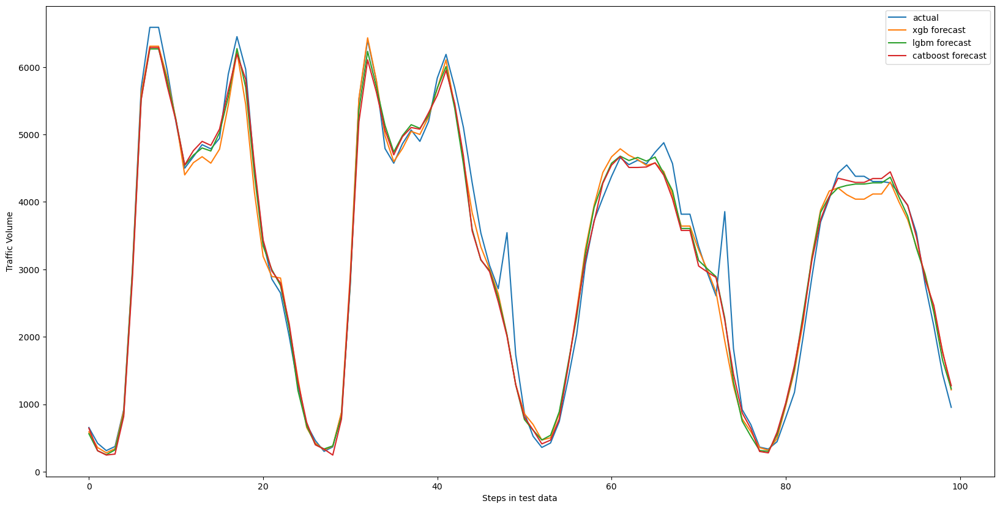

In [10]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))
plt.plot(list(y_test))
plt.plot(list(xgb_tuned_fcst))
plt.plot(list(lgbm_tuned_fcst))
plt.plot(list(catboost_tuned_fcst))
plt.legend(['actual', 'xgb forecast', 'lgbm forecast', 'catboost forecast'])
plt.ylabel('Traffic Volume')
plt.xlabel('Steps in test data')
plt.show()